# Link GitHub issues to CVE and CPEs

### install deps

In [2]:
!source .b2bvenv/bin/activate
%pip install -U pandas matplotlib numpy networkx

  Using cached pandas-2.2.3-cp311-cp311-macosx_10_9_x86_64.whl.metadata (89 kB)
  Using cached pytz-2024.2-py2.py3-none-any.whl.metadata (22 kB)
Using cached pandas-2.2.3-cp311-cp311-macosx_10_9_x86_64.whl (12.6 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 5.8 MB/s eta 0:00:00 MB/s eta 0:00:01:01
Using cached pytz-2024.2-py2.py3-none-any.whl (508 kB)
  Attempting uninstall: numpy
    Found existing installation: numpy 2.2.1
    Uninstalling numpy-2.2.1:
      Successfully uninstalled numpy-2.2.1
Note: you may need to restart the kernel to use updated packages.


In [ ]:
import csv

data_rows = []
with open("issues2cve.csv", "r", encoding="utf-8") as f:
    reader = csv.DictReader(f)
    for row in reader:
        cpe = row["CPE dependency name"]
        cve_str = row["CVE ID"]           # e.g. "CVE-2003-1564, CVE-2019-19956"
        severities_str = row["CVE severity"]  # e.g. "high, medium"
        ...
        # parse them into Python lists, etc.
        data_rows.append({
            "CPE": cpe,
            "cve_ids": cve_list,  # splitted
            "severities": severity_list, 
            "num_cves": int(row["Number of CVE ID occurrences"]),
            "num_issues": int(row["Number of Issues"]),
            "issues": issues_list,
        })


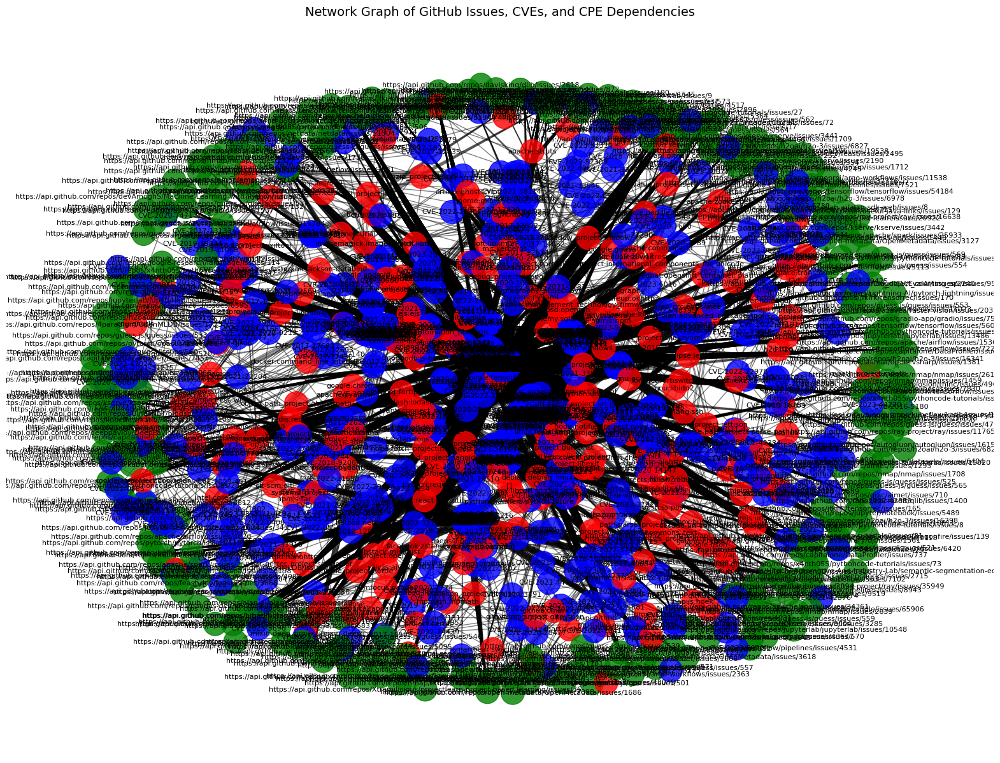

In [2]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the CSV data
file_path = "cpe_dependency_report_issue.csv"
data = pd.read_csv(file_path)

# Data cleaning and preparation
data['CVE ID'] = data['CVE ID'].str.split(', ')  # Split multiple CVEs into lists
data['CVE severity'] = data['CVE severity'].str.split(', ')  # Split multiple severities
data['Issues'] = data['Issues'].str.split(', ')  # Split multiple issues

# Initialize a directed graph
G = nx.DiGraph()

# Add nodes and edges to the graph
for _, row in data.iterrows():
    cpe_dependency = row['CPE dependency name']
    cve_ids = row['CVE ID']
    severities = row['CVE severity']
    issues = row['Issues']

    # Add the CPE dependency as a node
    G.add_node(cpe_dependency, type="CPE")

    # Add CVE nodes and link them to the CPE dependency
    if isinstance(cve_ids, list):
        for i, cve_id in enumerate(cve_ids):
            severity = severities[i] if i < len(severities) else "unknown"
            G.add_node(cve_id, type="CVE", severity=severity)
            G.add_edge(cpe_dependency, cve_id)

    # Add issue nodes and link them to the CVEs
    if isinstance(issues, list):
        for issue in issues:
            G.add_node(issue, type="Issue")
            for cve_id in cve_ids:
                G.add_edge(cve_id, issue)

# Visualize the graph
plt.figure(figsize=(20, 15))
pos = nx.spring_layout(G, k=0.15)  # Spring layout for better spacing

# Draw nodes with colors based on their type
node_colors = [
    'red' if G.nodes[node]['type'] == 'CPE' else
    'blue' if G.nodes[node]['type'] == 'CVE' else
    'green' for node in G.nodes()
]

nx.draw_networkx_nodes(G, pos, node_size=700, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, alpha=0.5)
nx.draw_networkx_labels(G, pos, font_size=8)

plt.title("Network Graph of GitHub Issues, CVEs, and CPE Dependencies", fontsize=14)
plt.axis("off")
plt.show()




In [3]:
# Analyze the graph
node_types = pd.Series(nx.get_node_attributes(G, 'type').values())
analysis = {
    'Total Nodes': G.number_of_nodes(),
    'Total Edges': G.number_of_edges(),
    'CPE Nodes': (node_types == 'CPE').sum(),
    'CVE Nodes': (node_types == 'CVE').sum(),
    'Issue Nodes': (node_types == 'Issue').sum(),
    'Top 5 High-Degree Nodes': sorted(G.degree, key=lambda x: x[1], reverse=True)[:5]
}
analysis

{'Total Nodes': 1374,
 'Total Edges': 11096,
 'CPE Nodes': np.int64(228),
 'CVE Nodes': np.int64(834),
 'Issue Nodes': np.int64(312),
 'Top 5 High-Degree Nodes': [('https://api.github.com/repos/x4nth055/pythoncode-tutorials/issues/17',
   221),
  ('https://api.github.com/repos/x4nth055/pythoncode-tutorials/issues/7', 221),
  ('https://api.github.com/repos/x4nth055/pythoncode-tutorials/issues/8', 221),
  ('https://api.github.com/repos/tf-encrypted/tf-encrypted/issues/744', 221),
  ('https://api.github.com/repos/x4nth055/pythoncode-tutorials/issues/6',
   221)]}

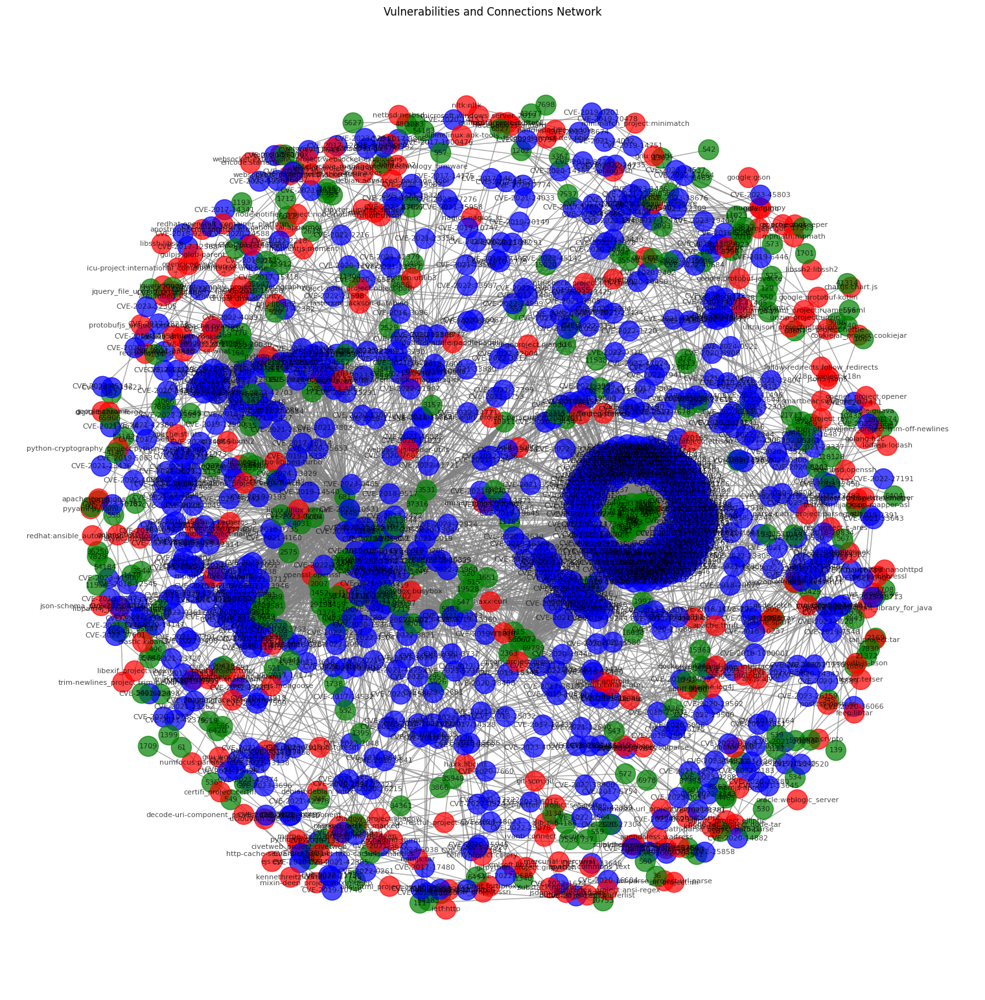

In [4]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the CSV file
file_path = 'cpe_dependency_report_issue.csv'
data = pd.read_csv(file_path)

# Rename columns for clarity
data.columns = ['CPE', 'CVE', 'CVE_Count', 'Severity', 'Issue_Count', 'Issues']

# Parse the CVEs and Issues into lists
data['CVE_List'] = data['CVE'].str.split(', ')
data['Issue_IDs'] = data['Issues'].str.extractall(r'issues/(\d+)').unstack().apply(lambda x: ', '.join(x.dropna()), axis=1)
data['Issue_IDs'] = data['Issue_IDs'].str.split(', ')

# Initialize graph
G = nx.Graph()

# Add nodes and edges
for _, row in data.iterrows():
    cpe = row['CPE']
    cves = row['CVE_List'] if row['CVE_List'] else []
    issues = row['Issue_IDs'] if isinstance(row['Issue_IDs'], list) else []

    # Add CPE node
    G.add_node(cpe, type='CPE')
    
    # Connect CPE to CVEs
    for cve in cves:
        G.add_node(cve, type='CVE')
        G.add_edge(cpe, cve)
    
    # Connect CVEs to Issues
    for cve in cves:
        for issue in issues:
            G.add_node(issue, type='Issue')
            G.add_edge(cve, issue)

# Draw graph with node colors based on type
node_colors = [
    'red' if G.nodes[node]['type'] == 'CPE' else
    'blue' if G.nodes[node]['type'] == 'CVE' else
    'green'
    for node in G.nodes
]

plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G, k=0.3)  # Force-directed layout
nx.draw(
    G, pos, with_labels=True, node_color=node_colors, font_size=8,
    node_size=500, edge_color='gray', alpha=0.7
)
plt.title("Vulnerabilities and Connections Network")
plt.show()


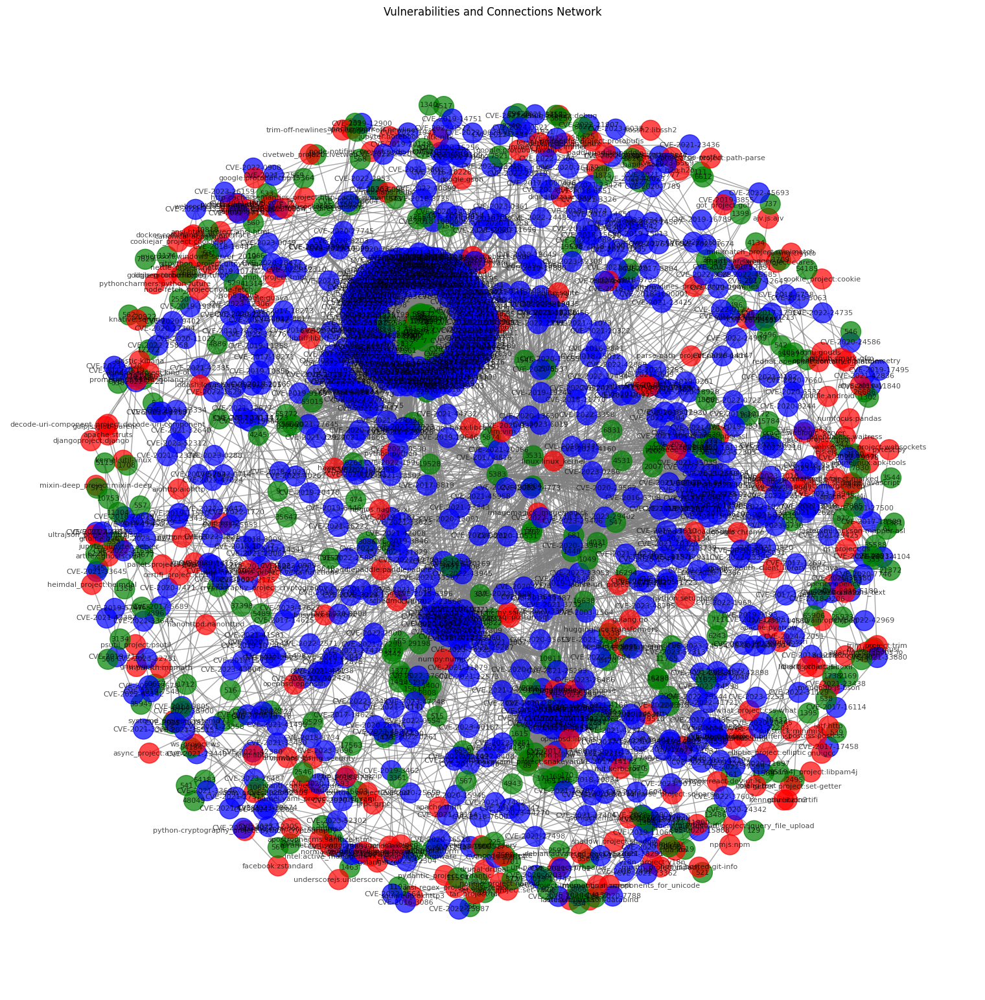

In [5]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the CSV file
file_path = 'cpe_dependency_report_issue.csv'
data = pd.read_csv(file_path)

# Rename columns for clarity
data.columns = ['CPE', 'CVE', 'CVE_Count', 'Severity', 'Issue_Count', 'Issues']

# Parse the CVEs and Issues into lists
data['CVE_List'] = data['CVE'].str.split(', ')
data['Issue_IDs'] = data['Issues'].str.extractall(r'issues/(\d+)').unstack().apply(lambda x: ', '.join(x.dropna()), axis=1)
data['Issue_IDs'] = data['Issue_IDs'].str.split(', ')

# Initialize graph
G = nx.Graph()

# Add nodes and edges
for _, row in data.iterrows():
    cpe = row['CPE']
    cves = row['CVE_List'] if row['CVE_List'] else []
    issues = row['Issue_IDs'] if isinstance(row['Issue_IDs'], list) else []

    # Add CPE node
    G.add_node(cpe, type='CPE')
    
    # Connect CPE to CVEs
    for cve in cves:
        G.add_node(cve, type='CVE')
        G.add_edge(cpe, cve)
    
    # Connect CVEs to Issues
    for cve in cves:
        for issue in issues:
            G.add_node(issue, type='Issue')
            G.add_edge(cve, issue)

# Draw graph with node colors based on type
node_colors = [
    'red' if G.nodes[node]['type'] == 'CPE' else
    'blue' if G.nodes[node]['type'] == 'CVE' else
    'green'
    for node in G.nodes
]

plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G, k=0.3)  # Force-directed layout
nx.draw(
    G, pos, with_labels=True, node_color=node_colors, font_size=8,
    node_size=500, edge_color='gray', alpha=0.7
)
plt.title("Vulnerabilities and Connections Network")
plt.show()


In [10]:
# # Adjusting the layout to align blue, red, and green nodes vertically while showing relationships horizontally

# import matplotlib.pyplot as plt
# import networkx as nx

# # Creating the graph from the previously processed data (reuse acronyms and relationship)
# G_vertical = nx.DiGraph()
# # Add nodes and edges (reusing the same structure as earlier but adjusting the layout visually)
# # Assuming nodes_dict and relationships as earlier

# for node, attr in nodes_dict.items():
#     G_vertical.add_node(node, **attr)

# for src, dst, edge_attr in relationships:
#     G_vertical.add_edge(src, dst, **edge_attr)

# # Generate positions: Blue, Red, Green are aligned vertically, relationships are horizontal
# pos_vertical = {}
# blue_nodes = [node for node, attr in G_vertical.nodes(data=True) if attr['color'] == 'blue']
# red_nodes = [node for node, attr in G_vertical.nodes(data=True) if attr['color'] == 'red']
# green_nodes = [node for node, attr in G_vertical.nodes(data=True) if attr['color'] == 'green']

# # Assign positions for vertical alignment
# x_offset = 0  # Starting x position for categories
# for idx, node in enumerate(blue_nodes):
#     pos_vertical[node] = (x_offset, -idx)

# x_offset += 1  # Move to next category
# for idx, node in enumerate(red_nodes):
#     pos_vertical[node] = (x_offset, -idx)

# x_offset += 1  # Move to next category
# for idx, node in enumerate(green_nodes):
#     pos_vertical[node] = (x_offset, -idx)

# # Place other nodes based on their connections (spreading horizontally)
# for node in G_vertical.nodes():
#     if node not in pos_vertical:
#         connected_nodes = list(G_vertical[node])
#         if connected_nodes:
#             avg_x = sum(pos_vertical[cn][0] for cn in connected_nodes) / len(connected_nodes)
#             pos_vertical[node] = (avg_x, pos_vertical[connected_nodes[0]][1] - 1)
#         else:
#             pos_vertical[node] = (x_offset + 1, 0)  # Default placement

# # Plot the graph with adjusted layout
# plt.figure(figsize=(12, 12))
# nx.draw(
#     G_vertical,
#     pos=pos_vertical,
#     with_labels=True,
#     node_size=3000,
#     node_color=[attr['color'] for node, attr in G_vertical.nodes(data=True)],
#     font_size=8,
#     font_color="white",
#     edge_color="gray",
#     arrowsize=10
# )

# # Add legend
# legend_elements = [
#     plt.Line2D([0], [0], marker='o', color='w', label='Blue (CPEs)', markersize=10, markerfacecolor='blue'),
#     plt.Line2D([0], [0], marker='o', color='w', label='Red (CVEs)', markersize=10, markerfacecolor='red'),
#     plt.Line2D([0], [0], marker='o', color='w', label='Green (Issues)', markersize=10, markerfacecolor='green')
# ]
# plt.legend(handles=legend_elements, loc="best", fontsize=10, title="Legend")

# plt.title("Vertical Alignment of Categories with Relationships", fontsize=14)
# plt.show()


In [3]:
# import pandas as pd
# import networkx as nx
# import matplotlib.pyplot as plt

# # Load the dataset to extract relevant information
# file_path = 'cpe_dependency_report_issue.csv'
# data = pd.read_csv(file_path)

# # Extract relevant columns for processing
# data = data[['CPE dependency name', 'CVE ID', 'CVE severity', 'Issues']]

# # Cleaning and preparing data for visualization
# data = data.dropna()  # Drop rows with missing data
# data['CVE ID'] = data['CVE ID'].apply(lambda x: x.split(', '))  # Split CVE IDs into lists
# data['CVE severity'] = data['CVE severity'].apply(lambda x: x.split(', '))  # Split severities into lists
# data['Issues'] = data['Issues'].apply(lambda x: x.split(', '))  # Split issues into lists

# # Create a graph with relationships
# G = nx.DiGraph()

# # Adding nodes and edges
# for _, row in data.iterrows():
#     cpe = row['CPE dependency name']
#     for cve, severity, issue in zip(row['CVE ID'], row['CVE severity'], row['Issues']):
#         G.add_node(cpe, color='blue', type='CPE')  # Add CPE as blue nodes
#         G.add_node(cve, color='red', type='CVE')  # Add CVE as red nodes
#         G.add_node(issue, color='green', type='Issue')  # Add issues as green nodes
#         G.add_edge(cpe, cve)  # CPE to CVE relationship
#         G.add_edge(cve, issue)  # CVE to Issue relationship

# # Extract positions for vertical layout
# pos = {}
# y_position = {'CPE': 0, 'CVE': 1, 'Issue': 2}
# x_counter = {'CPE': 0, 'CVE': 0, 'Issue': 0}
# for node, attr in G.nodes(data=True):
#     node_type = attr['type']
#     pos[node] = (x_counter[node_type], y_position[node_type])
#     x_counter[node_type] += 1

# # Draw the graph with a vertical layout
# node_colors = [attr['color'] for _, attr in G.nodes(data=True)]
# plt.figure(figsize=(12, 8))
# nx.draw(G, pos, with_labels=True, node_color=node_colors, font_size=8, node_size=700)

# # Adding legend
# blue_patch = plt.Line2D([0], [0], marker='o', color='w', label='CPE (Blue)', markerfacecolor='blue', markersize=10)
# red_patch = plt.Line2D([0], [0], marker='o', color='w', label='CVE (Red)', markerfacecolor='red', markersize=10)
# green_patch = plt.Line2D([0], [0], marker='o', color='w', label='Issue (Green)', markerfacecolor='green', markersize=10)
# plt.legend(handles=[blue_patch, red_patch, green_patch], loc='best')

# # Display the graph
# plt.title("CPE-CVE-Issue Relationships")
# plt.show()


In [13]:
# import pandas as pd
# import networkx as nx
# import matplotlib.pyplot as plt

# # Load the data
# file_path = 'cpe_dependency_report_issue.csv'
# data = pd.read_csv(file_path)

# # Extract necessary columns
# columns_to_keep = ['CPE dependency name', 'CVE ID', 'Number of CVE ID occurrences', 
#                    'CVE severity', 'Number of Issues', 'Issues']
# data = data[columns_to_keep]

# # Preprocess data for visualization
# data['Issues'] = data['Issues'].str.split(', ')
# data['CVE ID'] = data['CVE ID'].str.split(', ')
# data = data.explode('Issues').explode('CVE ID')

# # Shorten issue and CVE references
# data['Issues'] = data['Issues'].str.split('/').str[-1]
# data['CVE ID'] = data['CVE ID'].str.strip()

# # Build the graph
# G = nx.Graph()

# # Add nodes and edges
# for _, row in data.iterrows():
#     dep = row['CPE dependency name']
#     cve = row['CVE ID']
#     sev = row['CVE severity']
#     issue = row['Issues']

#     G.add_node(dep, type='dependency')
#     G.add_node(cve, type='cve', severity=sev)
#     G.add_node(issue, type='issue')
    
#     G.add_edge(dep, cve, relationship='affects')
#     G.add_edge(cve, issue, relationship='reported_in')

# # Create a layout for the graph
# pos = nx.spring_layout(G, seed=42)

# # Draw the graph
# plt.figure(figsize=(20, 15))

# # Draw nodes with different colors based on type
# node_colors = [
#     'skyblue' if G.nodes[node]['type'] == 'dependency' else 
#     'orange' if G.nodes[node]['type'] == 'cve' else 'lightgreen'
#     for node in G.nodes
# ]
# nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=500)

# # Draw edges
# nx.draw_networkx_edges(G, pos, alpha=0.5)

# # Draw labels
# labels = {node: node for node in G.nodes}
# nx.draw_networkx_labels(G, pos, labels, font_size=10)

# plt.title("Network Graph of Dependencies, CVEs, and Issues")
# plt.axis('off')
# plt.show()


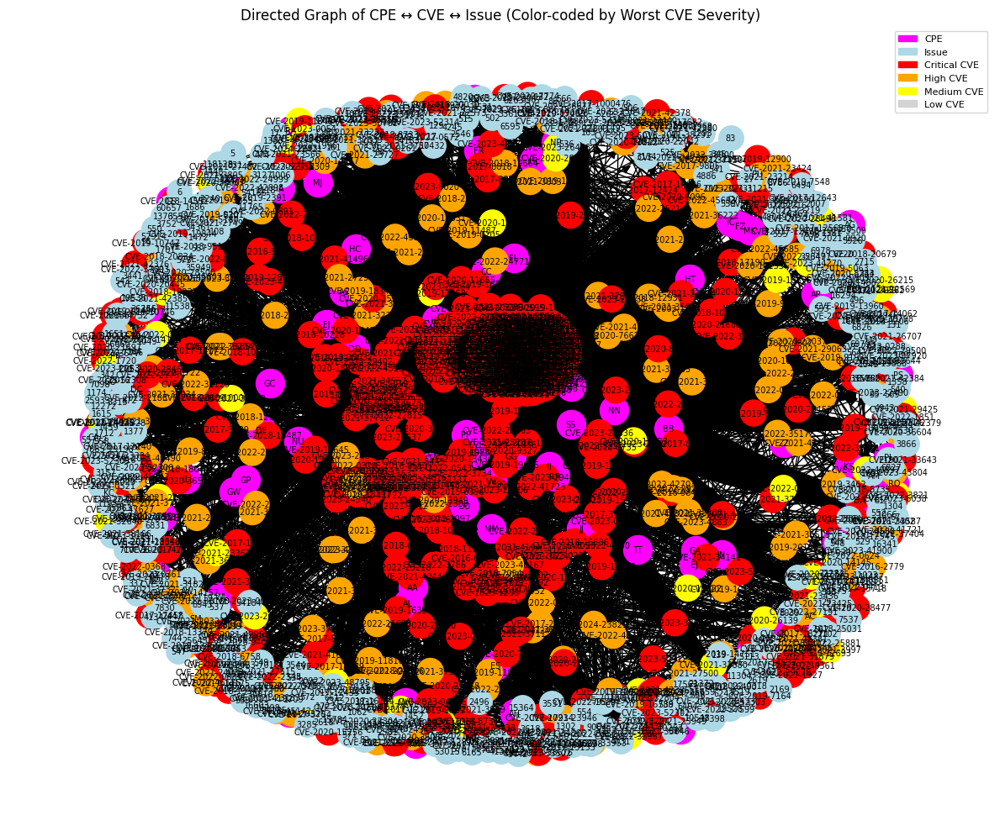

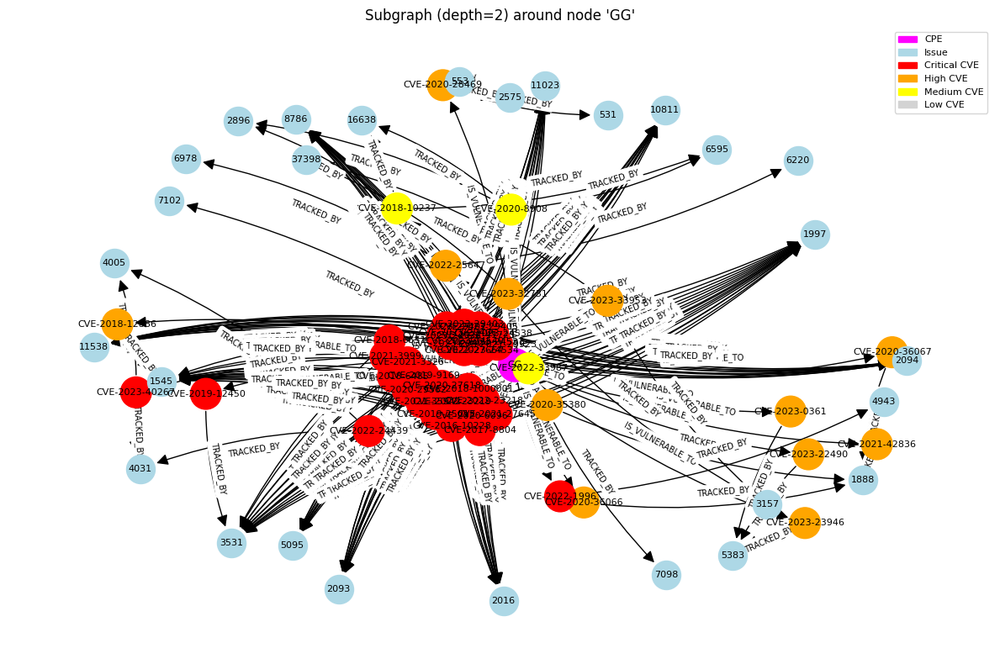

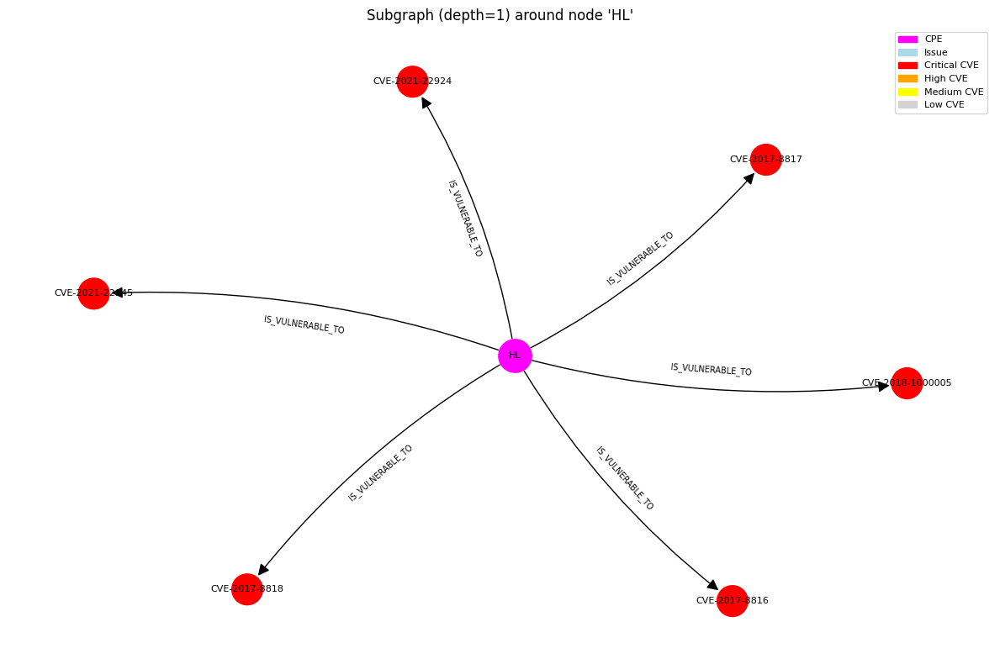

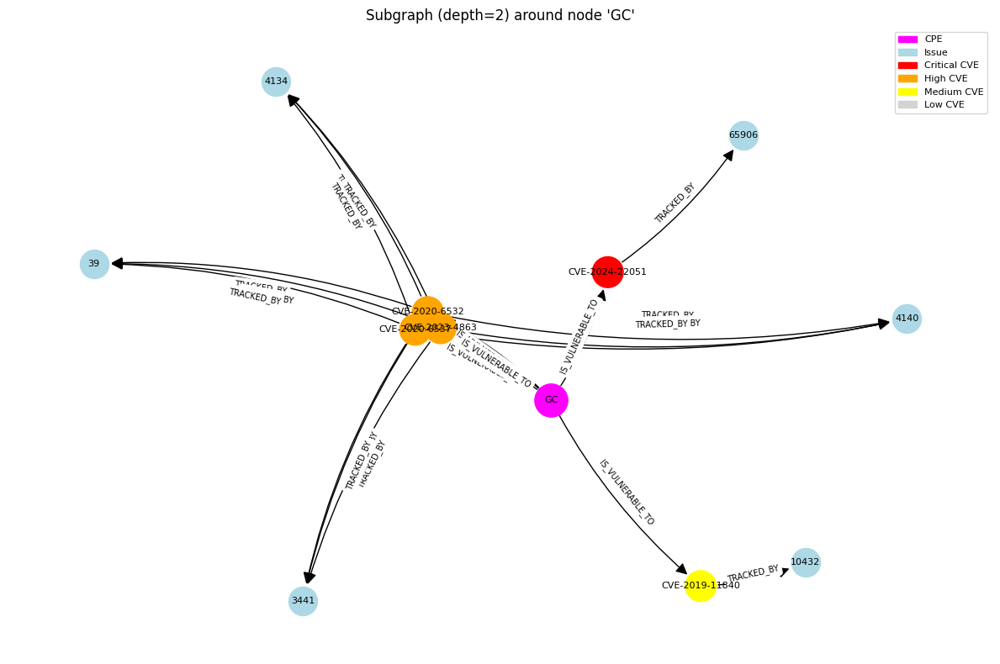

In [13]:
"""
Build a directed NetworkX graph from a CSV of vulnerabilities
demonstrating all relationship directions between CPE, CVE, and Issue,
and color-coding CVE nodes by severity.
"""

import csv
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from collections import deque

###############################################################################
# HELPER FUNCTIONS FOR SEVERITY COLORING
###############################################################################

def worst_severity(sev_list):
    """
    Given a list of severities (like ['critical','high','medium']),
    return the single worst severity: 'critical' > 'high' > 'medium' > 'low'.
    """
    rank = {'critical':4, 'high':3, 'medium':2, 'low':1}
    worst = 'none'
    worst_val = 0
    for s in sev_list:
        val = rank.get(s.lower(), 0)  # 0 if not recognized
        if val > worst_val:
            worst_val = val
            worst = s.lower()
    return worst

def color_for_severity(severity):
    """
    Map severity string to a specific color.
    """
    severity = severity.lower()
    if severity == "critical":
        return "red"
    elif severity == "high":
        return "orange"
    elif severity == "medium":
        return "yellow"
    elif severity == "low":
        return "lightgray"
    else:
        # for unknown or empty severities
        return "white"

###############################################################################
# BUILD THE GRAPH FROM CSV
###############################################################################

def build_directed_graph_from_csv(csv_path):
    """
    Reads the CSV file and constructs a DiGraph where:
    - Each CPE is a node (node_type="CPE")
    - Each CVE is a node (node_type="CVE")
    - Each Issue is a node (node_type="Issue")

    Edges (two-way) for "all" relationships:
    - CPE -> CVE, labeled 'IS_VULNERABLE_TO'
    - CVE -> CPE, labeled 'AFFECTS'
    - CVE -> Issue, labeled 'TRACKED_BY'
    - Issue -> CVE, labeled 'REFERENCES'
    """
    G = nx.DiGraph()

    with open(csv_path, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        for row in reader:
            # Extract fields from CSV row
            cpe_name = row["CPE dependency name"].strip()
            cve_ids_str = row["CVE ID"].strip()
            issues_str = row["Issues"].strip()

            cve_ids = [c.strip() for c in cve_ids_str.split(",") if c.strip()]
            issues_list = [i.strip() for i in issues_str.split(",") if i.strip()]

            # Parse severity (can be multiple, e.g. "critical, high")
            severity_str = row["CVE severity"].strip().lower()
            severity_list = [s.strip() for s in severity_str.split(",") if s.strip()]

            # We'll store # of CVE occurrences, # of Issues, etc. if you need them
            occurrences = row["Number of CVE ID occurrences"].strip()
            num_issues = row["Number of Issues"].strip()

            # --- Add CPE node ---
            if not G.has_node(cpe_name):
                G.add_node(cpe_name, node_type="CPE")

            # For each CVE in this row
            for cve in cve_ids:
                if not G.has_node(cve):
                    # The node will store the entire severity_list, but we can
                    # pick the "worst" when we color it.
                    G.add_node(
                        cve,
                        node_type="CVE",
                        severity=severity_list,   # store all severities
                        occurrences=occurrences
                    )

                # Add directed edges in both directions (per docstring):
                # CPE -> CVE
                if not G.has_edge(cpe_name, cve):
                    G.add_edge(cpe_name, cve, relation="IS_VULNERABLE_TO")

                # # CVE -> CPE
                # if not G.has_edge(cve, cpe_name):
                #     G.add_edge(cve, cpe_name, relation="AFFECTS")

                # Link each CVE to Issues
                for issue in issues_list:
                    if not G.has_node(issue):
                        G.add_node(issue, node_type="Issue")

                    # CVE -> Issue
                    if not G.has_edge(cve, issue):
                        G.add_edge(cve, issue, relation="TRACKED_BY")

                    # # Issue -> CVE
                    # if not G.has_edge(issue, cve):
                    #     G.add_edge(issue, cve, relation="REFERENCES")

    return G

###############################################################################
# DRAW THE ENTIRE GRAPH
###############################################################################

def draw_entire_graph(G):
    """
    Draws the entire directed graph:
      - CPE nodes in red
      - CVE nodes color-coded by "worst" severity
      - Issue nodes in lightblue
    """

    plt.figure(figsize=(12, 10))
    pos = nx.spring_layout(G, k=0.5, seed=42)

    # We'll separate nodes by type
    cpe_nodes   = [n for n, d in G.nodes(data=True) if d["node_type"] == "CPE"]
    cve_nodes   = [n for n, d in G.nodes(data=True) if d["node_type"] == "CVE"]
    issue_nodes = [n for n, d in G.nodes(data=True) if d["node_type"] == "Issue"]

    # Draw CPE nodes (red)
    nx.draw_networkx_nodes(G, pos,
                           nodelist=cpe_nodes,
                           node_color="magenta",
                           node_size=600)

    # Draw CVE nodes (color-coded by worst severity)
    cve_colors = []
    for node in cve_nodes:
        # we stored a list of severities in G.nodes[node]["severity"]
        sev_list = G.nodes[node].get("severity", [])
        worst = worst_severity(sev_list)
        cve_colors.append(color_for_severity(worst))

    nx.draw_networkx_nodes(G, pos,
                           nodelist=cve_nodes,
                           node_color=cve_colors,
                           node_size=500)

    # Draw Issue nodes (lightblue)
    nx.draw_networkx_nodes(G, pos,
                           nodelist=issue_nodes,
                           node_color="lightblue",
                           node_size=450)

    # Now draw edges with arrows
    nx.draw_networkx_edges(
        G,
        pos,
        arrows=True,
        arrowstyle="-|>",
        arrowsize=15,
        min_source_margin=15,
        min_target_margin=15,
        connectionstyle='arc3,rad=0.1'
    )

    # Label the nodes with their name
    nx.draw_networkx_labels(G, pos, font_size=7)

    # Optionally label edges
    # edge_labels = nx.get_edge_attributes(G, 'relation')
    # nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=6)

    # Make a legend with node type + severity meaning
    red_patch     = mpatches.Patch(color='magenta', label='CPE')
    lightblue_patch = mpatches.Patch(color='lightblue', label='Issue')
    critical_patch  = mpatches.Patch(color='red',     label='Critical CVE')   # same as "red" but you'd usually pick a slightly different shade
    high_patch      = mpatches.Patch(color='orange',  label='High CVE')
    medium_patch    = mpatches.Patch(color='yellow',  label='Medium CVE')
    low_patch       = mpatches.Patch(color='lightgray', label='Low CVE')
    plt.legend(handles=[red_patch, lightblue_patch, critical_patch, high_patch, medium_patch, low_patch],
               loc='best', fontsize=8)

    plt.title("Directed Graph of CPE ↔ CVE ↔ Issue (Color-coded by Worst CVE Severity)")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

###############################################################################
# DRAW SUBGRAPH AROUND A NODE
###############################################################################

def draw_subgraph_around_node(G, center_node, depth=2):
    """
    Extracts a small directed subgraph of BFS depth `depth` around `center_node`
    to keep visualization less cluttered, then draws it with severity colors.
    """
    if center_node not in G:
        print(f"Node '{center_node}' not found in graph.")
        return

    visited = set()
    sub_nodes = set()
    queue = deque([(center_node, 0)])
    
    while queue:
        node, dist = queue.popleft()
        if node in visited or dist > depth:
            continue
        visited.add(node)
        sub_nodes.add(node)

        # Add successors and predecessors for a bidirectional neighborhood
        for successor in G.successors(node):
            if successor not in visited:
                queue.append((successor, dist + 1))
        for predecessor in G.predecessors(node):
            if predecessor not in visited:
                queue.append((predecessor, dist + 1))

    # Now sub_nodes has the BFS neighborhood
    H = G.subgraph(sub_nodes).copy()

    plt.figure(figsize=(12, 8))
    pos = nx.spring_layout(H, k=0.5, seed=42, scale=2)

    # Separate node types
    cpe_nodes   = [n for n, d in H.nodes(data=True) if d["node_type"] == "CPE"]
    cve_nodes   = [n for n, d in H.nodes(data=True) if d["node_type"] == "CVE"]
    issue_nodes = [n for n, d in H.nodes(data=True) if d["node_type"] == "Issue"]

    # Color arrays
    cpe_color = "magenta"
    issue_color = "lightblue"

    cve_colors = []
    for node in cve_nodes:
        sev_list = H.nodes[node].get("severity", [])
        worst_s  = worst_severity(sev_list)
        cve_colors.append(color_for_severity(worst_s))

    # Draw nodes
    nx.draw_networkx_nodes(H, pos,
                           nodelist=cpe_nodes,
                           node_color=cpe_color,
                           node_size=800)
    nx.draw_networkx_nodes(H, pos,
                           nodelist=cve_nodes,
                           node_color=cve_colors,
                           node_size=700)
    nx.draw_networkx_nodes(H, pos,
                           nodelist=issue_nodes,
                           node_color=issue_color,
                           node_size=600)

    nx.draw_networkx_labels(H, pos, font_size=8)

    # Draw edges
    nx.draw_networkx_edges(
        H,
        pos,
        arrows=True,
        arrowstyle="-|>",
        arrowsize=20,
        min_source_margin=15,
        min_target_margin=15,
        connectionstyle='arc3,rad=0.1'
    )

    # Show relation labels on edges if desired
    edge_labels = nx.get_edge_attributes(H, "relation")
    nx.draw_networkx_edge_labels(H, pos, edge_labels=edge_labels, font_size=7)

    # Legend
    red_patch    = mpatches.Patch(color='magenta', label='CPE')
    lightblue_patch = mpatches.Patch(color='lightblue', label='Issue')
    critical_patch  = mpatches.Patch(color='red',     label='Critical CVE')
    high_patch      = mpatches.Patch(color='orange',  label='High CVE')
    medium_patch    = mpatches.Patch(color='yellow',  label='Medium CVE')
    low_patch       = mpatches.Patch(color='lightgray', label='Low CVE')

    plt.legend(handles=[red_patch, lightblue_patch, critical_patch, high_patch,
                        medium_patch, low_patch],
               loc='best', fontsize=8)

    plt.title(f"Subgraph (depth={depth}) around node '{center_node}'")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

###############################################################################
# MAIN
###############################################################################

def main():
    # Path to your CSV file:
    csv_file = "./github-data/issues2cve.csv"

    # Build the directed graph from CSV
    directed_graph = build_directed_graph_from_csv(csv_file)

    # Draw the entire graph
    draw_entire_graph(directed_graph)

    # Draw some subgraphs if needed
    draw_subgraph_around_node(directed_graph, center_node="GG", depth=2)
    draw_subgraph_around_node(directed_graph, center_node="HL", depth=1)
    draw_subgraph_around_node(directed_graph, center_node="GC", depth=2)

if __name__ == "__main__":
    main()


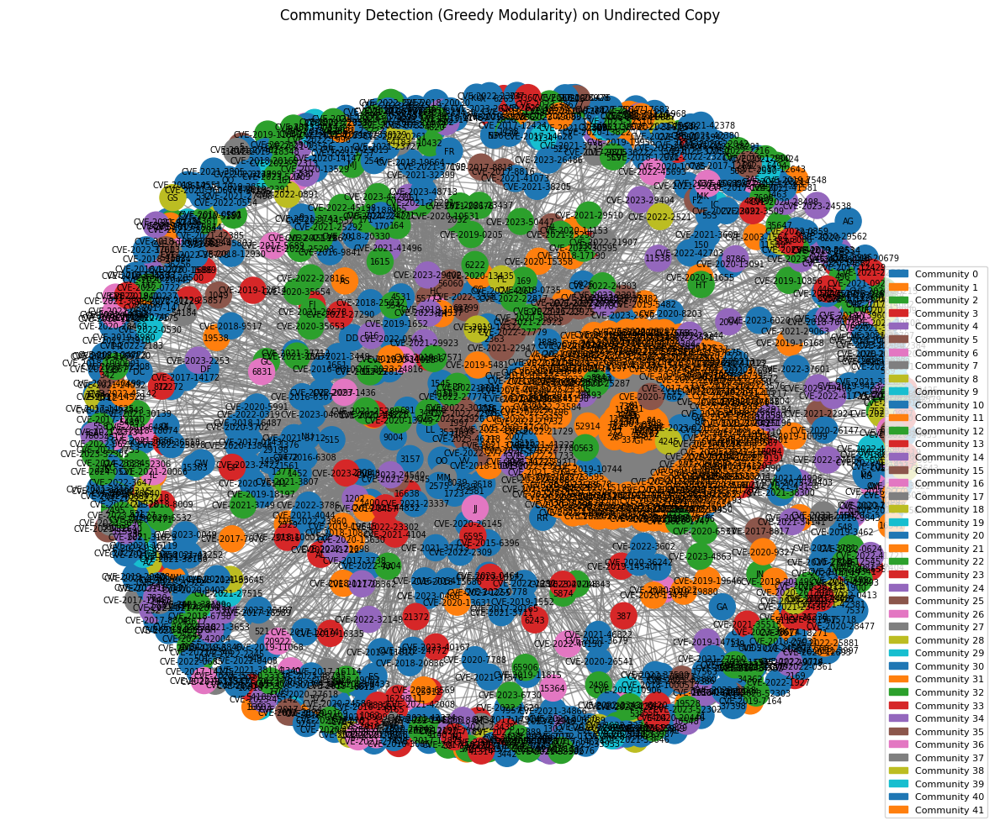

In [14]:
#!/usr/bin/env python3

import csv
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from collections import deque
from networkx.algorithms import community  # for greedy_modularity_communities

###############################################################################
# HELPER FUNCTIONS FOR SEVERITY COLORING (same as before)
###############################################################################

def worst_severity(sev_list):
    rank = {'critical':4, 'high':3, 'medium':2, 'low':1}
    worst = 'none'
    best_val = 0
    for s in sev_list:
        val = rank.get(s.lower(), 0)
        if val > best_val:
            best_val = val
            worst = s.lower()
    return worst

def color_for_severity(severity):
    severity = severity.lower()
    if severity == "critical":
        return "red"
    elif severity == "high":
        return "orange"
    elif severity == "medium":
        return "yellow"
    elif severity == "low":
        return "lightgray"
    else:
        return "white"

###############################################################################
# BUILD THE DIRECTED GRAPH FROM CSV
###############################################################################

def build_directed_graph_from_csv(csv_path):
    G = nx.DiGraph()
    with open(csv_path, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        for row in reader:
            cpe_name = row["CPE dependency name"].strip()
            cve_ids_str = row["CVE ID"].strip()
            issues_str = row["Issues"].strip()

            cve_ids = [c.strip() for c in cve_ids_str.split(",") if c.strip()]
            issues_list = [i.strip() for i in issues_str.split(",") if i.strip()]

            severity_str = row["CVE severity"].strip().lower()
            severity_list = [s.strip() for s in severity_str.split(",") if s.strip()]

            occurrences = row["Number of CVE ID occurrences"].strip()
            num_issues = row["Number of Issues"].strip()

            if not G.has_node(cpe_name):
                G.add_node(cpe_name, node_type="CPE")

            for cve in cve_ids:
                if not G.has_node(cve):
                    G.add_node(cve, node_type="CVE", severity=severity_list)

                # CPE -> CVE
                if not G.has_edge(cpe_name, cve):
                    G.add_edge(cpe_name, cve, relation="IS_VULNERABLE_TO")
                # CVE -> CPE
                if not G.has_edge(cve, cpe_name):
                    G.add_edge(cve, cpe_name, relation="AFFECTS")

                for issue in issues_list:
                    if not G.has_node(issue):
                        G.add_node(issue, node_type="Issue")
                    # CVE -> Issue
                    if not G.has_edge(cve, issue):
                        G.add_edge(cve, issue, relation="TRACKED_BY")
                    # Issue -> CVE
                    if not G.has_edge(issue, cve):
                        G.add_edge(issue, cve, relation="REFERENCES")

    return G

###############################################################################
# COMMUNITY DETECTION (Ignoring Direction)
###############################################################################

def detect_and_draw_communities(G):
    """
    Convert G to an undirected graph and run a community detection algorithm.
    Then draw the graph, coloring each community differently.
    """
    # Convert to undirected for community detection
    H = G.to_undirected()

    # Use the built-in "greedy_modularity_communities" approach
    # This returns a list of sets, each set is a cluster of node names
    communities = community.greedy_modularity_communities(H)

    # We can assign a "community index" to each node
    node_community = {}
    for idx, comm_set in enumerate(communities):
        for node in comm_set:
            node_community[node] = idx

    # We'll pick color from a palette (here, a few bright colors)
    color_palette = [
        "#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd",
        "#8c564b", "#e377c2", "#7f7f7f", "#bcbd22", "#17becf"
    ]
    # If more communities than palette, we just reuse or extend dynamically
    max_community_idx = max(node_community.values()) if node_community else 0

    # Build a color list for each node in G
    node_colors = []
    for node in G.nodes():
        c_idx = node_community.get(node, 0) % len(color_palette)
        node_colors.append(color_palette[c_idx])

    # Layout and draw
    plt.figure(figsize=(12, 10))
    pos = nx.spring_layout(H, k=0.5, seed=42)

    # Draw nodes with assigned color
    nx.draw_networkx_nodes(H, pos, node_color=node_colors, node_size=500)

    # For edges, we can still show them in a neutral color
    nx.draw_networkx_edges(H, pos, edge_color="gray", alpha=0.7)

    # Node labels
    nx.draw_networkx_labels(H, pos, font_size=7)

    plt.title("Community Detection (Greedy Modularity) on Undirected Copy")
    plt.axis("off")
    plt.tight_layout()

    # Make a legend with community index → color
    # We'll label each community by its index
    patches = []
    for idx in range(max_community_idx + 1):
        col = color_palette[idx % len(color_palette)]
        patches.append(mpatches.Patch(color=col, label=f"Community {idx}"))
    plt.legend(handles=patches, loc="best", fontsize=8)

    plt.show()

###############################################################################
# MAIN
###############################################################################

def main():
    csv_file = "./github-data/issues2cve.csv"

    # 1) Build the *directed* graph
    directed_graph = build_directed_graph_from_csv(csv_file)

    # 2) Show communities by ignoring direction
    detect_and_draw_communities(directed_graph)

if __name__ == "__main__":
    main()


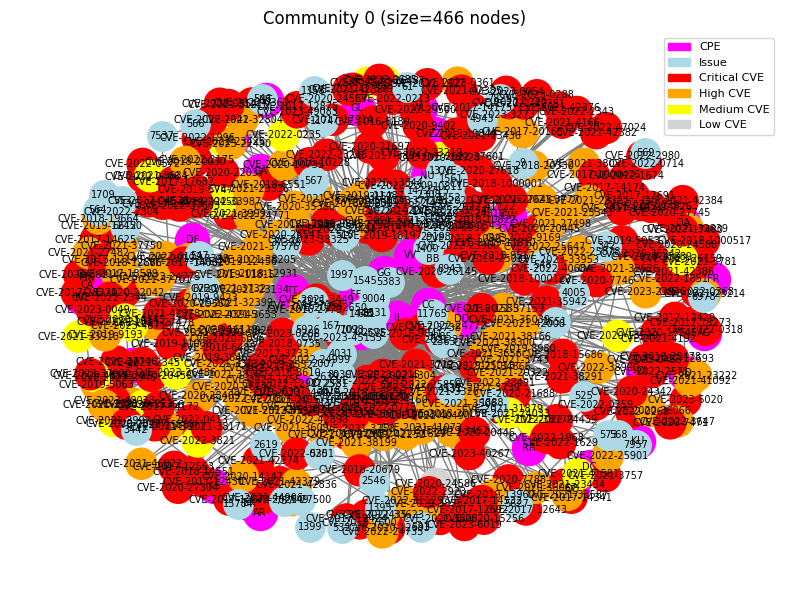

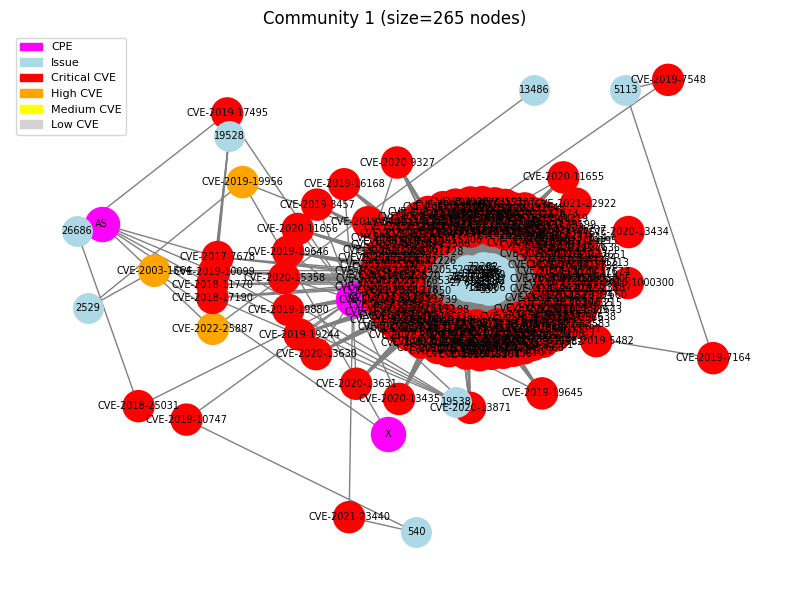

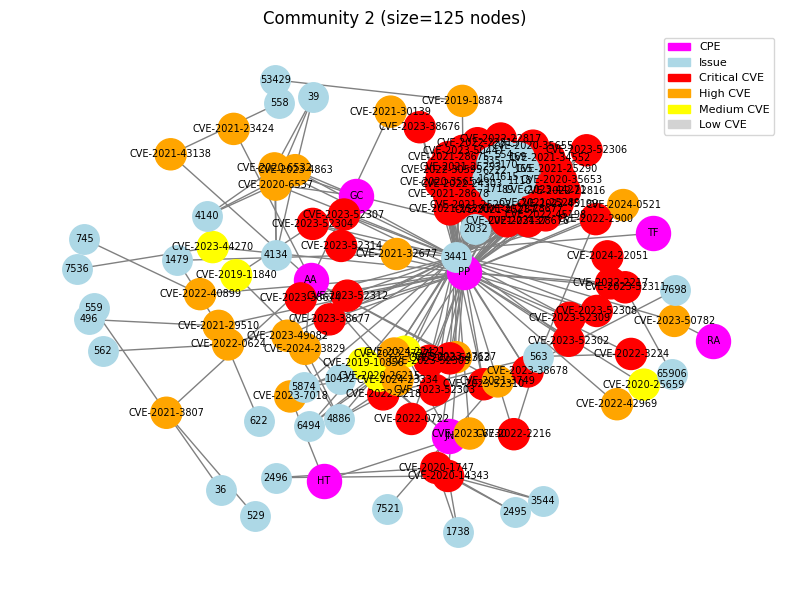

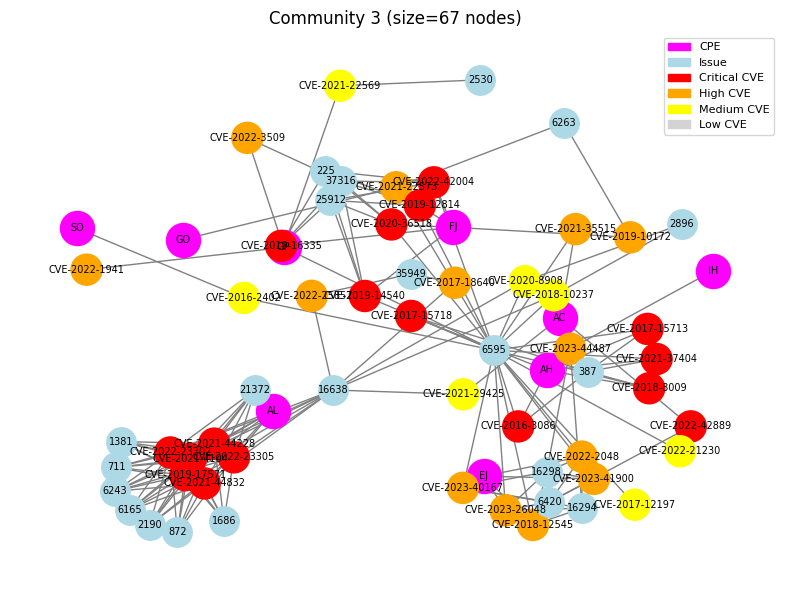

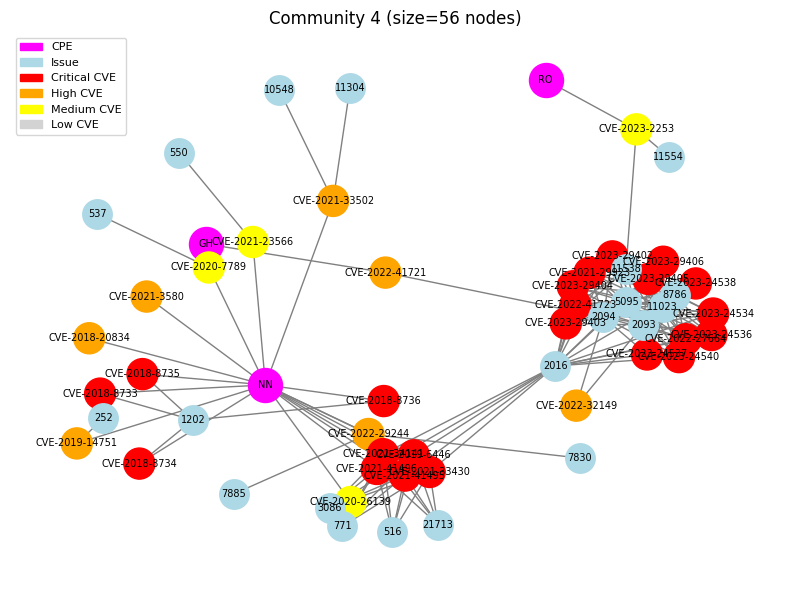

...

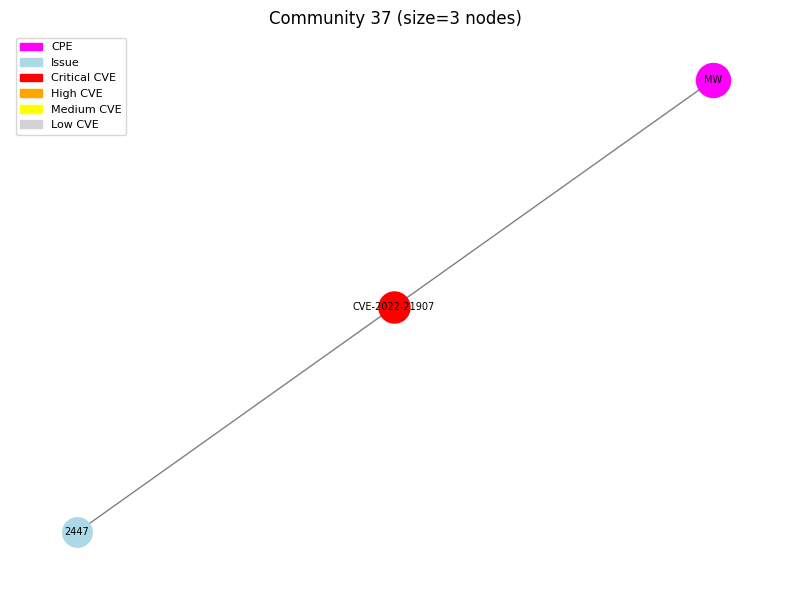

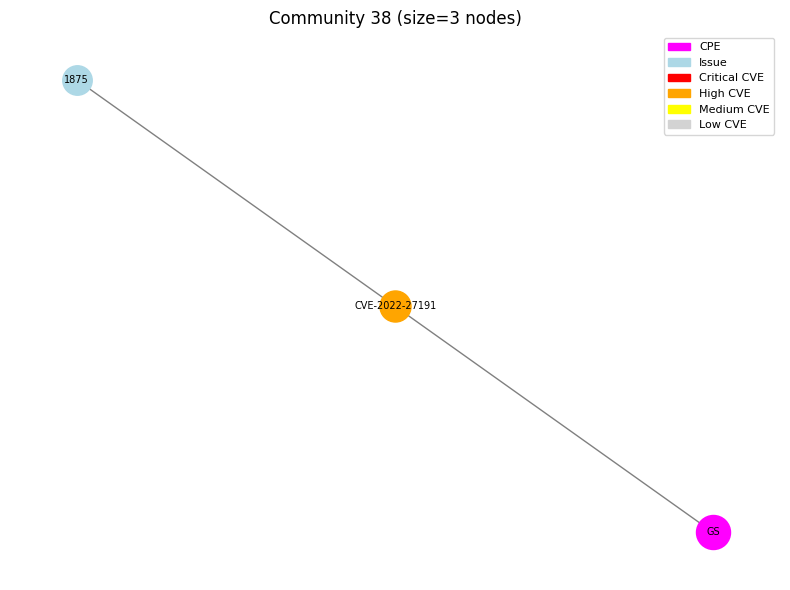

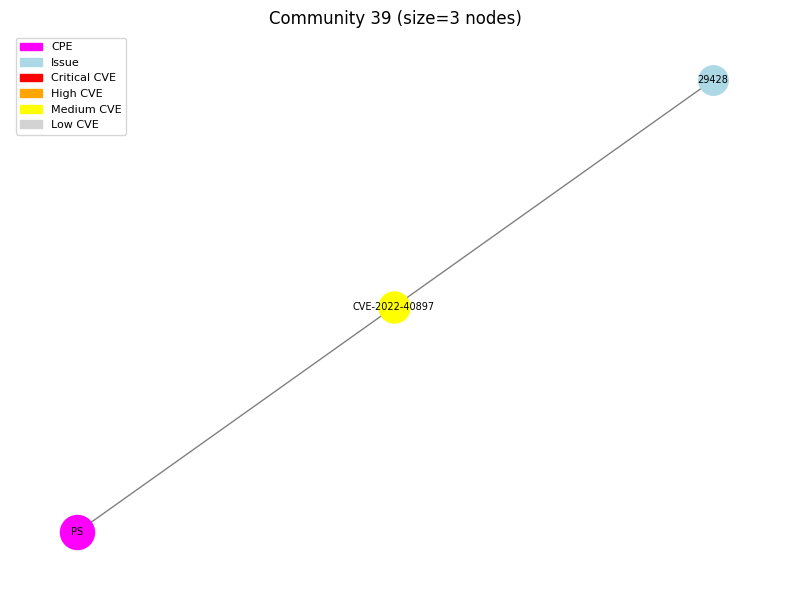

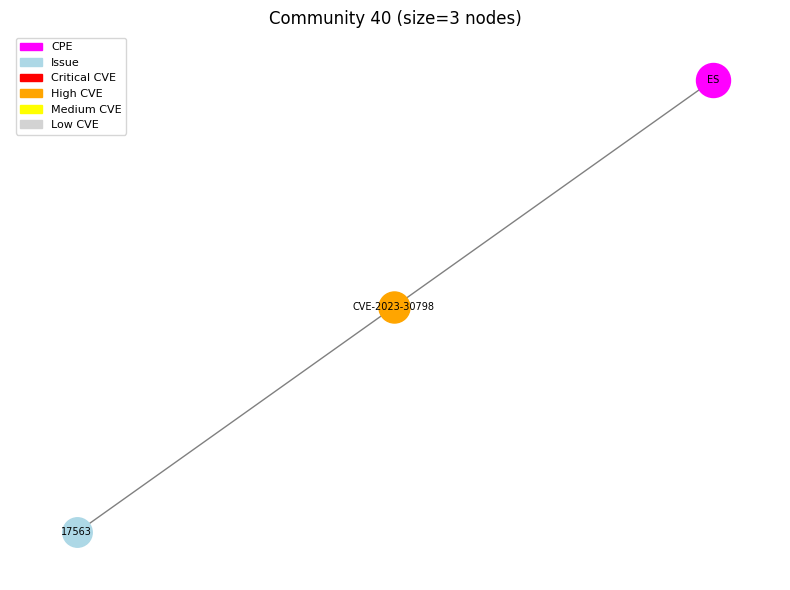

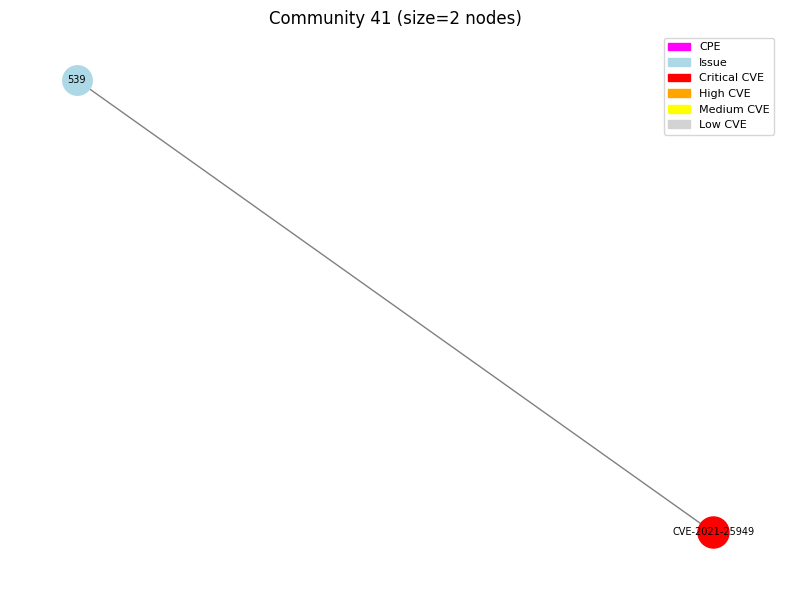

In [16]:
#!/usr/bin/env python3

import csv
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from collections import deque
from networkx.algorithms import community  # for greedy_modularity_communities

###############################################################################
# HELPER FUNCTIONS FOR SEVERITY
###############################################################################

def worst_severity(sev_list):
    """
    Return the single "worst" severity from a list like ["critical","high","medium"].
    We'll define critical > high > medium > low.
    """
    rank = {"critical":4, "high":3, "medium":2, "low":1}
    worst = "none"
    best_val = 0
    for s in sev_list:
        val = rank.get(s.lower(), 0)
        if val > best_val:
            best_val = val
            worst = s.lower()
    return worst

def color_for_severity(severity):
    """
    Map severity string to a color.
    """
    severity = severity.lower()
    if severity == "critical":
        return "red"
    elif severity == "high":
        return "orange"
    elif severity == "medium":
        return "yellow"
    elif severity == "low":
        return "lightgray"
    else:
        return "lavender"

###############################################################################
# BUILD THE DIRECTED GRAPH FROM CSV (SAME AS BEFORE)
###############################################################################

def build_directed_graph_from_csv(csv_path):
    """
    Reads CSV. Each row has:
      - CPE dependency name
      - CVE ID
      - CVE severity (possibly multiple)
      - Number of CVE ID occurrences
      - Number of Issues
      - Issues (possibly multiple)

    Edges (two-way):
    - (CPE) --IS_VULNERABLE_TO--> (CVE)
    - (CVE) --AFFECTS--> (CPE)
    - (CVE) --TRACKED_BY--> (Issue)
    - (Issue) --REFERENCES--> (CVE)
    """
    G = nx.DiGraph()

    with open(csv_path, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        for row in reader:
            cpe_name = row["CPE dependency name"].strip()
            cve_ids_str = row["CVE ID"].strip()
            issues_str = row["Issues"].strip()

            cve_ids   = [c.strip() for c in cve_ids_str.split(",") if c.strip()]
            issues_list = [i.strip() for i in issues_str.split(",") if i.strip()]

            # Parse severities
            sev_str = row["CVE severity"].strip().lower()
            severity_list = [s.strip() for s in sev_str.split(",") if s.strip()]

            # Just store them in node attributes
            if not G.has_node(cpe_name):
                G.add_node(cpe_name, node_type="CPE")

            for cve in cve_ids:
                if not G.has_node(cve):
                    G.add_node(cve, node_type="CVE", severity=severity_list)

                # CPE -> CVE
                if not G.has_edge(cpe_name, cve):
                    G.add_edge(cpe_name, cve, relation="IS_VULNERABLE_TO")
                # CVE -> CPE
                # if not G.has_edge(cve, cpe_name):
                #     G.add_edge(cve, cpe_name, relation="AFFECTS")

                # CVE -> Issue, Issue -> CVE
                for issue in issues_list:
                    if not G.has_node(issue):
                        G.add_node(issue, node_type="Issue")
                    if not G.has_edge(cve, issue):
                        G.add_edge(cve, issue, relation="TRACKED_BY")
                    # if not G.has_edge(issue, cve):
                    #     G.add_edge(issue, cve, relation="REFERENCES")

    return G

###############################################################################
# COMMUNITY DETECTION AND SUBGRAPH VISUALIZATION
###############################################################################

def detect_communities_and_draw_each(G):
    """
    1) Convert directed graph G to undirected for community detection.
    2) Use greedy_modularity_communities.
    3) For each detected community, build a subgraph and draw it
       on a separate Matplotlib figure.
    """
    # Convert to undirected
    H = G.to_undirected()

    # Detect communities (each is a set of nodes)
    comms = community.greedy_modularity_communities(H)

    # We'll draw each community subgraph separately
    for idx, comm_set in enumerate(comms):
        # Extract subgraph
        subg = H.subgraph(comm_set).copy()

        # We'll do a custom layout
        plt.figure(figsize=(8, 6))
        pos = nx.spring_layout(subg, k=0.5, seed=42)

        # Separate node types (CPE, CVE, Issue) to color them differently
        cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
        cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
        issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

        # Draw CPE nodes in red
        nx.draw_networkx_nodes(subg, pos,
                               nodelist=cpe_nodes,
                               node_color="magenta",
                               node_size=600)

        # CVE nodes: color by worst severity
        cve_colors = []
        for node in cve_nodes:
            sev_list = subg.nodes[node].get("severity", [])
            w_sev = worst_severity(sev_list)
            cve_colors.append(color_for_severity(w_sev))

        nx.draw_networkx_nodes(subg, pos,
                               nodelist=cve_nodes,
                               node_color=cve_colors,
                               node_size=500)

        # Issues in lightblue
        nx.draw_networkx_nodes(subg, pos,
                               nodelist=issue_nodes,
                               node_color="lightblue",
                               node_size=450)

        # We can draw edges in gray
        nx.draw_networkx_edges(subg, pos, edge_color="gray")

        # Node labels
        nx.draw_networkx_labels(subg, pos, font_size=7)

        # Add a small legend
        red_patch     = mpatches.Patch(color='magenta',        label='CPE')
        lightblue_patch = mpatches.Patch(color='lightblue', label='Issue')
        ccritical_patch  = mpatches.Patch(color='red',     label='Critical CVE')
        chigh_patch      = mpatches.Patch(color='orange',  label='High CVE')
        cmedium_patch    = mpatches.Patch(color='yellow',  label='Medium CVE')
        clow_patch       = mpatches.Patch(color='lightgray', label='Low CVE')
        plt.legend(handles=[red_patch, lightblue_patch, ccritical_patch, chigh_patch,
                            cmedium_patch, clow_patch],
                   loc='best', fontsize=8)

        plt.title(f"Community {idx} (size={len(comm_set)} nodes)")
        plt.axis("off")
        plt.tight_layout()
        plt.show()

###############################################################################
# MAIN
###############################################################################

def main():
    csv_file = "./github-data/issues2cve.csv"
    directed_graph = build_directed_graph_from_csv(csv_file)

    # Detect communities and draw each one in a separate figure
    detect_communities_and_draw_each(directed_graph)

if __name__ == "__main__":
    main()


=== Community 0 Summary ===
Total Nodes: 466, Total Edges: 1633
CPE Nodes: 35, CVE Nodes: 352, Issue Nodes: 79
Severity Distribution (CVEs):
  Critical: 216
  High: 305
  Medium: 251
  Low: 102
Highest degree node: 1448 (type=Issue, degree=121)
CPEs in this community: ['SM', 'UO', 'AG', 'DF', 'AR', 'OO', 'WL', 'DC', 'DD', 'OL', 'NU', 'RR', 'KU', 'XL', 'BB', 'TT', 'FR', 'LL', 'CA', 'ZZ', 'KC', 'II', 'DA', 'GL', 'GW', 'FF', 'EK', 'CC', 'GG', 'KS', 'MK', 'VV', 'NT', 'QQ', 'GA']
CVEs in this community: ['CVE-2020-8244', 'CVE-2018-14551', 'CVE-2021-3999', 'CVE-2021-3803', 'CVE-2021-23425', 'CVE-2021-3739', 'CVE-2019-18197', 'CVE-2021-37750', 'CVE-2021-3609', 'CVE-2018-10823', 'CVE-2022-37603', 'CVE-2019-12900', 'CVE-2021-4044', 'CVE-2020-22037', 'CVE-2020-26145', 'CVE-2020-5991', 'CVE-2022-43945', 'CVE-2020-35380', 'CVE-2021-40490', 'CVE-2020-24588', 'CVE-2020-28928', 'CVE-2020-28469', 'CVE-2019-3846', 'CVE-2021-0920', 'CVE-2019-5747', 'CVE-2022-33987', 'CVE-2022-0554', 'CVE-2017-14625', 'C

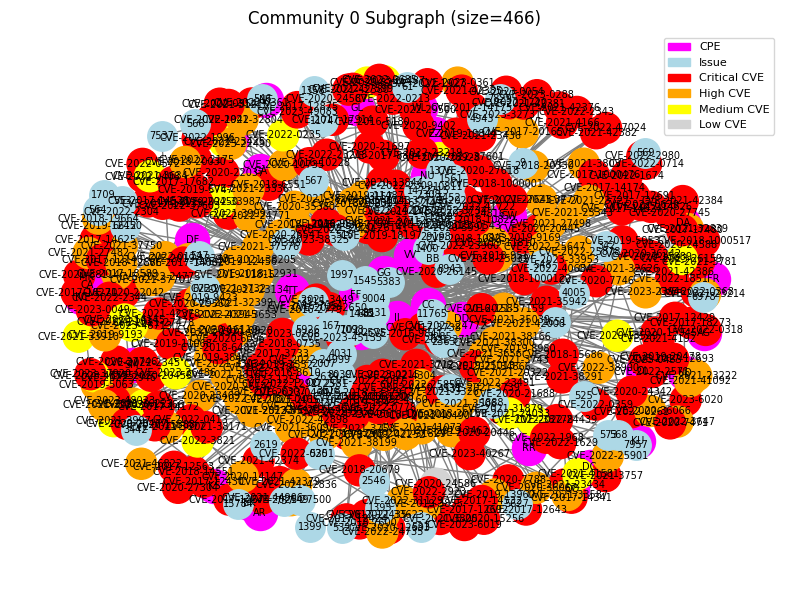

=== Community 1 Summary ===
Total Nodes: 265, Total Edges: 7450
CPE Nodes: 4, CVE Nodes: 216, Issue Nodes: 45
Severity Distribution (CVEs):
  Critical: 213
  High: 212
  Medium: 211
  Low: 0
Highest degree node: 7 (type=Issue, degree=203)
CPEs in this community: ['AS', 'X', 'GT', 'SS']
CVEs in this community: ['CVE-2022-23591', 'CVE-2021-41196', 'CVE-2021-37646', 'CVE-2020-15202', 'CVE-2022-21733', 'CVE-2019-9635', 'CVE-2018-25031', 'CVE-2022-23586', 'CVE-2022-23594', 'CVE-2021-41221', 'CVE-2020-15192', 'CVE-2022-23560', 'CVE-2022-29205', 'CVE-2020-15212', 'CVE-2020-15198', 'CVE-2019-19646', 'CVE-2020-11655', 'CVE-2022-23579', 'CVE-2022-23568', 'CVE-2021-37661', 'CVE-2022-23588', 'CVE-2022-29192', 'CVE-2020-15209', 'CVE-2021-37636', 'CVE-2022-29199', 'CVE-2021-37663', 'CVE-2022-29203', 'CVE-2021-37640', 'CVE-2022-23564', 'CVE-2021-41228', 'CVE-2022-23567', 'CVE-2020-11656', 'CVE-2020-13871', 'CVE-2022-29202', 'CVE-2021-41202', 'CVE-2022-29212', 'CVE-2020-15199', 'CVE-2021-41203', 'CVE-

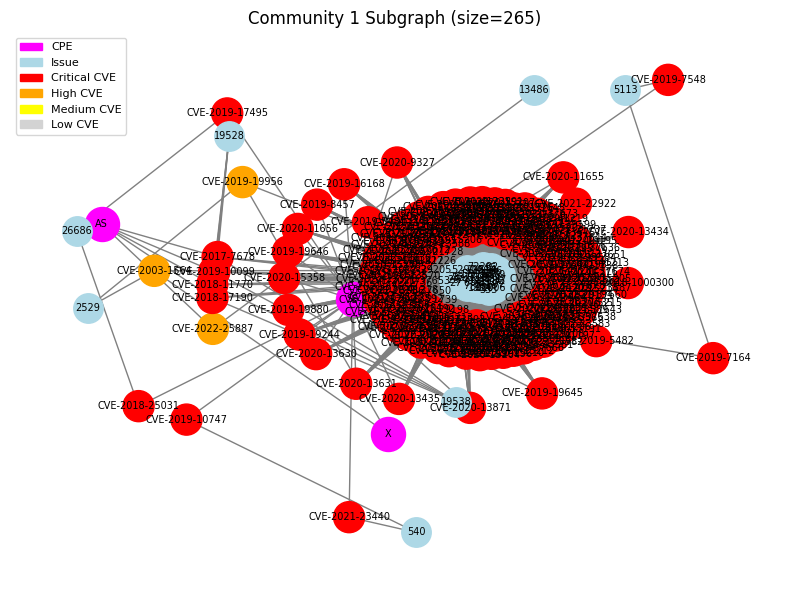

=== Community 2 Summary ===
Total Nodes: 125, Total Edges: 473
CPE Nodes: 7, CVE Nodes: 79, Issue Nodes: 39
Severity Distribution (CVEs):
  Critical: 50
  High: 70
  Medium: 41
  Low: 0
Highest degree node: PP (type=CPE, degree=57)
CPEs in this community: ['PP', 'JN', 'HT', 'GC', 'AA', 'RA', 'TF']
CVEs in this community: ['CVE-2020-6532', 'CVE-2022-22816', 'CVE-2021-3807', 'CVE-2021-30139', 'CVE-2021-29510', 'CVE-2022-2218', 'CVE-2022-24303', 'CVE-2023-52305', 'CVE-2023-52312', 'CVE-2022-0624', 'CVE-2022-2216', 'CVE-2021-28676', 'CVE-2021-28675', 'CVE-2024-22421', 'CVE-2021-25291', 'CVE-2020-1747', 'CVE-2021-25293', 'CVE-2020-26215', 'CVE-2019-18874', 'CVE-2021-25292', 'CVE-2024-23829', 'CVE-2023-52303', 'CVE-2022-45199', 'CVE-2022-30595', 'CVE-2023-50447', 'CVE-2021-43138', 'CVE-2024-0521', 'CVE-2023-52310', 'CVE-2023-7018', 'CVE-2021-3749', 'CVE-2023-52308', 'CVE-2022-3224', 'CVE-2023-52309', 'CVE-2021-28677', 'CVE-2022-40899', 'CVE-2023-49082', 'CVE-2019-10856', 'CVE-2023-52307', 'C

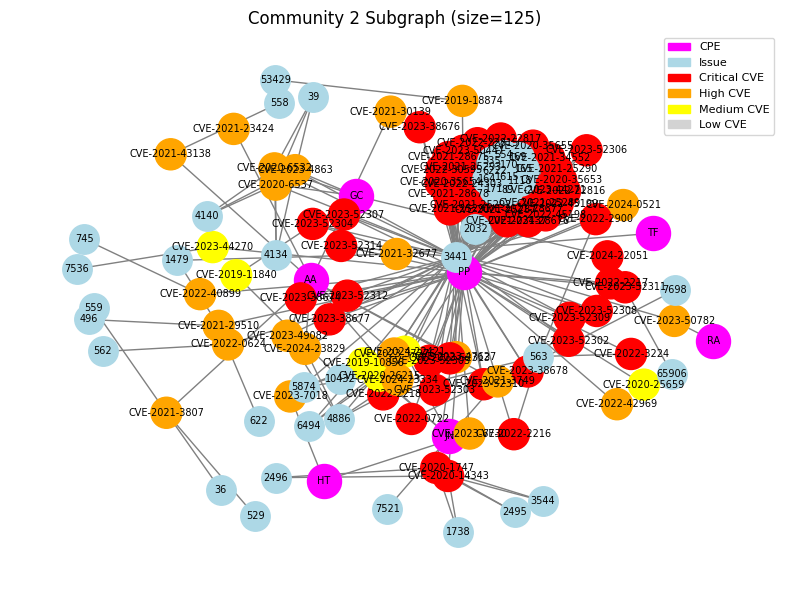

=== Community 3 Summary ===
Total Nodes: 67, Total Edges: 158
CPE Nodes: 9, CVE Nodes: 37, Issue Nodes: 21
Severity Distribution (CVEs):
  Critical: 17
  High: 29
  Medium: 28
  Low: 2
Highest degree node: 6595 (type=Issue, degree=22)
CPEs in this community: ['AC', 'EJ', 'AL', 'GO', 'SO', 'GP', 'AH', 'IH', 'FJ']
CVEs in this community: ['CVE-2017-15713', 'CVE-2019-16335', 'CVE-2022-23302', 'CVE-2022-42889', 'CVE-2023-26048', 'CVE-2019-14540', 'CVE-2018-12545', 'CVE-2021-22573', 'CVE-2019-17571', 'CVE-2021-22569', 'CVE-2019-12814', 'CVE-2020-8908', 'CVE-2021-35515', 'CVE-2022-42004', 'CVE-2021-44832', 'CVE-2018-10237', 'CVE-2022-25857', 'CVE-2021-4104', 'CVE-2018-8009', 'CVE-2017-15718', 'CVE-2017-18640', 'CVE-2017-12197', 'CVE-2022-2048', 'CVE-2019-10172', 'CVE-2023-41900', 'CVE-2020-36518', 'CVE-2023-40167', 'CVE-2021-37404', 'CVE-2023-44487', 'CVE-2016-2402', 'CVE-2022-3509', 'CVE-2022-21230', 'CVE-2022-23305', 'CVE-2016-3086', 'CVE-2021-44228', 'CVE-2022-1941', 'CVE-2021-29425']
Iss

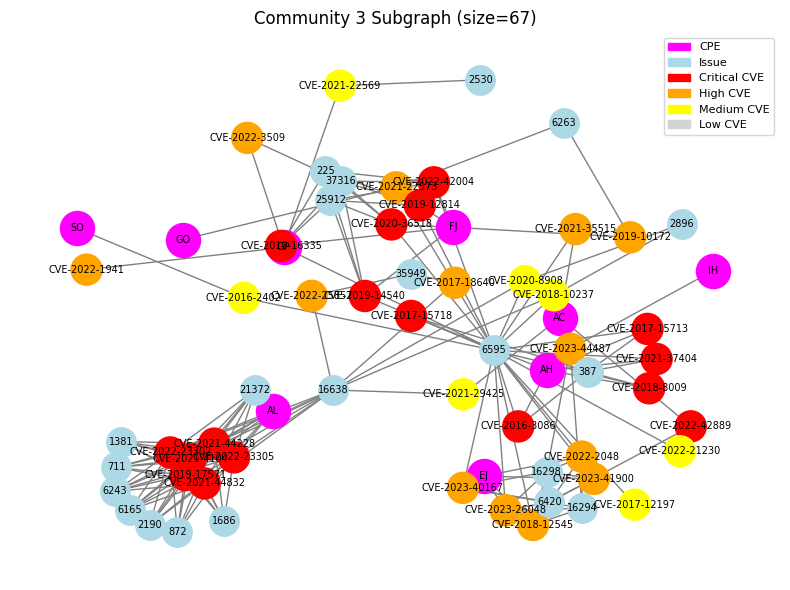

=== Community 4 Summary ===
Total Nodes: 56, Total Edges: 151
CPE Nodes: 3, CVE Nodes: 33, Issue Nodes: 20
Severity Distribution (CVEs):
  Critical: 22
  High: 24
  Medium: 22
  Low: 0
Highest degree node: 2016 (type=Issue, degree=18)
CPEs in this community: ['GH', 'RO', 'NN']
CVEs in this community: ['CVE-2023-29406', 'CVE-2021-41495', 'CVE-2023-24538', 'CVE-2023-29404', 'CVE-2023-24537', 'CVE-2020-7789', 'CVE-2022-41721', 'CVE-2023-24534', 'CVE-2023-24540', 'CVE-2018-20834', 'CVE-2021-29923', 'CVE-2023-29405', 'CVE-2019-6446', 'CVE-2021-33502', 'CVE-2023-2253', 'CVE-2023-29403', 'CVE-2021-41496', 'CVE-2018-8735', 'CVE-2021-3580', 'CVE-2023-29402', 'CVE-2020-26139', 'CVE-2018-8733', 'CVE-2021-23566', 'CVE-2022-29244', 'CVE-2018-8734', 'CVE-2023-24536', 'CVE-2022-41723', 'CVE-2018-8736', 'CVE-2022-27664', 'CVE-2019-14751', 'CVE-2021-34141', 'CVE-2021-33430', 'CVE-2022-32149']
Issues in this community: ['11023', '10548', '21713', '516', '3086', '2016', '7885', '537', '1202', '5095', '11

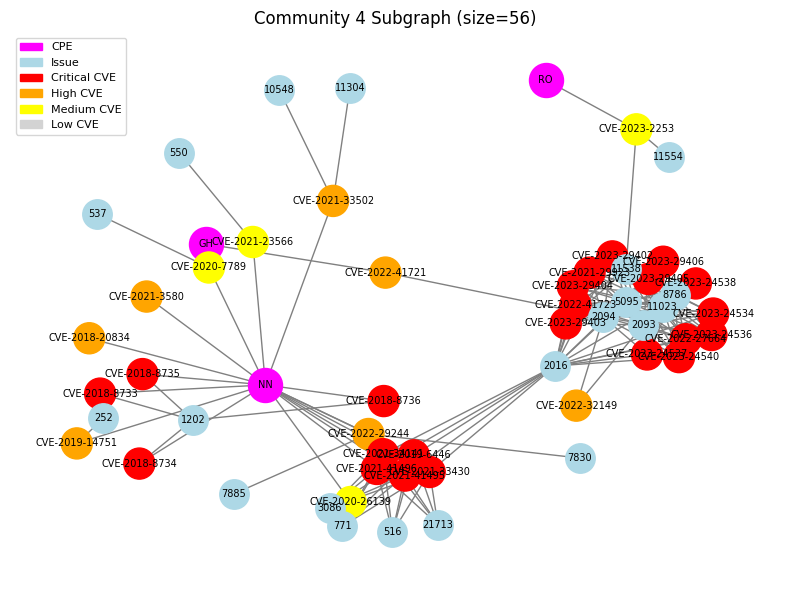

=== Community 5 Summary ===
Total Nodes: 30, Total Edges: 102
CPE Nodes: 2, CVE Nodes: 24, Issue Nodes: 4
Severity Distribution (CVEs):
  Critical: 24
  High: 18
  Medium: 18
  Low: 6
Highest degree node: 53015 (type=Issue, degree=24)
CPEs in this community: ['HL', 'HC']
CVEs in this community: ['CVE-2022-27781', 'CVE-2017-8818', 'CVE-2022-27778', 'CVE-2022-27782', 'CVE-2021-22945', 'CVE-2022-27774', 'CVE-2021-22947', 'CVE-2021-22923', 'CVE-2022-22576', 'CVE-2023-46218', 'CVE-2017-8817', 'CVE-2022-27775', 'CVE-2017-8816', 'CVE-2021-22924', 'CVE-2022-27780', 'CVE-2021-22925', 'CVE-2023-46219', 'CVE-2021-22926', 'CVE-2022-27776', 'CVE-2021-22946', 'CVE-2022-27779', 'CVE-2018-1000005', 'CVE-2022-30115', 'CVE-2023-23916']
Issues in this community: ['55772', '53015', '56060', '69799']
=== End of Summary ===



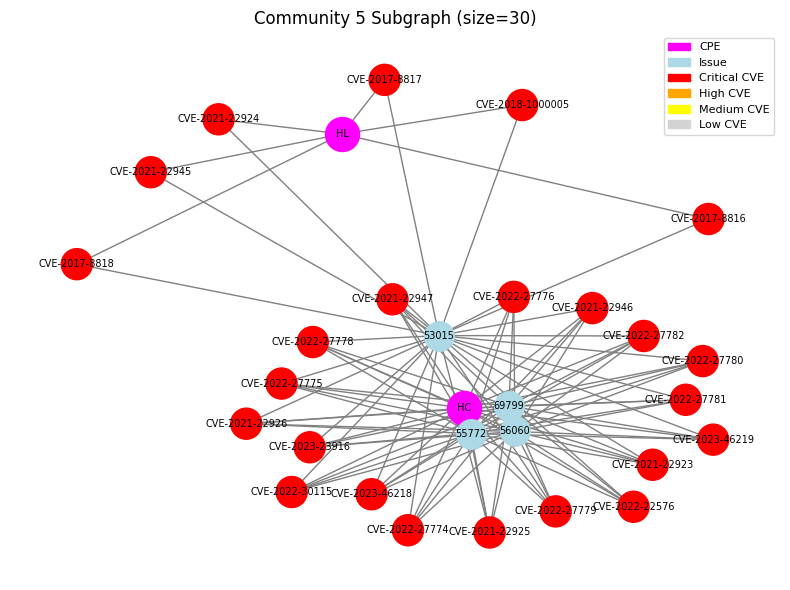

=== Community 6 Summary ===
Total Nodes: 26, Total Edges: 44
CPE Nodes: 1, CVE Nodes: 12, Issue Nodes: 13
Severity Distribution (CVEs):
  Critical: 2
  High: 5
  Medium: 5
  Low: 0
Highest degree node: JJ (type=CPE, degree=12)
CPEs in this community: ['JJ']
CVEs in this community: ['CVE-2022-40150', 'CVE-2022-45685', 'CVE-2023-1436', 'CVE-2022-45693', 'CVE-2021-3918', 'CVE-2020-11023', 'CVE-2020-11022', 'CVE-2019-11358', 'CVE-2020-26232', 'CVE-2022-46175', 'CVE-2018-9206', 'CVE-2021-20066']
Issues in this community: ['5489', '345', '20922', '6831', '6827', '560', '15020', '543', '6826', '25645', '15364', '1383', '571']
=== End of Summary ===



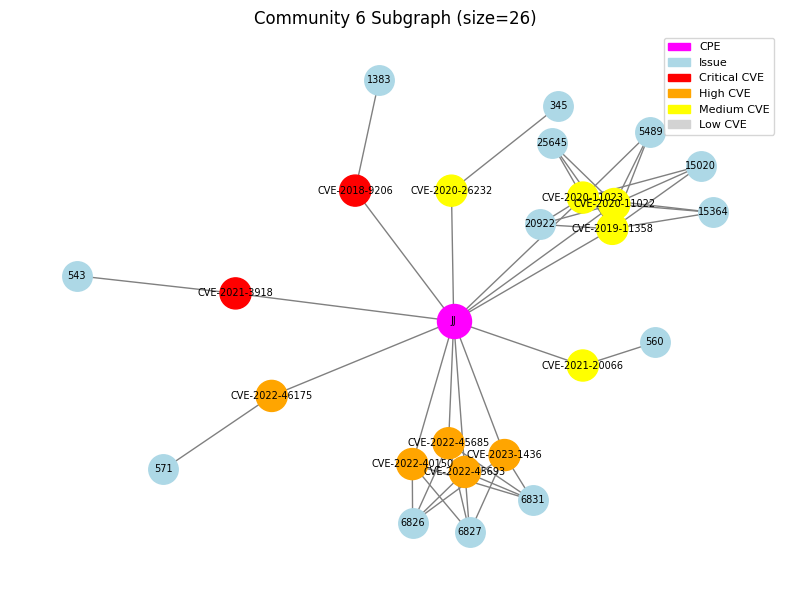

=== Community 7 Summary ===
Total Nodes: 17, Total Edges: 18
CPE Nodes: 1, CVE Nodes: 10, Issue Nodes: 6
Severity Distribution (CVEs):
  Critical: 8
  High: 4
  Medium: 0
  Low: 0
Highest degree node: MM (type=CPE, degree=10)
CPEs in this community: ['MM']
CVEs in this community: ['CVE-2018-16490', 'CVE-2019-10746', 'CVE-2021-26707', 'CVE-2017-17458', 'CVE-2018-13347', 'CVE-2021-29063', 'CVE-2021-23438', 'CVE-2017-16114', 'CVE-2022-2564', 'CVE-2023-3696']
Issues in this community: ['118128', '534', '521', '572', '536', '161']
=== End of Summary ===



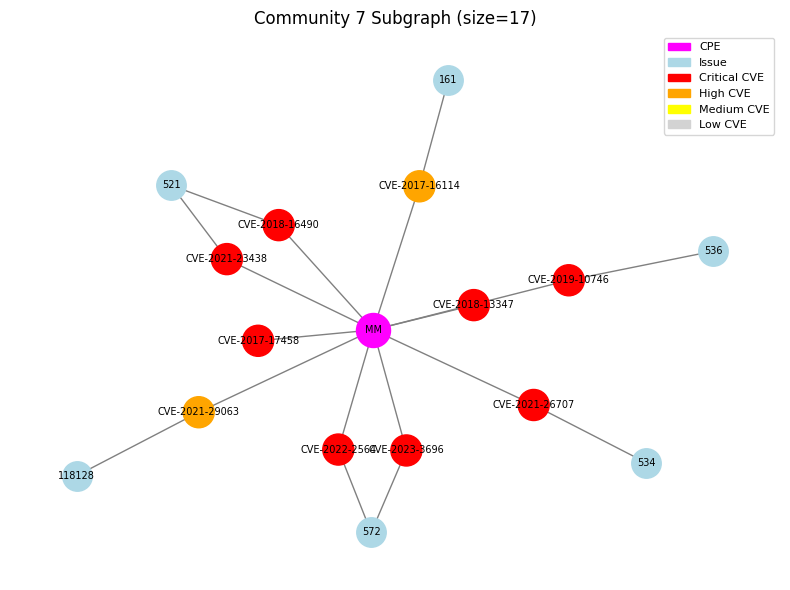

=== Community 8 Summary ===
Total Nodes: 16, Total Edges: 26
CPE Nodes: 1, CVE Nodes: 13, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 4
  High: 13
  Medium: 9
  Low: 0
Highest degree node: 4245 (type=Issue, degree=13)
CPEs in this community: ['FL']
CVEs in this community: ['CVE-2022-0924', 'CVE-2022-2520', 'CVE-2022-2521', 'CVE-2022-0908', 'CVE-2022-0891', 'CVE-2021-33643', 'CVE-2021-33646', 'CVE-2021-33644', 'CVE-2022-2953', 'CVE-2021-33645', 'CVE-2022-2519', 'CVE-2022-0909', 'CVE-2022-0907']
Issues in this community: ['4245', '3752']
=== End of Summary ===



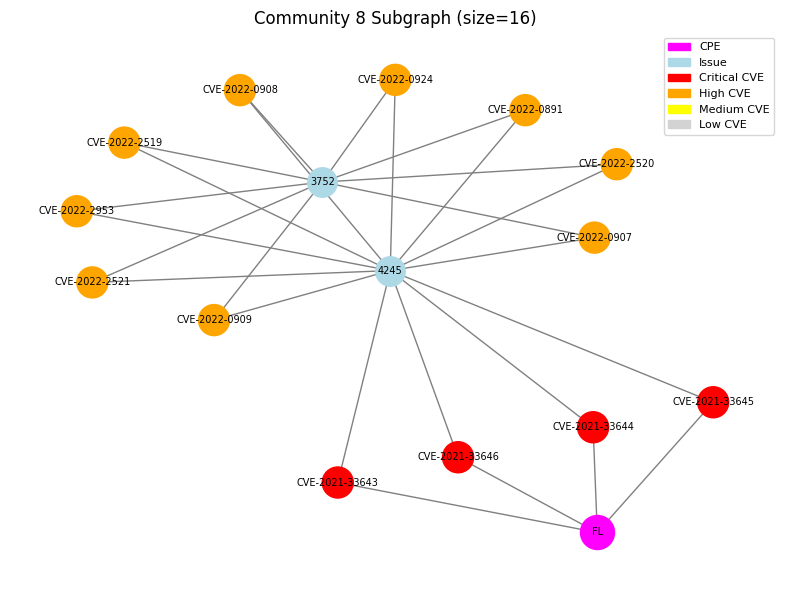

=== Community 9 Summary ===
Total Nodes: 11, Total Edges: 10
CPE Nodes: 1, CVE Nodes: 5, Issue Nodes: 5
Severity Distribution (CVEs):
  Critical: 1
  High: 1
  Medium: 3
  Low: 0
Highest degree node: UU (type=CPE, degree=5)
CPEs in this community: ['UU']
CVEs in this community: ['CVE-2021-23358', 'CVE-2018-6758', 'CVE-2021-27515', 'CVE-2022-0530', 'CVE-2021-45958']
Issues in this community: ['2240', '3127', '10753', '2590', '3134']
=== End of Summary ===



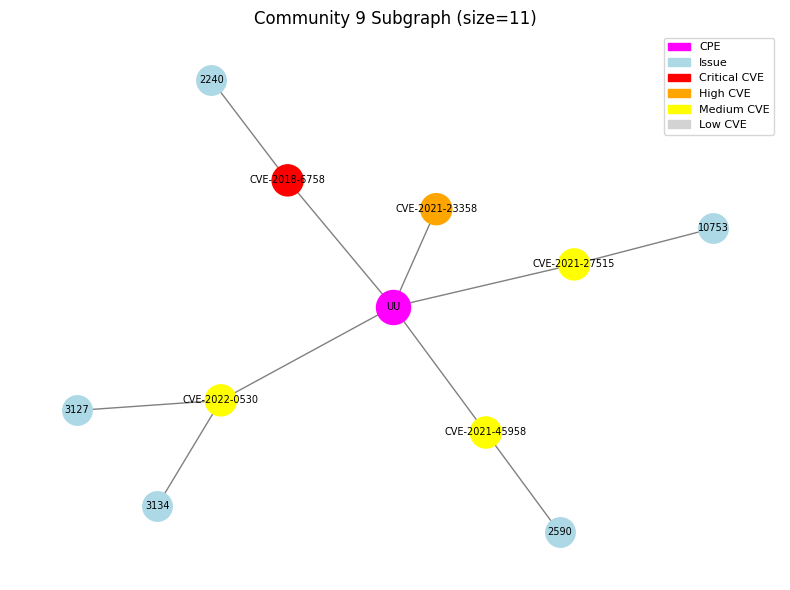

=== Community 10 Summary ===
Total Nodes: 10, Total Edges: 25
CPE Nodes: 0, CVE Nodes: 5, Issue Nodes: 5
Severity Distribution (CVEs):
  Critical: 5
  High: 5
  Medium: 5
  Low: 0
Highest degree node: CVE-2018-16487 (type=CVE, degree=5)
CPEs in this community: []
CVEs in this community: ['CVE-2018-16487', 'CVE-2020-8203', 'CVE-2020-28500', 'CVE-2021-23337', 'CVE-2019-10744']
Issues in this community: ['474', '150', '15363', '12272', '4820']
=== End of Summary ===



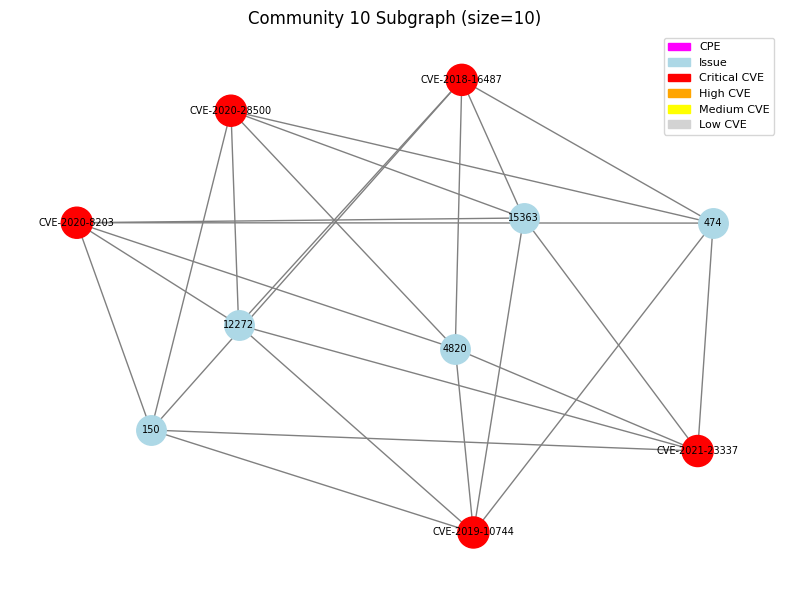

=== Community 11 Summary ===
Total Nodes: 10, Total Edges: 11
CPE Nodes: 1, CVE Nodes: 6, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 3
  High: 6
  Medium: 0
  Low: 0
Highest degree node: HH (type=CPE, degree=6)
CPEs in this community: ['HH']
CVEs in this community: ['CVE-2022-45142', 'CVE-2023-6016', 'CVE-2022-25881', 'CVE-2023-6038', 'CVE-2023-6569', 'CVE-2020-36604']
Issues in this community: ['565', '570', '16341']
=== End of Summary ===



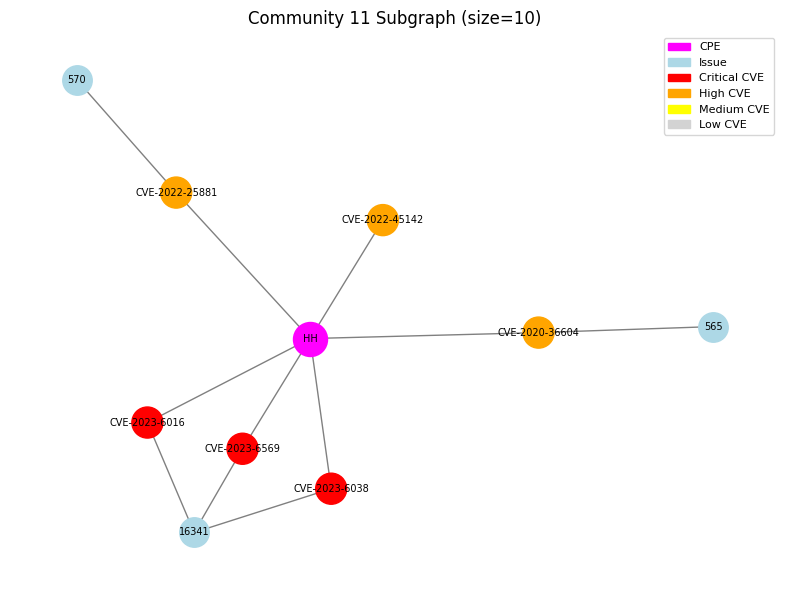

=== Community 12 Summary ===
Total Nodes: 9, Total Edges: 14
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 6
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-13949 (type=CVE, degree=7)
CPEs in this community: ['AT']
CVEs in this community: ['CVE-2020-13949', 'CVE-2019-0205']
Issues in this community: ['35588', '35587', '34362', '35646', '34361', '35647']
=== End of Summary ===



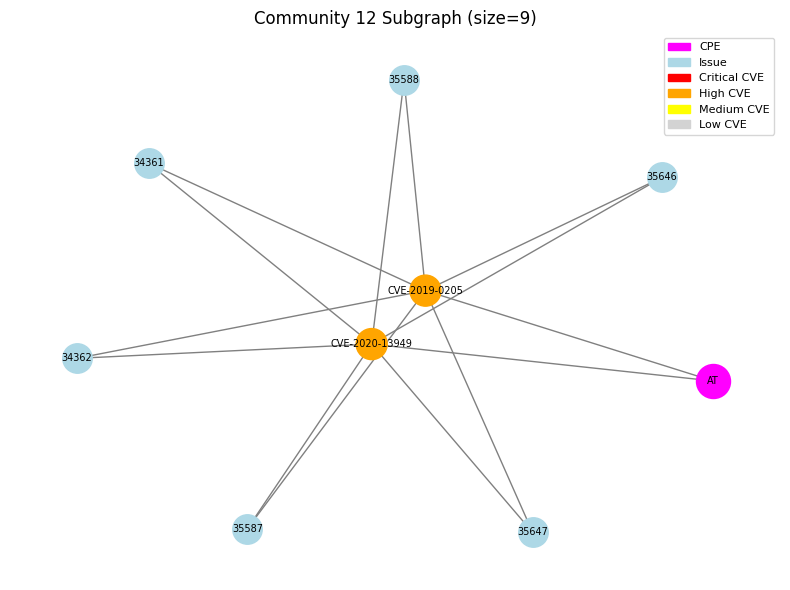

=== Community 13 Summary ===
Total Nodes: 9, Total Edges: 8
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 7
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2023-47248 (type=CVE, degree=8)
CPEs in this community: ['AP']
CVEs in this community: ['CVE-2023-47248']
Issues in this community: ['3367', '41314', '4465', '6404', '3866', '1062', '3832']
=== End of Summary ===



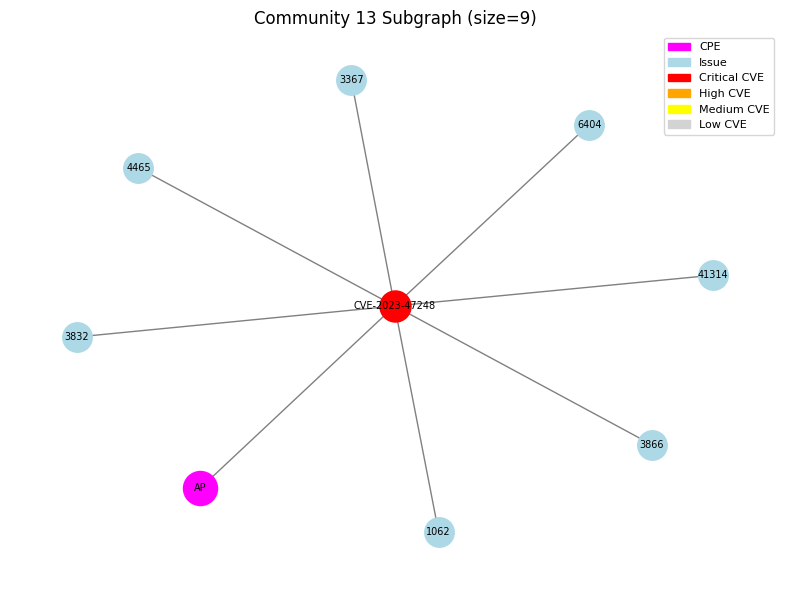

=== Community 14 Summary ===
Total Nodes: 8, Total Edges: 9
CPE Nodes: 1, CVE Nodes: 4, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 1
  High: 3
  Medium: 2
  Low: 0
Highest degree node: EE (type=CPE, degree=4)
CPEs in this community: ['EE']
CVEs in this community: ['CVE-2022-29078', 'CVE-2020-13822', 'CVE-2021-22204', 'CVE-2020-28498']
Issues in this community: ['1302', '530', '552']
=== End of Summary ===



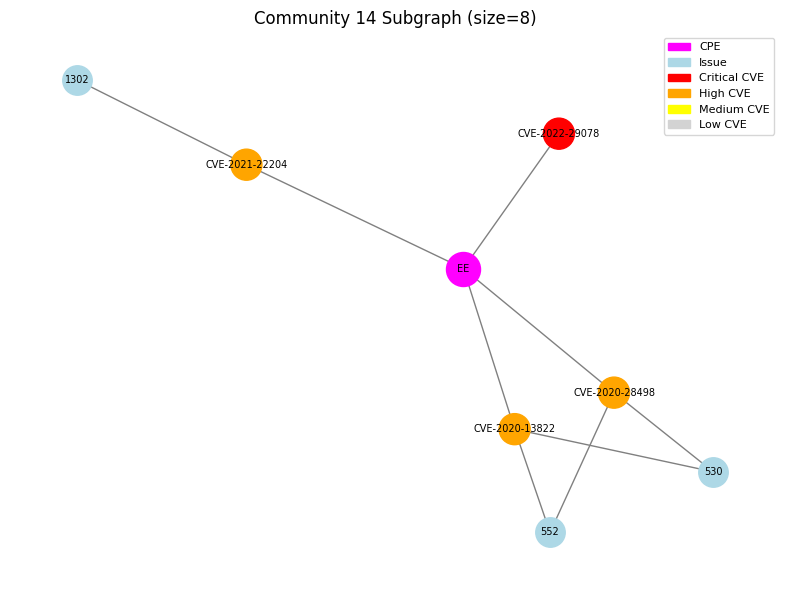

=== Community 15 Summary ===
Total Nodes: 7, Total Edges: 6
CPE Nodes: 1, CVE Nodes: 3, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 2
  Low: 0
Highest degree node: WW (type=CPE, degree=3)
CPEs in this community: ['WW']
CVEs in this community: ['CVE-2020-7662', 'CVE-2021-32640', 'CVE-2021-33880']
Issues in this community: ['506', '9519', '5']
=== End of Summary ===



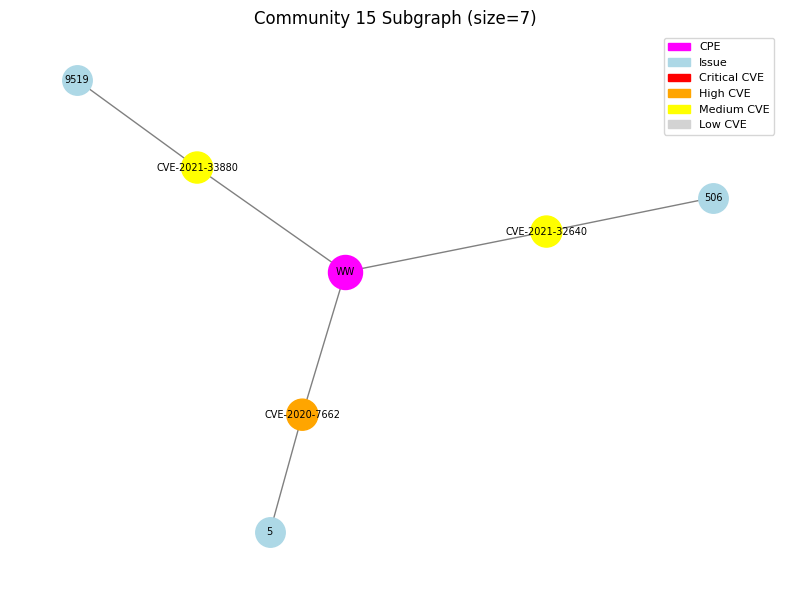

=== Community 16 Summary ===
Total Nodes: 6, Total Edges: 8
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 2
  Low: 0
Highest degree node: CVE-2023-32681 (type=CVE, degree=4)
CPEs in this community: ['PR']
CVEs in this community: ['CVE-2023-32681', 'CVE-2018-18074']
Issues in this community: ['1340', '111', '4517']
=== End of Summary ===



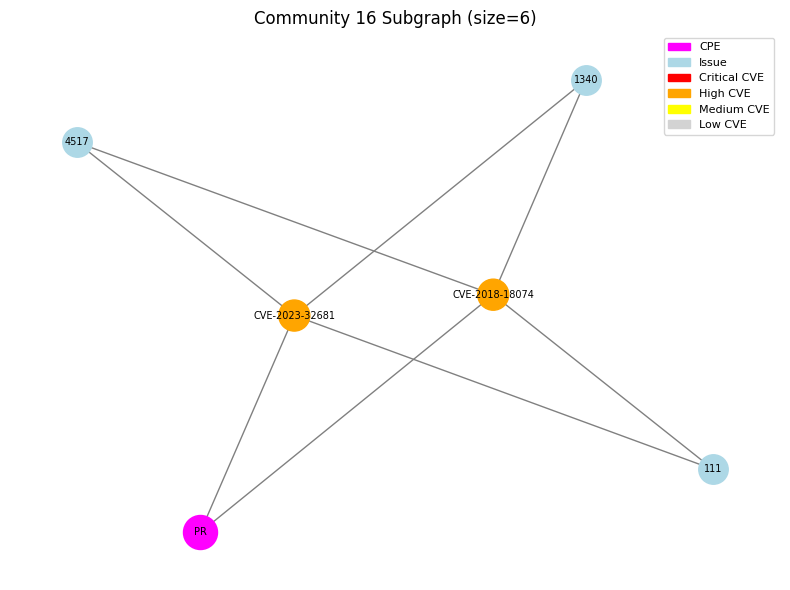

=== Community 17 Summary ===
Total Nodes: 6, Total Edges: 5
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 5
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-10531 (type=CVE, degree=5)
CPEs in this community: []
CVEs in this community: ['CVE-2020-10531']
Issues in this community: ['54186', '54185', '54183', '54184', '54182']
=== End of Summary ===



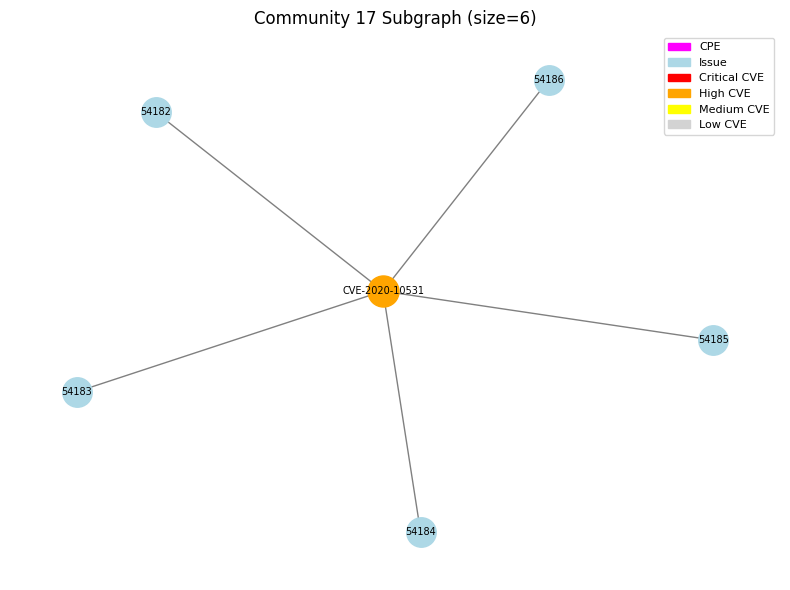

=== Community 18 Summary ===
Total Nodes: 6, Total Edges: 5
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 1
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-7660 (type=CVE, degree=3)
CPEs in this community: ['VS']
CVEs in this community: ['CVE-2020-7660', 'CVE-2022-22978']
Issues in this community: ['555', '538', '129']
=== End of Summary ===



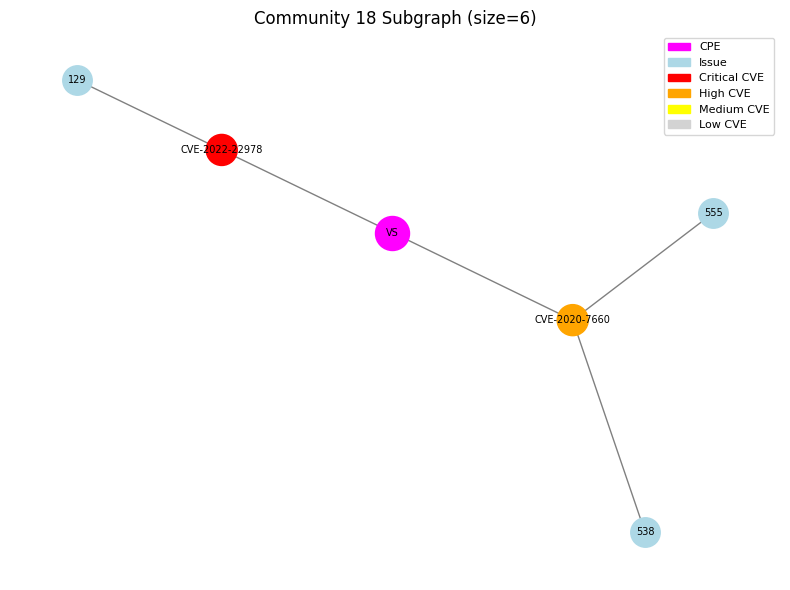

=== Community 19 Summary ===
Total Nodes: 5, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2017-5754 (type=CVE, degree=2)
CPEs in this community: ['IC']
CVEs in this community: ['CVE-2017-5754', 'CVE-2019-11510']
Issues in this community: ['1708', '16603']
=== End of Summary ===



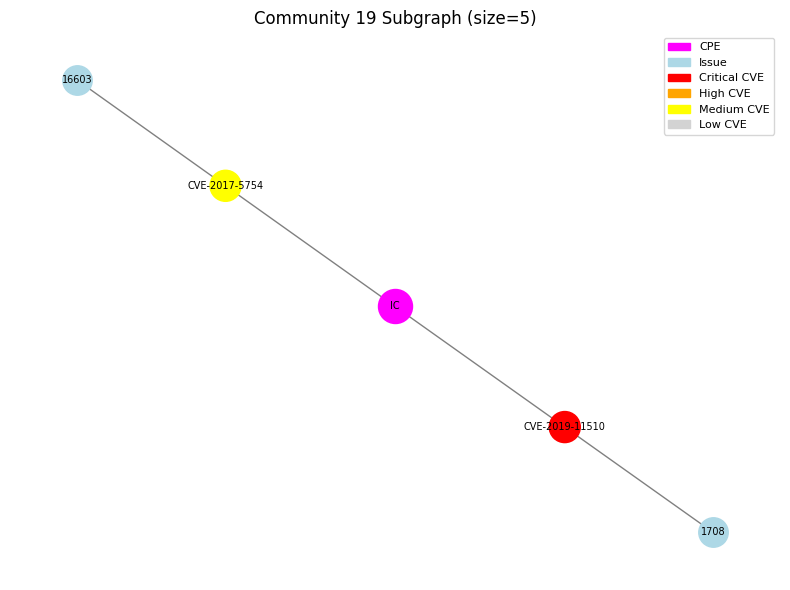

=== Community 20 Summary ===
Total Nodes: 5, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-13091 (type=CVE, degree=4)
CPEs in this community: ['NP']
CVEs in this community: ['CVE-2020-13091']
Issues in this community: ['36256', '60657', '48049']
=== End of Summary ===



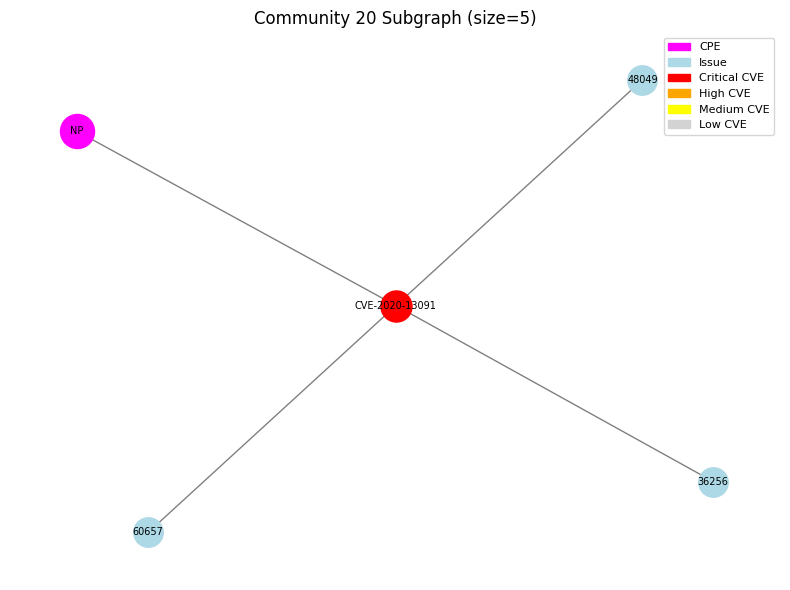

=== Community 21 Summary ===
Total Nodes: 4, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 0
  Low: 0
Highest degree node: 2618 (type=Issue, degree=2)
CPEs in this community: ['IL']
CVEs in this community: ['CVE-2020-14152', 'CVE-2020-14153']
Issues in this community: ['2618']
=== End of Summary ===



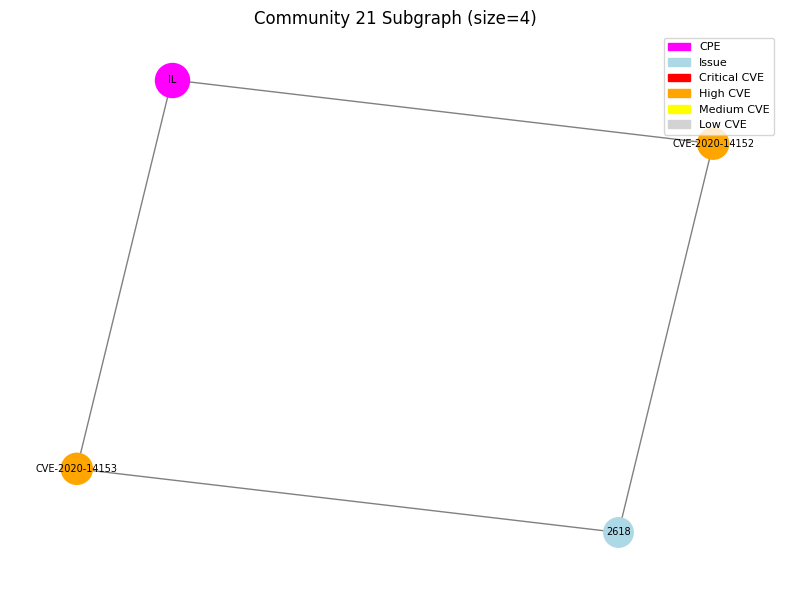

=== Community 22 Summary ===
Total Nodes: 4, Total Edges: 3
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-7774 (type=CVE, degree=3)
CPEs in this community: ['YY']
CVEs in this community: ['CVE-2020-7774']
Issues in this community: ['542', '557']
=== End of Summary ===



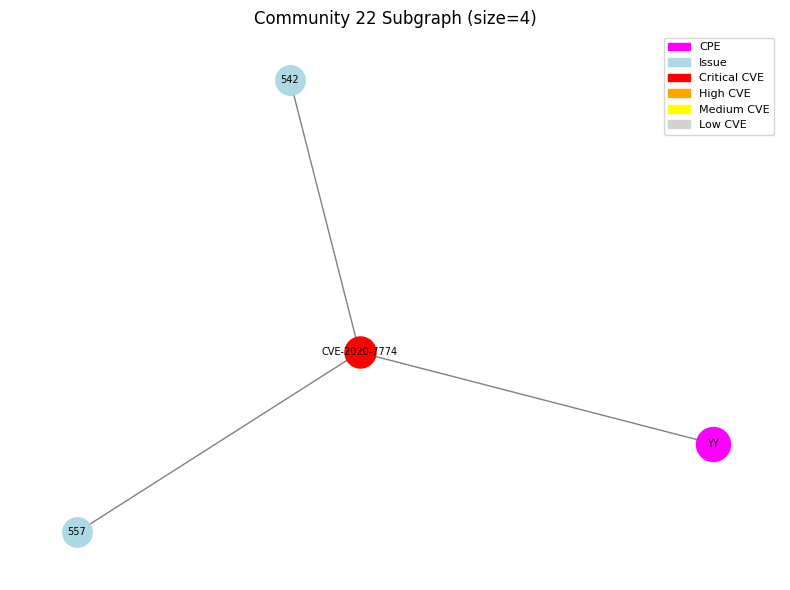

=== Community 23 Summary ===
Total Nodes: 4, Total Edges: 3
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2021-27290 (type=CVE, degree=3)
CPEs in this community: []
CVEs in this community: ['CVE-2021-27290']
Issues in this community: ['556', '10818', '541']
=== End of Summary ===



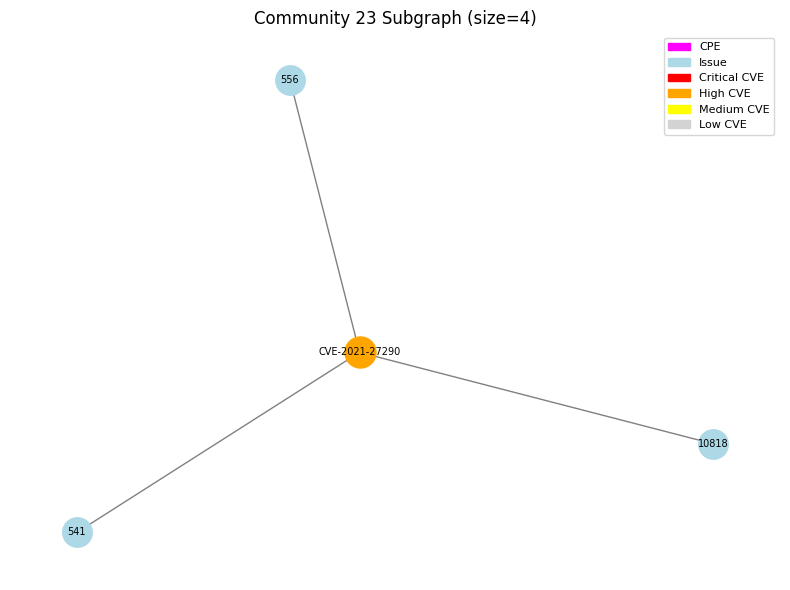

=== Community 24 Summary ===
Total Nodes: 4, Total Edges: 3
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 0
  Low: 0
Highest degree node: 3361 (type=Issue, degree=2)
CPEs in this community: ['PC']
CVEs in this community: ['CVE-2022-21698', 'CVE-2023-45142']
Issues in this community: ['3361']
=== End of Summary ===



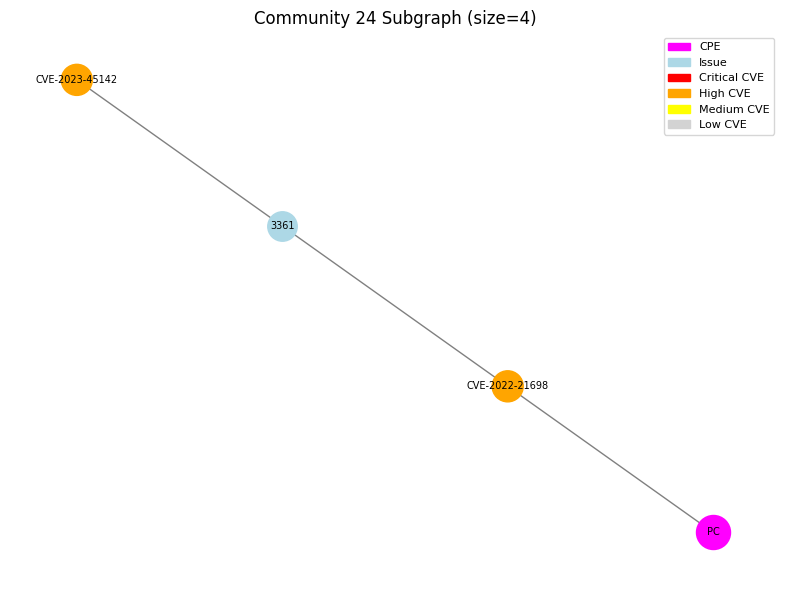

=== Community 25 Summary ===
Total Nodes: 4, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 2
  Low: 0
Highest degree node: 1049 (type=Issue, degree=2)
CPEs in this community: ['PU']
CVEs in this community: ['CVE-2023-45803', 'CVE-2023-43804']
Issues in this community: ['1049']
=== End of Summary ===



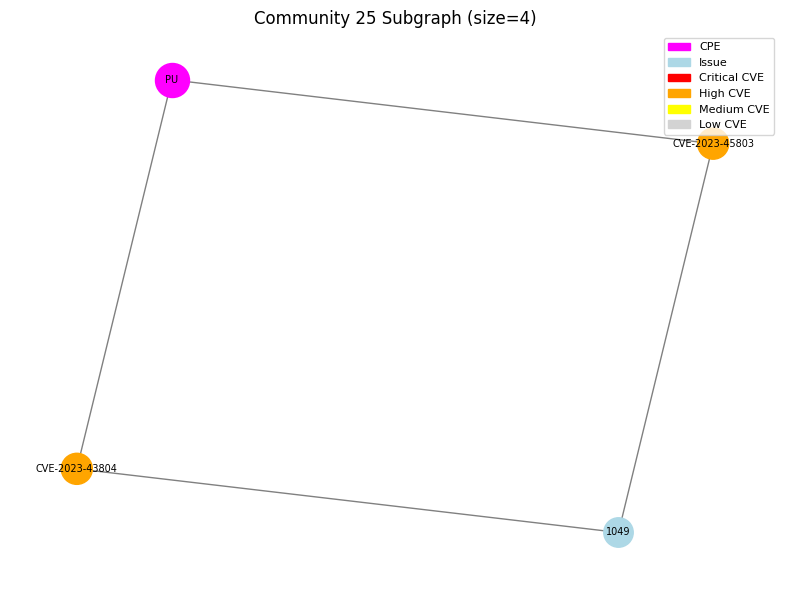

=== Community 26 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2017-5689 (type=CVE, degree=2)
CPEs in this community: ['IA']
CVEs in this community: ['CVE-2017-5689']
Issues in this community: ['1066']
=== End of Summary ===



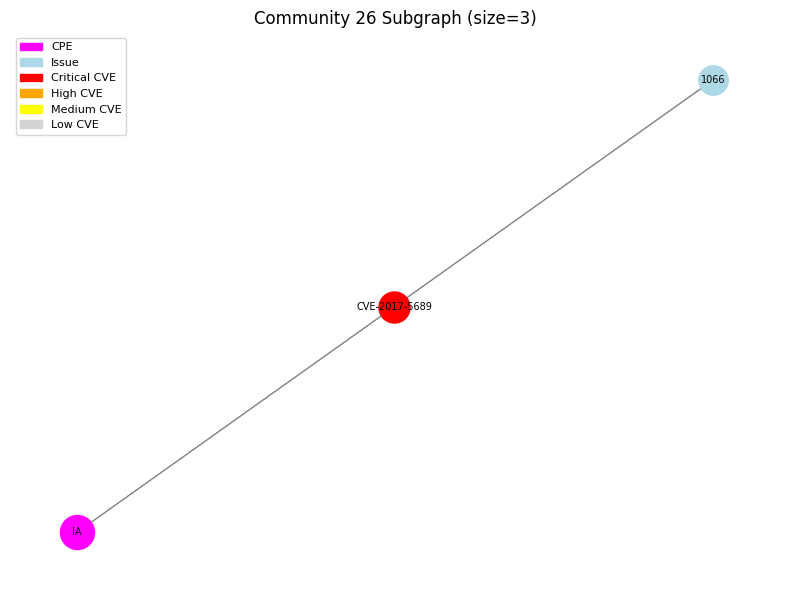

=== Community 27 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2017-9805 (type=CVE, degree=2)
CPEs in this community: []
CVEs in this community: ['CVE-2017-9805']
Issues in this community: ['1712', '1463']
=== End of Summary ===



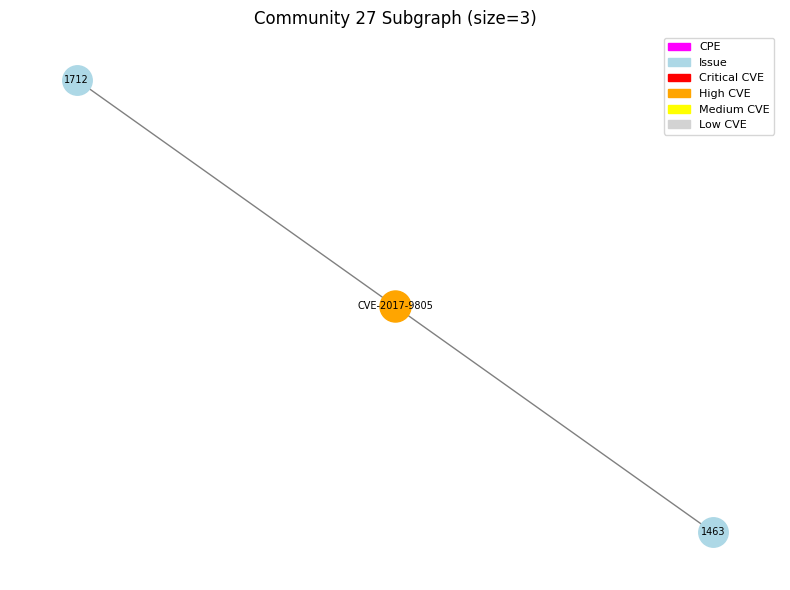

=== Community 28 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2019-0201 (type=CVE, degree=2)
CPEs in this community: ['AZ']
CVEs in this community: ['CVE-2019-0201']
Issues in this community: ['25933']
=== End of Summary ===



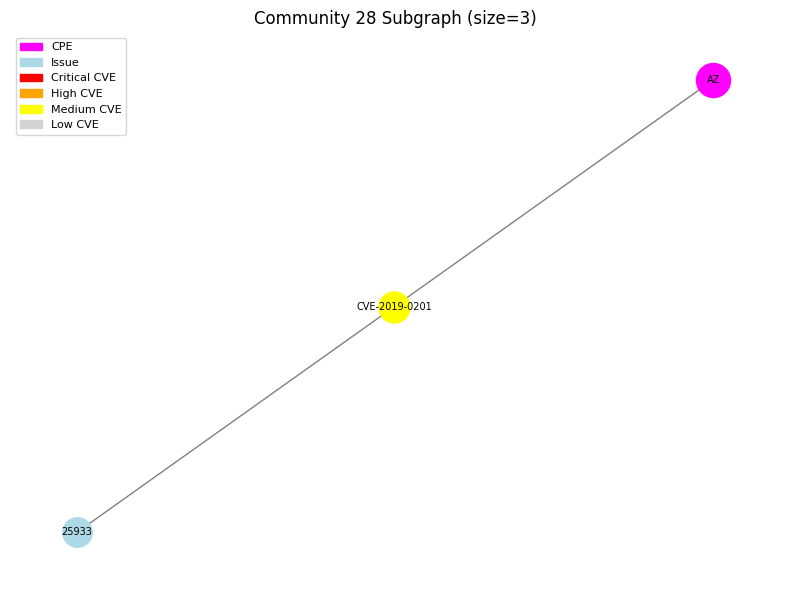

=== Community 29 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2019-10906 (type=CVE, degree=2)
CPEs in this community: ['PJ']
CVEs in this community: ['CVE-2019-10906']
Issues in this community: ['1193']
=== End of Summary ===



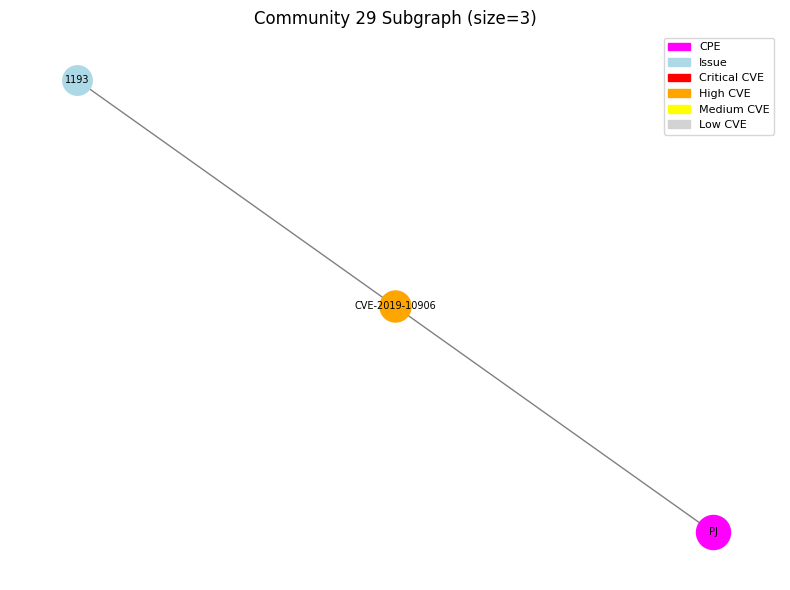

=== Community 30 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2019-16789 (type=CVE, degree=2)
CPEs in this community: ['AW']
CVEs in this community: ['CVE-2019-16789']
Issues in this community: ['139']
=== End of Summary ===



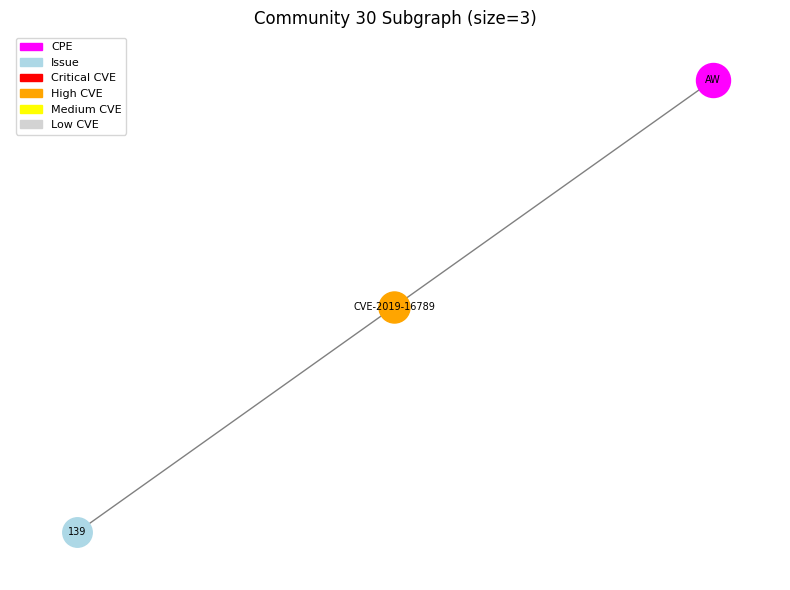

=== Community 31 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2019-20149 (type=CVE, degree=2)
CPEs in this community: ['KK']
CVEs in this community: ['CVE-2019-20149']
Issues in this community: ['533']
=== End of Summary ===



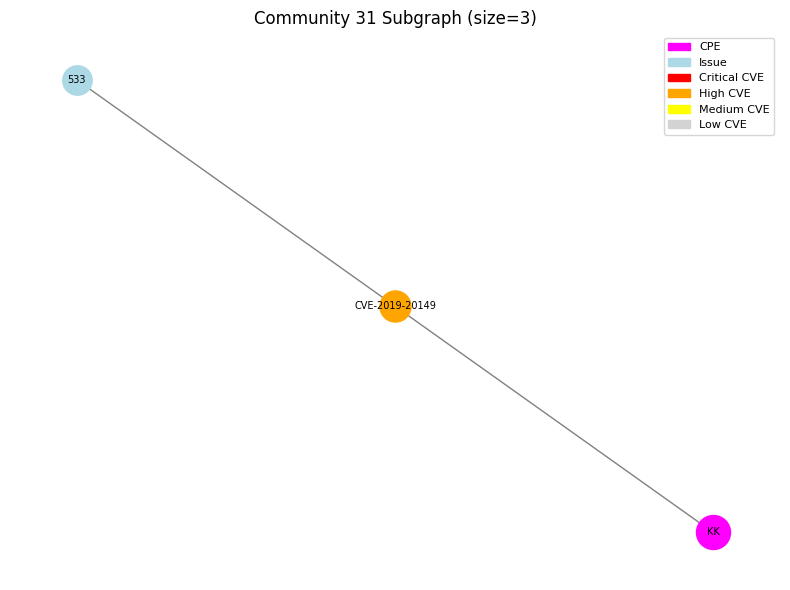

=== Community 32 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2019-2391 (type=CVE, degree=2)
CPEs in this community: ['MJ']
CVEs in this community: ['CVE-2019-2391']
Issues in this community: ['501']
=== End of Summary ===



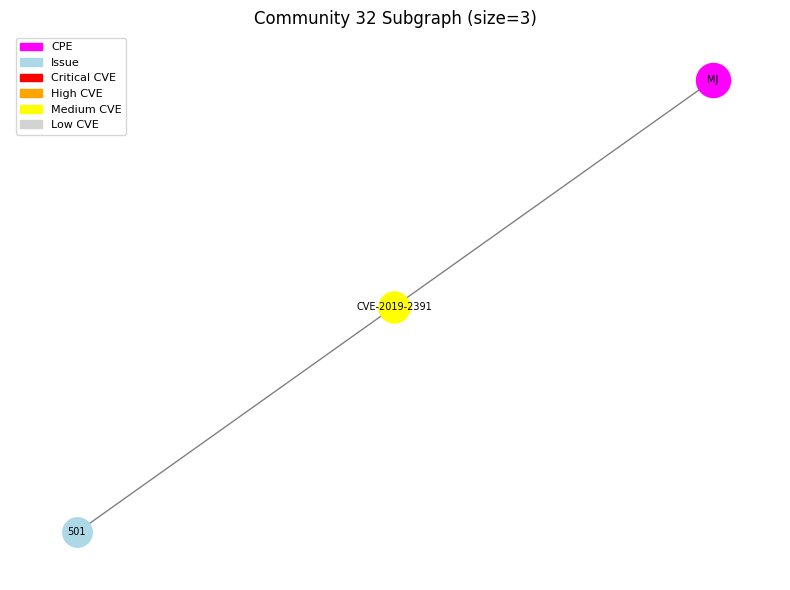

=== Community 33 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-14882 (type=CVE, degree=2)
CPEs in this community: ['OW']
CVEs in this community: ['CVE-2020-14882']
Issues in this community: ['2169']
=== End of Summary ===



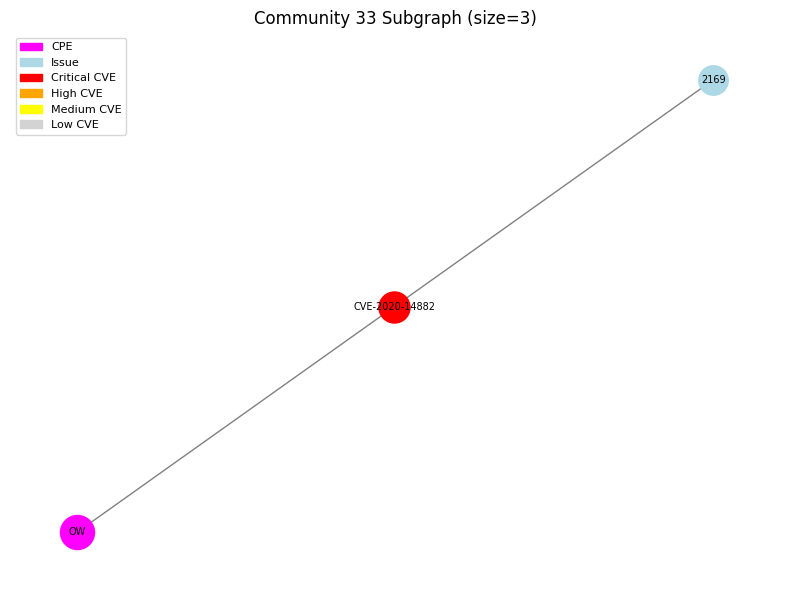

=== Community 34 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2021-23362 (type=CVE, degree=2)
CPEs in this community: ['NH']
CVEs in this community: ['CVE-2021-23362']
Issues in this community: ['502']
=== End of Summary ===



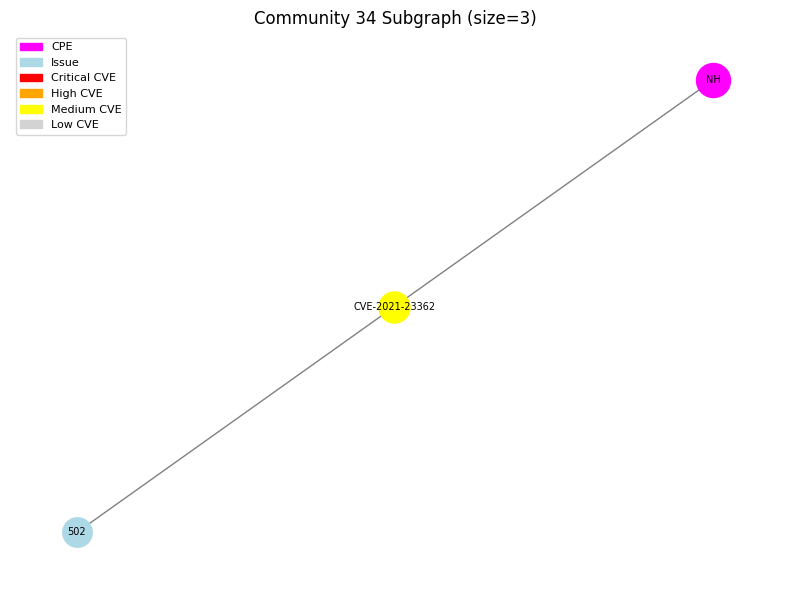

=== Community 35 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2021-24032 (type=CVE, degree=2)
CPEs in this community: ['FZ']
CVEs in this community: ['CVE-2021-24032']
Issues in this community: ['1701']
=== End of Summary ===



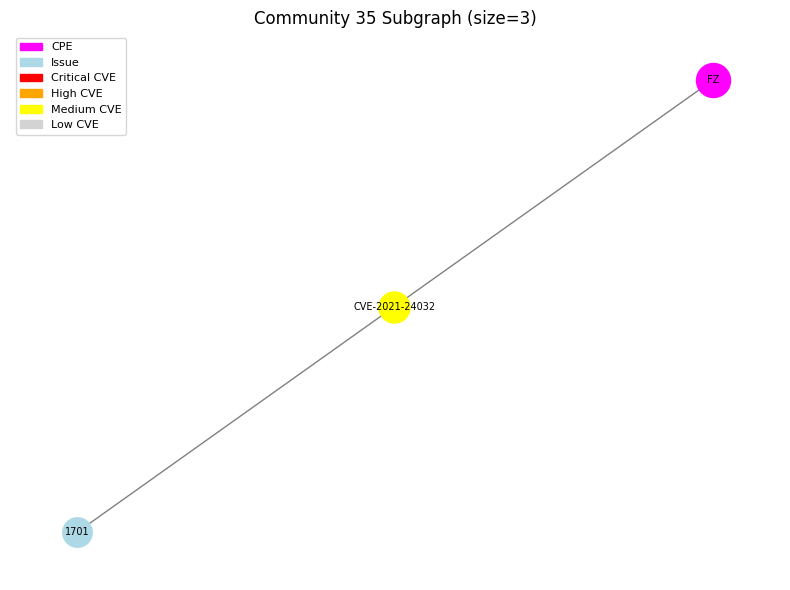

=== Community 36 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2021-44732 (type=CVE, degree=2)
CPEs in this community: ['AM']
CVEs in this community: ['CVE-2021-44732']
Issues in this community: ['43677']
=== End of Summary ===



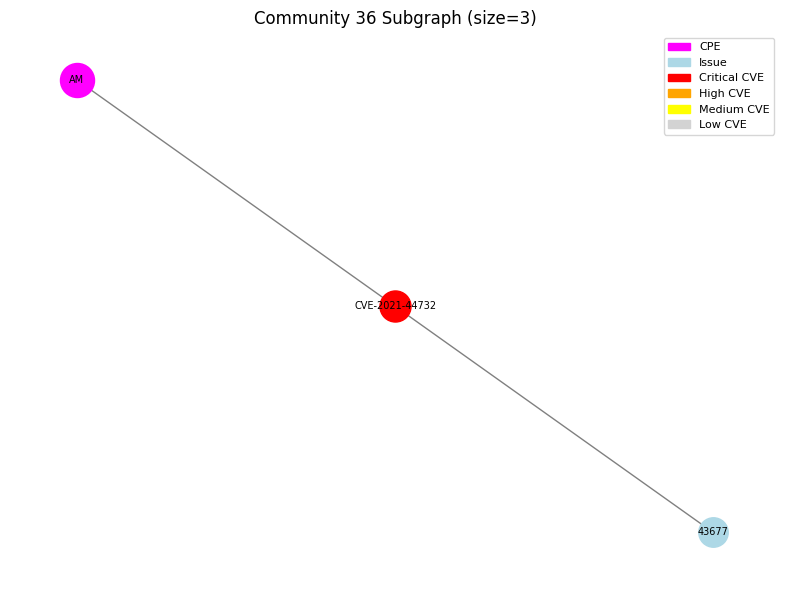

=== Community 37 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2022-21907 (type=CVE, degree=2)
CPEs in this community: ['MW']
CVEs in this community: ['CVE-2022-21907']
Issues in this community: ['2447']
=== End of Summary ===



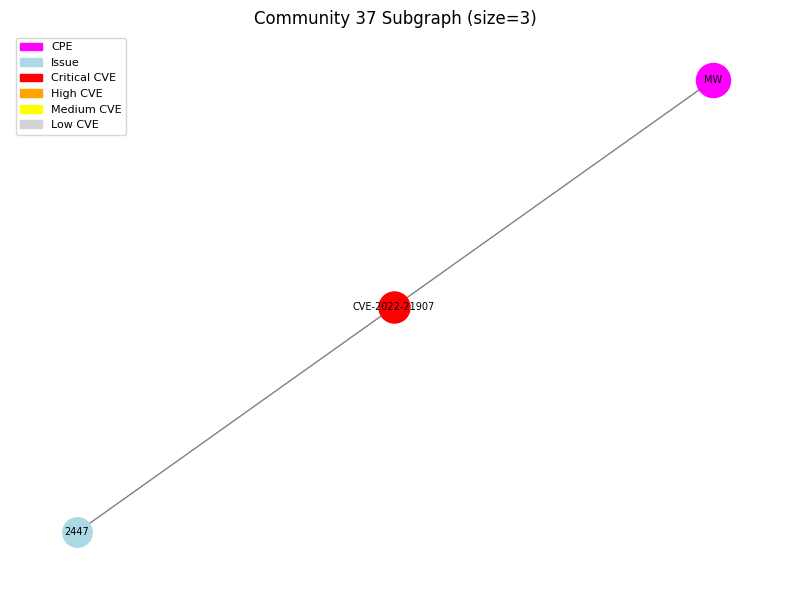

=== Community 38 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2022-27191 (type=CVE, degree=2)
CPEs in this community: ['GS']
CVEs in this community: ['CVE-2022-27191']
Issues in this community: ['1875']
=== End of Summary ===



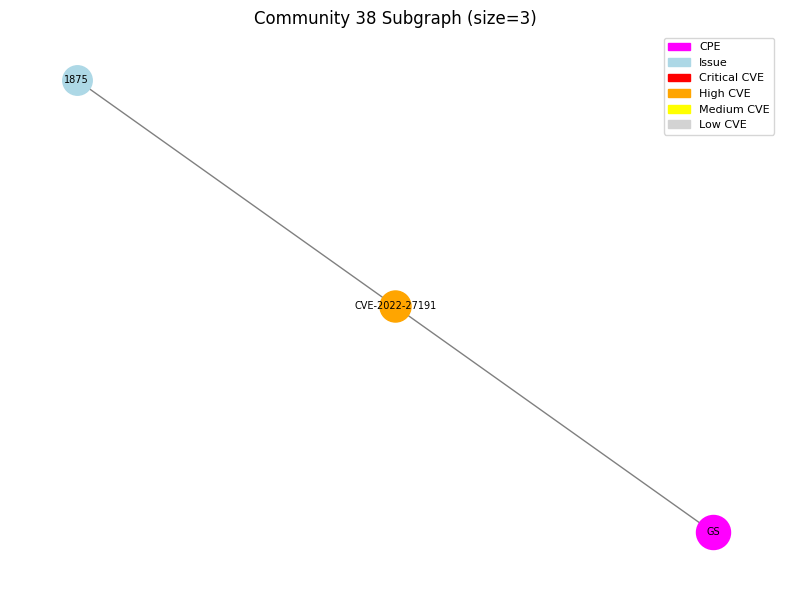

=== Community 39 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2022-40897 (type=CVE, degree=2)
CPEs in this community: ['PS']
CVEs in this community: ['CVE-2022-40897']
Issues in this community: ['29428']
=== End of Summary ===



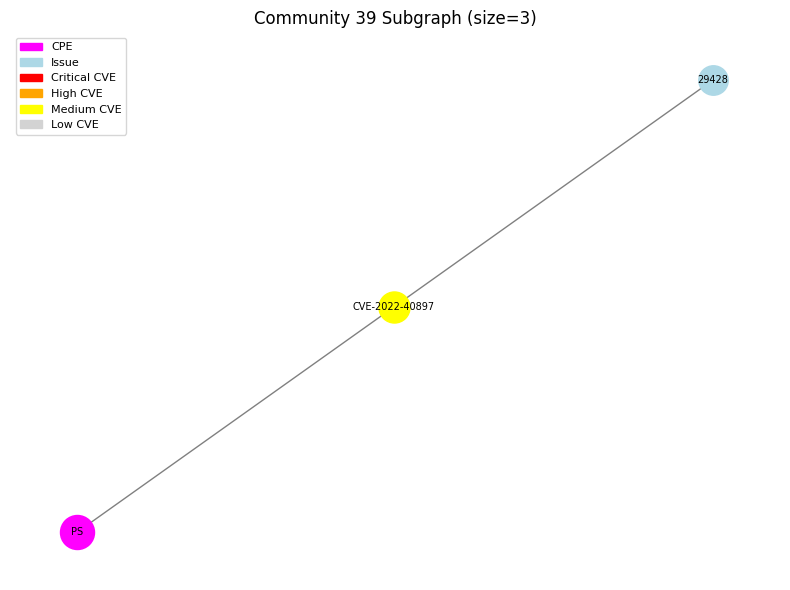

=== Community 40 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2023-30798 (type=CVE, degree=2)
CPEs in this community: ['ES']
CVEs in this community: ['CVE-2023-30798']
Issues in this community: ['17563']
=== End of Summary ===



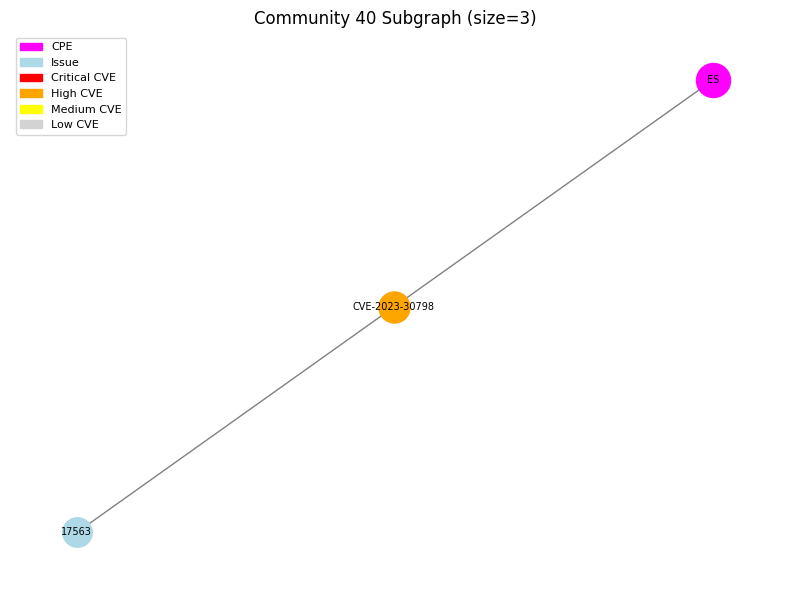

=== Community 41 Summary ===
Total Nodes: 2, Total Edges: 1
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: 539 (type=Issue, degree=1)
CPEs in this community: []
CVEs in this community: ['CVE-2021-25949']
Issues in this community: ['539']
=== End of Summary ===



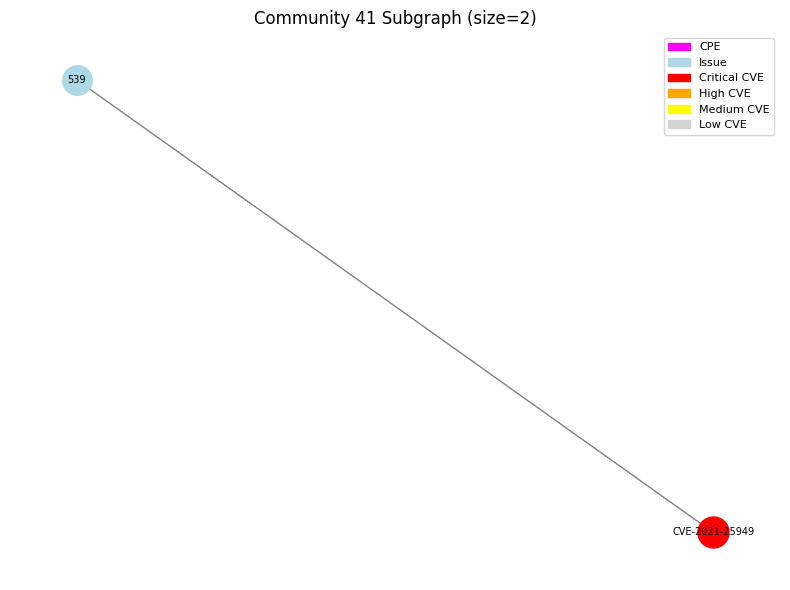

In [21]:
#!/usr/bin/env python3

import csv
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from networkx.algorithms import community

###############################################################################
# HELPER FUNCTIONS: SEVERITY & COLOR
###############################################################################

def worst_severity(sev_list):
    """
    Given a list of severities (e.g., ["critical","high","medium"]),
    returns the single 'worst' severity: 'critical' > 'high' > 'medium' > 'low'.
    """
    rank = {"critical": 4, "high": 3, "medium": 2, "low": 1}
    worst = "none"
    best_val = 0
    for s in sev_list:
        val = rank.get(s.lower(), 0)  # 0 if unknown
        if val > best_val:
            best_val = val
            worst = s.lower()
    return worst

def color_for_severity(severity):
    """
    Map a severity string to a color.
    """
    severity = severity.lower()
    if severity == "critical":
        return "red"
    elif severity == "high":
        return "orange"
    elif severity == "medium":
        return "yellow"
    elif severity == "low":
        return "lightgray"
    else:
        return "lavender"

###############################################################################
# STEP 1: BUILD THE DIRECTED GRAPH FROM CSV
###############################################################################

def build_directed_graph_from_csv(csv_file):
    """
    Reads 'issues2cve.csv' and builds a directed DiGraph with nodes of types:
      - CPE  (node_type="CPE")
      - CVE  (node_type="CVE")
      - Issue (node_type="Issue")

    Each row can have multiple CVEs and multiple Issues.  
    Edges (two-way):
      - (CPE)  --> (CVE)  (IS_VULNERABLE_TO)
      - (CVE)  --> (CPE)  (AFFECTS)
      - (CVE)  --> (Issue) (TRACKED_BY)
      - (Issue) --> (CVE)  (REFERENCES)
    We store severities as a list in each CVE node's attributes.
    """
    G = nx.DiGraph()

    with open(csv_file, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)

        for row in reader:
            cpe_name = row["CPE dependency name"].strip()
            cve_str  = row["CVE ID"].strip()
            issues_str = row["Issues"].strip()

            cve_ids = [c.strip() for c in cve_str.split(",") if c.strip()]
            issues_list = [i.strip() for i in issues_str.split(",") if i.strip()]

            # Parse severities (could be multiple, e.g. "critical, high")
            severity_str = row["CVE severity"].strip().lower()
            severity_list = [s.strip() for s in severity_str.split(",") if s.strip()]

            # We won't need these for community detection, but you might store them if you want
            occurrences = row["Number of CVE ID occurrences"].strip()
            num_issues = row["Number of Issues"].strip()

            # Ensure the CPE node is in the graph
            if not G.has_node(cpe_name):
                G.add_node(cpe_name, node_type="CPE")

            # For each CVE:
            for cve in cve_ids:
                if not G.has_node(cve):
                    G.add_node(cve, node_type="CVE", severity=severity_list)

                # Edge: CPE -> CVE
                if not G.has_edge(cpe_name, cve):
                    G.add_edge(cpe_name, cve, relation="IS_VULNERABLE_TO")
                # # Edge: CVE -> CPE
                # if not G.has_edge(cve, cpe_name):
                #     G.add_edge(cve, cpe_name, relation="AFFECTS")

                # CVE <-> Issues
                for issue in issues_list:
                    if not G.has_node(issue):
                        G.add_node(issue, node_type="Issue")

                    # CVE -> Issue
                    if not G.has_edge(cve, issue):
                        G.add_edge(cve, issue, relation="TRACKED_BY")
                    # # Issue -> CVE
                    # if not G.has_edge(issue, cve):
                    #     G.add_edge(issue, cve, relation="REFERENCES")

    return G

###############################################################################
# STEP 2: SUMMARIZE A COMMUNITY SUBGRAPH
###############################################################################

def summarize_community(subg, community_id):
    """
    Prints summary statistics about one subgraph (one community):
      - # of CPE, CVE, Issue nodes
      - severity distribution among CVEs
      - top (highest degree) node
      - actual node lists
    """
    # Partition nodes by type
    cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
    cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
    issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

    num_cpe   = len(cpe_nodes)
    num_cve   = len(cve_nodes)
    num_issue = len(issue_nodes)
    total_nodes = subg.number_of_nodes()
    total_edges = subg.number_of_edges()

    # Severity distribution among CVEs
    severity_count = {"critical": 0, "high": 0, "medium": 0, "low": 0}
    for cve in cve_nodes:
        sev_list = subg.nodes[cve].get("severity", [])
        for s in sev_list:
            s_lower = s.lower()
            if s_lower in severity_count:
                severity_count[s_lower] += 1

    # Highest degree node
    degrees = subg.degree()
    top_node, top_degree = max(degrees, key=lambda x: x[1])
    top_type = subg.nodes[top_node].get("node_type", "Unknown")

    print(f"=== Community {community_id} Summary ===")
    print(f"Total Nodes: {total_nodes}, Total Edges: {total_edges}")
    print(f"CPE Nodes: {num_cpe}, CVE Nodes: {num_cve}, Issue Nodes: {num_issue}")

    print("Severity Distribution (CVEs):")
    for sev, count in severity_count.items():
        print(f"  {sev.title()}: {count}")

    print(f"Highest degree node: {top_node} (type={top_type}, degree={top_degree})")
    print(f"CPEs in this community: {cpe_nodes}")
    print(f"CVEs in this community: {cve_nodes}")
    print(f"Issues in this community: {issue_nodes}")
    print("=== End of Summary ===\n")

###############################################################################
# STEP 3: DRAW A COMMUNITY SUBGRAPH
###############################################################################

def draw_community_subgraph(subg, community_id):
    """
    Draws the subgraph for a single community, color-coding nodes:
      - CPE (red)
      - CVE (by worst severity)
      - Issue (lightblue)
    """
    plt.figure(figsize=(8, 6))
    pos = nx.spring_layout(subg, k=0.5, seed=42)

    # Node lists
    cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
    cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
    issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

    # CPE in red
    nx.draw_networkx_nodes(subg, pos,
                           nodelist=cpe_nodes,
                           node_color="magenta",
                           node_size=600)

    # CVE color-coded by worst severity
    cve_colors = []
    for node in cve_nodes:
        sev_list = subg.nodes[node].get("severity", [])
        cve_colors.append(color_for_severity(worst_severity(sev_list)))

    nx.draw_networkx_nodes(subg, pos,
                           nodelist=cve_nodes,
                           node_color=cve_colors,
                           node_size=500)

    # Issues in lightblue
    nx.draw_networkx_nodes(subg, pos,
                           nodelist=issue_nodes,
                           node_color="lightblue",
                           node_size=450)

    # Edges in gray
    nx.draw_networkx_edges(subg, pos, edge_color="gray")

    # Node labels
    nx.draw_networkx_labels(subg, pos, font_size=7)

    # Legend
    red_patch      = mpatches.Patch(color='magenta',        label='CPE')
    lightblue_patch= mpatches.Patch(color='lightblue',  label='Issue')
    ccrit_patch    = mpatches.Patch(color='red',        label='Critical CVE')
    chigh_patch    = mpatches.Patch(color='orange',     label='High CVE')
    cmed_patch     = mpatches.Patch(color='yellow',     label='Medium CVE')
    clow_patch     = mpatches.Patch(color='lightgray',  label='Low CVE')

    plt.legend(handles=[red_patch, lightblue_patch, ccrit_patch, chigh_patch, cmed_patch, clow_patch],
               loc='best', fontsize=8)

    plt.title(f"Community {community_id} Subgraph (size={subg.number_of_nodes()})")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

###############################################################################
# STEP 4: MAIN WORKFLOW
###############################################################################

def main():
    csv_file = "./github-data/issues2cve.csv"  # your CSV file

    # 1) Build directed graph
    directed_graph = build_directed_graph_from_csv(csv_file)

    # 2) Convert to undirected for community detection
    undirected_graph = directed_graph.to_undirected()

    # 3) Run a community detection algorithm
    #    (greedy_modularity_communities returns a list of node sets)
    comms = community.greedy_modularity_communities(undirected_graph)

    # 4) Summarize and draw each community
    for idx, comm_set in enumerate(comms):
        # Extract subgraph for these nodes from the *undirected* graph
        subg = undirected_graph.subgraph(comm_set).copy()

        # Summarize
        summarize_community(subg, idx)

        # Draw the subgraph
        draw_community_subgraph(subg, idx)

if __name__ == "__main__":
    main()


## Summary
Below is a **conceptual framework** for summarizing each community—**what** to look for, and **how** to bring out meaningful insights about CPEs, CVEs, and Issues. We’ll also show a **sample code** snippet you can adapt to **compute** and **print** summary statistics for every community.

---

## 1) **What Is a Community in This Context?**

When you run a community detection algorithm on your **(CPE ↔ CVE ↔ Issues)** graph, each community is effectively a **cluster** of nodes. These nodes are often more tightly interlinked with each other than with nodes outside the community. Concretely, such a cluster might represent:

- A group of **CPE** dependencies that share certain **CVEs** in common  
- A cluster of **vulnerabilities** (CVEs) that are tracked by a similar set of **Issues**  
- Possibly a single CPE with many related CVEs and Issues, if it’s quite isolated.

---

## 2) **What Insights to Look For?**

Here are some **key questions** and **metrics** to highlight per community:

1. **Community Composition**  
   - **Count** how many CPE nodes, CVE nodes, and Issue nodes are in the community.  
   - This helps you see if a cluster is predominantly a single big CPE with many vulnerabilities, or multiple CPEs sharing common vulnerabilities.

2. **Severity Distribution**  
   - Among the CVE nodes in this community, how many are **critical**, **high**, **medium**, or **low**?  
   - Does the community revolve around mostly “critical” vulnerabilities that might need urgent attention?

3. **Top or Most Frequent CPE**  
   - If multiple CPE dependencies appear in a single community, which ones are **most connected**?  
   - You might find a certain library or product that is the “hub” of that cluster.

4. **Key Issues**  
   - Which Issues appear in this community? Possibly some Issues track many of these vulnerabilities, signifying a major bug/issue in a single place.  
   - If you store metadata on Issues (like open vs. closed), you can highlight whether these Issues are still open.

5. **Connectivity or Size**  
   - Size of the community (number of nodes total).  
   - Possibly, the **density** of the subgraph or the number of edges.  
   - If a community is extremely large, it might indicate a “common library” that fosters many vulnerabilities.  

6. **Potential Next Steps**  
   - If you find a cluster dominated by “critical” CVEs, it indicates a **priority** fix.  
   - If multiple CPEs share the same “critical” CVE, that might highlight a **common patch**.  
   - If certain Issues are linked to multiple CVEs in the same cluster, it might be an **umbrella** bug that needs more thorough triage.

---

## 3) **Example Code to Print Summaries**

Below is a small function you can integrate into your script. After detecting communities and creating each subgraph, you can call `summarize_community(subg, idx)` to print out some aggregated statistics.

### Summarize function

```python
def summarize_community(subg, community_id):
    """
    Prints summary statistics and insights for a single subgraph (community).
    """
    # 1) Count node types
    cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
    cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
    issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

    num_cpe   = len(cpe_nodes)
    num_cve   = len(cve_nodes)
    num_issue = len(issue_nodes)
    total_nodes = subg.number_of_nodes()
    total_edges = subg.number_of_edges()

    # 2) Severity distribution among CVEs
    severity_count = {"critical": 0, "high": 0, "medium": 0, "low": 0}
    for cve in cve_nodes:
        sev_list = subg.nodes[cve].get("severity", [])
        # might have multiple severities in one node. increment for each
        for s in sev_list:
            s_lower = s.lower()
            if s_lower in severity_count:
                severity_count[s_lower] += 1

    # 3) Possibly find the top connected CPE or CVE
    #    (which node has the largest degree in subg?)
    degrees = subg.degree()
    top_node, top_degree = max(degrees, key=lambda x: x[1])
    top_node_type = subg.nodes[top_node].get("node_type", "Unknown")

    # Print summary
    print(f"=== Community {community_id} Summary ===")
    print(f"Total Nodes: {total_nodes}, Total Edges: {total_edges}")
    print(f"CPE Nodes: {num_cpe}, CVE Nodes: {num_cve}, Issue Nodes: {num_issue}")

    print("Severity Distribution among CVEs:")
    for sev, count in severity_count.items():
        print(f"  {sev.title()}: {count}")

    print(f"Node with highest degree: {top_node} (type={top_node_type}, degree={top_degree})")

    # Optional: List actual CPEs or CVEs
    print(f"CPEs in this community: {cpe_nodes}")
    print(f"CVE in this community: {cve_nodes}")
    print(f"Issues in this community: {issue_nodes}")

    print("=== End of Summary ===\n")
```

### Integrating With Community Detection

In your **community detection** flow (like the one we wrote earlier), after you do:

```python
comms = community.greedy_modularity_communities(H)
for idx, comm_set in enumerate(comms):
    subg = H.subgraph(comm_set).copy()
    # Summarize
    summarize_community(subg, idx)
    # Then optionally draw subg...
```

You’ll get a textual print‐out summarizing each community’s composition, severities, top node by degree, etc.

---

## 4) **Sample Output / Interpretation**

A typical textual summary might look like:

```
=== Community 0 Summary ===
Total Nodes: 14, Total Edges: 25
CPE Nodes: 2, CVE Nodes: 9, Issue Nodes: 3
Severity Distribution among CVEs:
  Critical: 2
  High: 4
  Medium: 3
  Low: 0
Node with highest degree: CVE-2021-9999 (type=CVE, degree=8)
CPEs in this community: ['NU', 'AH']
CVE in this community: ['CVE-2021-1234','CVE-2021-2345', ... 'CVE-2021-9999']
Issues in this community: [29198, 1376, 52914]
=== End of Summary ===
```

**Interpretation**:
- This cluster has 2 **CPE** dependencies (`NU` and `AH`), 9 total **CVE** vulnerabilities, and 3 **Issues**.  
- Among the 9 CVEs, 2 are **critical** and 4 are **high**—**relatively severe** vulnerabilities.  
- A single CVE (`CVE-2021-9999`) has the highest degree, meaning it’s heavily connected—maybe it affects both CPEs and multiple Issues.  

You can quickly see this cluster might be a prime target for patching or more intense triage, especially if it’s loaded with critical/high CVEs.

---

## 5) **Beyond Basic Summaries**

You could enhance this analysis by:

- **Ranking** CVEs within a community by degree or betweenness centrality, to see which vulnerabilities are “connectivity hubs.”  
- Checking **open vs. closed** Issues if you track issue status.  
- Summarizing how many CPEs share the same vulnerability, revealing widely affecting CVEs.  
- If you store **CPE versions**, you can see which versions might be a “hot spot” in the cluster.

All these methods help you turn a raw “community” partition into an actionable, **meaningful** overview—**which** vulnerabilities are severe, **which** products are impacted, and **where** to focus effort.

---

### In Summary

1. **Detect** communities (e.g. via `greedy_modularity_communities`).  
2. **Extract** each community as a subgraph.  
3. **Compute** metrics: 
   - Node counts by type (CPE, CVE, Issue)  
   - Severity distribution  
   - Possibly top connected node or bridging node  
4. **Interpret** which CPEs are impacted, how serious the CVEs are, and whether the community represents a big problem or a smaller cluster.  

This approach transforms your raw graph partition into an **insightful** data narrative about your vulnerabilities, dependencies, and issues.

In [23]:
# import pandas as pd

# # Re-load the uploaded file
# file_path = 'issues.csv'

# # Read the CSV file
# df = pd.read_csv(file_path)

# # Extract issue numbers from the URLs in all columns
# def extract_issue_numbers(urls):
#     issue_numbers = []
#     if isinstance(urls, str):
#         for url in urls.split(','):
#             url = url.strip()
#             if 'issues/' in url:
#                 issue_number = url.split('issues/')[-1]
#                 if issue_number.isdigit():
#                     issue_numbers.append(issue_number)
#     return ', '.join(issue_numbers)

# # Apply the function to all columns
# for column in df.columns:
#     df[column] = df[column].apply(extract_issue_numbers)

# # Save the cleaned data to a new CSV file
# output_path = 'cleaned_issues.csv'
# df.to_csv(output_path, index=False)

# output_path


In [5]:
# import pandas as pd
# import networkx as nx
# import matplotlib.pyplot as plt

# # Load the dataset to extract relevant information
# file_path = 'cpe_dependency_report_issue.csv'
# df = pd.read_csv(file_path)

# df
# # # # Extract relevant columns for processing
# # # df = data[['CPE dependency name', 'CVE ID', 'CVE severity', 'Issues']]
# # Check for duplicates in the list of dependencies
# duplicates = df['CPE dependency name'].duplicated().sum()

# # Extract the duplicate entries for further analysis
# duplicate_entries = df[df['CPE dependency name'].duplicated(keep=False)]

# duplicates, duplicate_entries.head()


In [4]:
# # Generate acronyms programmatically based on the existing names in "CPE dependency name"
# # Limiting acronyms to 3 characters

# def generate_acronym(name):
#     """
#     Generate a 3-character acronym from a given dependency name.
#     Takes the first letters of the main components and joins them.
#     """
#     components = name.split(":")  # Split the name by ':'
#     acronym = "".join([comp[0].upper() for comp in components])[:3]  # Take first letters, up to 3 chars
#     return acronym

# # Apply the acronym generation to the column
# df['CPE dependency name'] = df['CPE dependency name'].apply(generate_acronym)

# df 


In [9]:
# # import pandas as pd
# # import networkx as nx
# # import matplotlib.pyplot as plt

# # # Load the dataset to extract relevant information
# # file_path = 'cpe_dependency_report_issue.csv'
# # data = pd.read_csv(file_path)

# # # Extract relevant columns for processing
# # data = data[['CPE dependency name', 'CVE ID', 'CVE severity', 'Issues']]
# data = df  
# # Cleaning and preparing data for visualization
# data = data.dropna()  # Drop rows with missing data
# data['CVE ID'] = data['CVE ID'].apply(lambda x: x.split(', '))  # Split CVE IDs into lists
# data['CVE severity'] = data['CVE severity'].apply(lambda x: x.split(', '))  # Split severities into lists
# data['Issues'] = data['Issues'].apply(lambda x: x.split(', '))  # Split issues into lists

# # Create a graph with relationships
# G = nx.DiGraph()

# # Adding nodes and edges
# for _, row in data.iterrows():
#     cpe = row['CPE dependency name']
#     for cve, severity, issue in zip(row['CVE ID'], row['CVE severity'], row['Issues']):
#         G.add_node(cpe, color='blue', type='CPE')  # Add CPE as blue nodes
#         G.add_node(cve, color='red', type='CVE')  # Add CVE as red nodes
#         G.add_node(issue, color='green', type='Issue')  # Add issues as green nodes
#         G.add_edge(cpe, cve)  # CPE to CVE relationship
#         G.add_edge(cve, issue)  # CVE to Issue relationship

# # Extract positions for vertical layout
# pos = {}
# y_position = {'CPE': 0, 'CVE': 1, 'Issue': 2}
# x_counter = {'CPE': 0, 'CVE': 0, 'Issue': 0}
# for node, attr in G.nodes(data=True):
#     node_type = attr['type']
#     pos[node] = (x_counter[node_type], y_position[node_type])
#     x_counter[node_type] += 1

# # Draw the graph with a vertical layout
# node_colors = [attr['color'] for _, attr in G.nodes(data=True)]
# plt.figure(figsize=(12, 8))
# nx.draw(G, pos, with_labels=True, node_color=node_colors, font_size=8, node_size=700)

# # Adding legend
# blue_patch = plt.Line2D([0], [0], marker='o', color='w', label='CPE (Blue)', markerfacecolor='blue', markersize=10)
# red_patch = plt.Line2D([0], [0], marker='o', color='w', label='CVE (Red)', markerfacecolor='red', markersize=10)
# green_patch = plt.Line2D([0], [0], marker='o', color='w', label='Issue (Green)', markerfacecolor='green', markersize=10)
# plt.legend(handles=[blue_patch, red_patch, green_patch], loc='best')

# # Display the graph
# plt.title("CPE-CVE-Issue Relationships")
# plt.show()


In [6]:
# import pandas as pd
# import networkx as nx
# import matplotlib.pyplot as plt

# # Load the dataset to extract relevant information
# file_path = 'cpe_dependency_report_issue.csv'
# data = pd.read_csv(file_path)

# # Extract relevant columns for processing
# data = data[['CVE ID', 'CVE severity', 'Issues']]

# # Cleaning and preparing data for visualization
# data = data.dropna()  # Drop rows with missing data
# data['CVE ID'] = data['CVE ID'].apply(lambda x: x.split(', '))  # Split CVE IDs into lists
# data['Issues'] = data['Issues'].apply(lambda x: x.split(', '))  # Split issues into lists

# # Create a graph with relationships
# G = nx.DiGraph()

# # Adding nodes and edges
# for _, row in data.iterrows():
#     for cve, issue in zip(row['CVE ID'], row['Issues']):
#         G.add_node(cve, color='red', type='CVE')  # Add CVE as red nodes
#         G.add_node(issue, color='green', type='Issue')  # Add issues as green nodes
#         G.add_edge(cve, issue)  # CVE to Issue relationship

# # Extract positions for vertical layout
# pos = {}
# y_position = {'CVE': 0, 'Issue': 1}
# x_counter = {'CVE': 0, 'Issue': 0}
# for node, attr in G.nodes(data=True):
#     node_type = attr['type']
#     pos[node] = (x_counter[node_type], y_position[node_type])
#     x_counter[node_type] += 1

# # Draw the graph with a vertical layout
# node_colors = [attr['color'] for _, attr in G.nodes(data=True)]
# plt.figure(figsize=(16, 10))
# nx.draw(G, pos, with_labels=True, node_color=node_colors, font_size=8, node_size=700)

# # Adding legend
# red_patch = plt.Line2D([0], [0], marker='o', color='w', label='CVE (Red)', markerfacecolor='red', markersize=10)
# green_patch = plt.Line2D([0], [0], marker='o', color='w', label='Issue (Green)', markerfacecolor='green', markersize=10)
# plt.legend(handles=[red_patch, green_patch], loc='best')

# # Display the graph
# plt.title("CVE-Issue Relationships")
# plt.show()


In [33]:
#df.to_csv('issues2cve.csv', index=False)

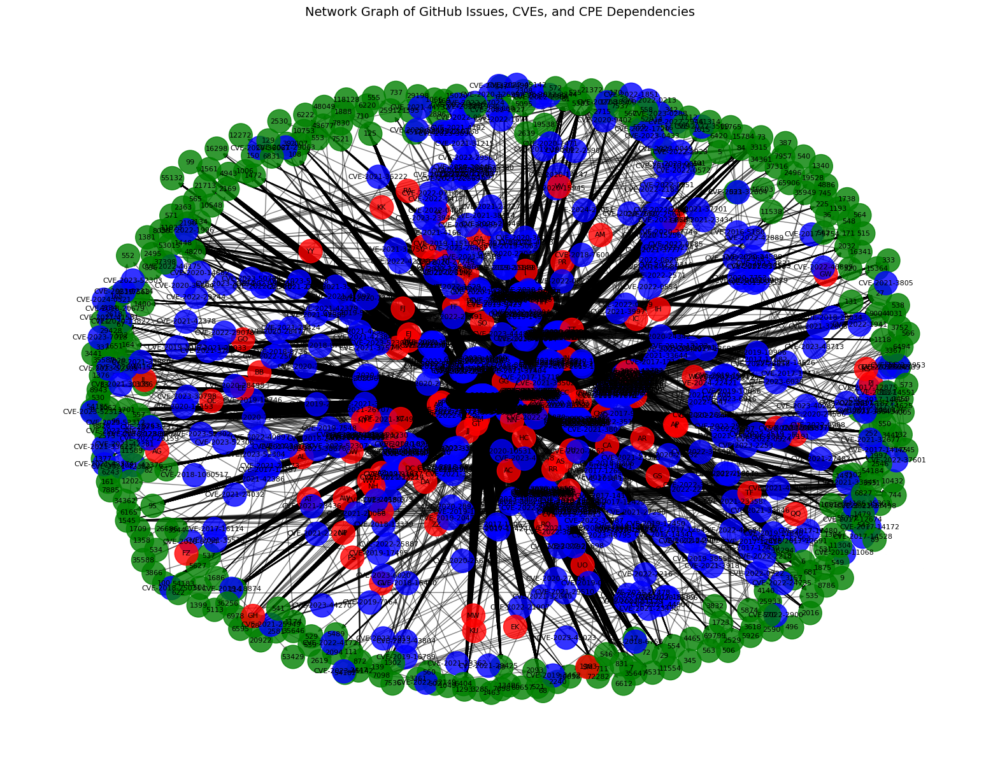

In [38]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the CSV data
file_path = "./github-data/issues2cve.csv"
data = pd.read_csv(file_path)

# Data cleaning and preparation
data['CVE ID'] = data['CVE ID'].str.split(', ')  # Split multiple CVEs into lists
data['CVE severity'] = data['CVE severity'].str.split(', ')  # Split multiple severities
data['Issues'] = data['Issues'].str.split(', ')  # Split multiple issues

# Initialize a directed graph
G = nx.DiGraph()

# Add nodes and edges to the graph
for _, row in data.iterrows():
    cpe_dependency = row['CPE dependency name']
    cve_ids = row['CVE ID']
    severities = row['CVE severity']
    issues = row['Issues']

    # Add the CPE dependency as a node
    G.add_node(cpe_dependency, type="CPE")

    # Add CVE nodes and link them to the CPE dependency
    if isinstance(cve_ids, list):
        for i, cve_id in enumerate(cve_ids):
            severity = severities[i] if i < len(severities) else "unknown"
            G.add_node(cve_id, type="CVE", severity=severity)
            G.add_edge(cpe_dependency, cve_id)

    # Add issue nodes and link them to the CVEs
    if isinstance(issues, list):
        for issue in issues:
            G.add_node(issue, type="Issue")
            for cve_id in cve_ids:
                G.add_edge(cve_id, issue)

# Visualize the graph
plt.figure(figsize=(20, 15))
pos = nx.spring_layout(G, k=0.15)  # Spring layout for better spacing

# Draw nodes with colors based on their type
node_colors = [
    'red' if G.nodes[node]['type'] == 'CPE' else
    'blue' if G.nodes[node]['type'] == 'CVE' else
    'green' for node in G.nodes()
]

nx.draw_networkx_nodes(G, pos, node_size=700, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, alpha=0.5)
nx.draw_networkx_labels(G, pos, font_size=8)

plt.title("Network Graph of GitHub Issues, CVEs, and CPE Dependencies", fontsize=14)
plt.axis("off")
plt.show()




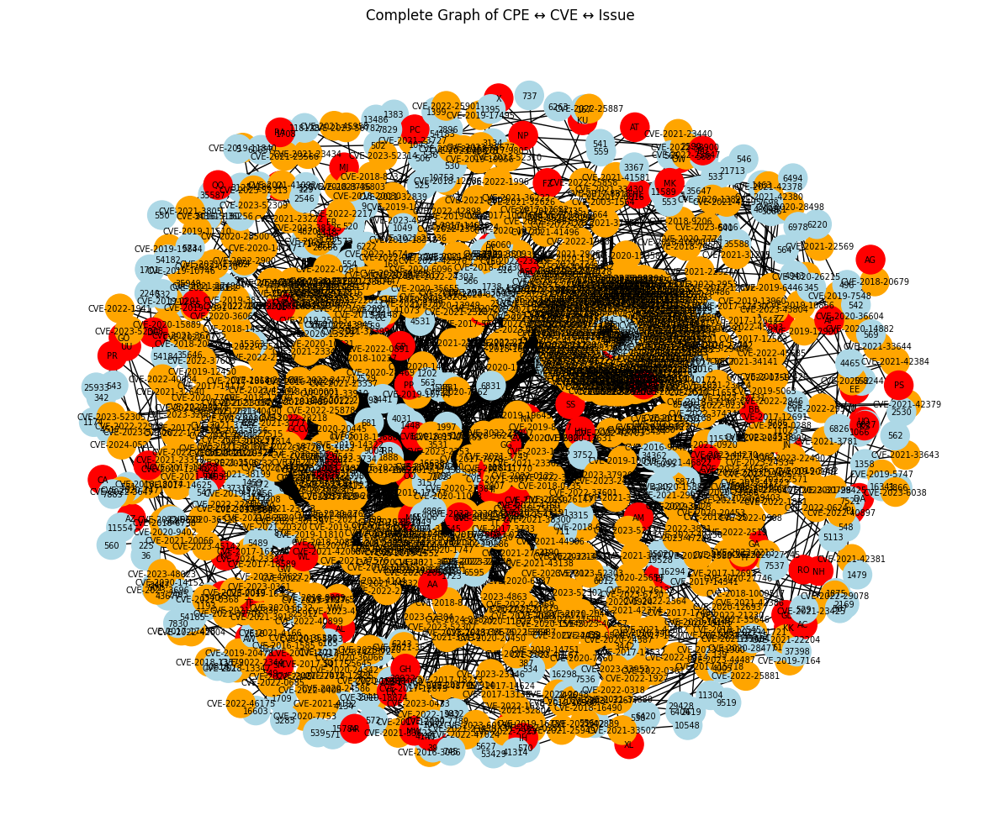

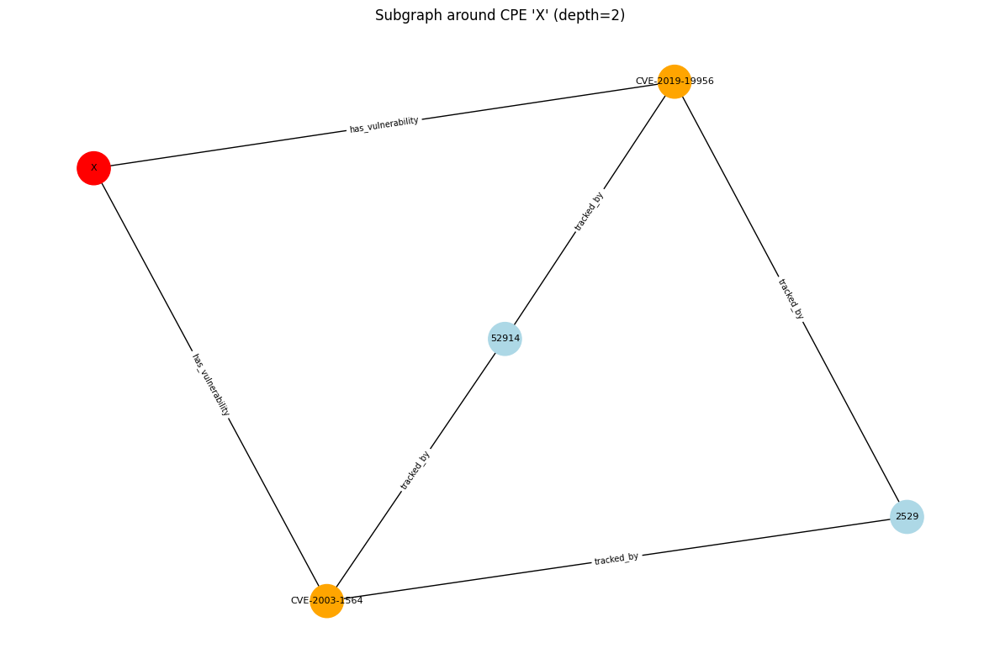

In [39]:
#!/usr/bin/env python3
"""
Complete solution code to parse a CSV of vulnerabilities and produce
a NetworkX graph showing relationships between CPE dependencies, CVEs, and Issues.
"""

import csv
import networkx as nx
import matplotlib.pyplot as plt

def build_graph_from_csv(csv_path):
    """
    Reads the CSV file and builds a graph where:
      - CPE dependency names are nodes (node_type="CPE")
      - CVEs are nodes (node_type="CVE")
      - Issues are nodes (node_type="Issue")
    
    Edges:
      - (CPE) -- has_vulnerability --> (CVE)
      - (CVE) -- tracked_by --> (Issue)
    """
    G = nx.Graph()

    with open(csv_path, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        
        for row in reader:
            # Read fields from the CSV
            cpe_name = row["CPE dependency name"].strip()
            cve_ids_str = row["CVE ID"].strip()
            # Some rows have multiple CVE IDs separated by commas
            # We'll split on ", " or (if needed) just "," 
            cve_ids = [c.strip() for c in cve_ids_str.split(",")]
            
            issues_str = row["Issues"].strip()
            issues_list = [i.strip() for i in issues_str.split(",")]
            
            severity_str = row["CVE severity"].strip()       # can be multiple severities: "critical, high, ..."
            severity_list = [s.strip() for s in severity_str.split(",")]
            
            occurrences = row["Number of CVE ID occurrences"].strip()
            num_issues = row["Number of Issues"].strip()

            # --- Add the CPE node ---
            if not G.has_node(cpe_name):
                G.add_node(
                    cpe_name,
                    node_type="CPE"
                )

            # --- For each CVE in this row ---
            for cve in cve_ids:
                if not G.has_node(cve):
                    # Store some attributes in the CVE node
                    # We could store all severities in a single attribute,
                    # or store them as a list
                    G.add_node(
                        cve,
                        node_type="CVE",
                        severity=severity_list,    # could also store severity_str directly
                        occurrences=occurrences
                    )
                
                # Add an edge from the CPE to the CVE
                if not G.has_edge(cpe_name, cve):
                    G.add_edge(
                        cpe_name, 
                        cve, 
                        relation="has_vulnerability"
                    )

                # --- Link each CVE to its issues ---
                for issue in issues_list:
                    if not G.has_node(issue):
                        G.add_node(issue, node_type="Issue")
                    # Add edge from CVE to the Issue
                    if not G.has_edge(cve, issue):
                        G.add_edge(cve, issue, relation="tracked_by")

    return G

def draw_entire_graph(G):
    """
    Draws the entire graph, color‐coding nodes by their 'node_type'.
    For large graphs, this can be quite cluttered. 
    """
    plt.figure(figsize=(12, 10))

    # Spring layout or any other layout
    pos = nx.spring_layout(G, k=0.3, seed=42)  

    # Color nodes by type
    color_map = []
    for node, data in G.nodes(data=True):
        if data["node_type"] == "CPE":
            color_map.append("red")
        elif data["node_type"] == "CVE":
            color_map.append("orange")
        elif data["node_type"] == "Issue":
            color_map.append("lightblue")
        else:
            color_map.append("gray")

    nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=600)
    nx.draw_networkx_edges(G, pos)
    nx.draw_networkx_labels(G, pos, font_size=7)
    
    # Optionally draw edge labels
    # edge_labels = nx.get_edge_attributes(G, 'relation')
    # nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=6)

    plt.title("Complete Graph of CPE ↔ CVE ↔ Issue")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

def draw_subgraph_around_cpe(G, cpe_name, depth=2):
    """
    Draws a smaller neighborhood subgraph around a specified CPE node.
    `depth=2` means: the node, its neighbors, and the neighbors’ neighbors.
    This helps keep the visualization manageable.
    """
    if cpe_name not in G:
        print(f"CPE '{cpe_name}' not found in the graph.")
        return

    # We'll do a BFS (breadth-first search) out to the given depth 
    # from the specified CPE node:
    nodes_to_visit = {cpe_name}
    visited = set()
    current_depth = 0

    subgraph_nodes = set()

    while nodes_to_visit and current_depth <= depth:
        next_level = set()
        for node in nodes_to_visit:
            if node not in visited:
                visited.add(node)
                subgraph_nodes.add(node)
                for neighbor in G.neighbors(node):
                    if neighbor not in visited:
                        next_level.add(neighbor)
        nodes_to_visit = next_level
        current_depth += 1

    H = G.subgraph(subgraph_nodes)

    plt.figure(figsize=(12, 8))
    pos = nx.spring_layout(H, k=0.3, seed=42)  

    # Color nodes by type
    color_map = []
    for node, data in H.nodes(data=True):
        if data["node_type"] == "CPE":
            color_map.append("red")
        elif data["node_type"] == "CVE":
            color_map.append("orange")
        elif data["node_type"] == "Issue":
            color_map.append("lightblue")
        else:
            color_map.append("gray")

    nx.draw_networkx_nodes(H, pos, node_color=color_map, node_size=800)
    nx.draw_networkx_edges(H, pos)
    nx.draw_networkx_labels(H, pos, font_size=8)

    edge_labels = nx.get_edge_attributes(H, 'relation')
    nx.draw_networkx_edge_labels(H, pos, edge_labels=edge_labels, font_size=7)

    plt.title(f"Subgraph around CPE '{cpe_name}' (depth={depth})")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

def main():
    # Path to your CSV file
    csv_file = "issues2cve.csv"

    # 1) Build the graph from CSV
    graph = build_graph_from_csv(csv_file)

    # 2) Option A: Draw the entire graph (may be very busy if large)
    draw_entire_graph(graph)

    # 3) Option B: Draw a subgraph around a specific CPE node
    #    Change 'X' to any known CPE name from your CSV, e.g. "OO", "LL", etc.
    draw_subgraph_around_cpe(graph, cpe_name="X", depth=2)

if __name__ == "__main__":
    main()



### How it Works

1. **build_graph_from_csv(csv_path)**  
   - Opens the CSV file using `csv.DictReader`.  
   - Loops through each row, extracting:
     - **CPE dependency name** (a single string).  
     - **CVE ID** (possibly multiple, split by comma).  
     - **Issues** (possibly multiple).  
     - **Severity** (could also be multiple severities).  
     - etc.  
   - Adds **CPE** nodes, **CVE** nodes, and **Issue** nodes to the graph.  
   - Adds edges:  
     - `(CPE) --has_vulnerability--> (CVE)`  
     - `(CVE) --tracked_by--> (Issue)`  

2. **draw_entire_graph(G)**  
   - Draws the entire graph with a basic spring layout.  
   - Colors nodes by `node_type`.  
   - This can become cluttered for big datasets.  

3. **draw_subgraph_around_cpe(G, cpe_name, depth)**  
   - Extracts a smaller “BFS neighborhood” subgraph centered on one CPE node out to a given depth.  
   - This is useful to visualize a local portion of the graph.  

4. **main()**  
   - Calls the above functions, drawing both the entire graph and an example subgraph.  
   - Adjust or remove whichever function calls you prefer.  

**That’s it!** This script gives you a starting point for analyzing and visualizing the relationships among CPE dependencies, CVEs, and Issues from your CSV. Feel free to adapt or expand these functions as needed for your own use case.

2) What Insights to Look For?
Here are some key questions and metrics to highlight per community:

Community Composition

Count how many CPE nodes, CVE nodes, and Issue nodes are in the community.
This helps you see if a cluster is predominantly a single big CPE with many vulnerabilities, or multiple CPEs sharing common vulnerabilities.
Severity Distribution

Among the CVE nodes in this community, how many are critical, high, medium, or low?
Does the community revolve around mostly “critical” vulnerabilities that might need urgent attention?
Top or Most Frequent CPE

If multiple CPE dependencies appear in a single community, which ones are most connected?
You might find a certain library or product that is the “hub” of that cluster.
Key Issues

Which Issues appear in this community? Possibly some Issues track many of these vulnerabilities, signifying a major bug/issue in a single place.
If you store metadata on Issues (like open vs. closed), you can highlight whether these Issues are still open.
Connectivity or Size

Size of the community (number of nodes total).
Possibly, the density of the subgraph or the number of edges.
If a community is extremely large, it might indicate a “common library” that fosters many vulnerabilities.
Potential Next Steps

If you find a cluster dominated by “critical” CVEs, it indicates a priority fix.
If multiple CPEs share the same “critical” CVE, that might highlight a common patch.
If certain Issues are linked to multiple CVEs in the same cluster, it might be an umbrella bug that needs more thorough triage.

In [ ]:
#!/usr/bin/env python3

import csv
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from networkx.algorithms import community

###############################################################################
# HELPER FUNCTIONS: SEVERITY & COLOR
###############################################################################

def worst_severity(sev_list):
    """
    Given a list of severities (e.g., ["critical","high","medium"]),
    returns the single 'worst' severity: 'critical' > 'high' > 'medium' > 'low'.
    """
    rank = {"critical": 4, "high": 3, "medium": 2, "low": 1}
    worst = "none"
    best_val = 0
    for s in sev_list:
        val = rank.get(s.lower(), 0)  # 0 if unknown
        if val > best_val:
            best_val = val
            worst = s.lower()
    return worst

def color_for_severity(severity):
    """
    Map a severity string to a color.
    """
    severity = severity.lower()
    if severity == "critical":
        return "red"
    elif severity == "high":
        return "orange"
    elif severity == "medium":
        return "yellow"
    elif severity == "low":
        return "lightgray"
    else:
        return "lavender"

###############################################################################
# STEP 1: BUILD THE DIRECTED GRAPH FROM CSV
###############################################################################

def build_directed_graph_from_csv(csv_file):
    """
    Reads 'issues2cve.csv' and builds a directed DiGraph with nodes of types:
      - CPE  (node_type="CPE")
      - CVE  (node_type="CVE")
      - Issue (node_type="Issue")

    Each row can have multiple CVEs and multiple Issues.  
    Edges (two-way):
      - (CPE)  --> (CVE)  (IS_VULNERABLE_TO)
      - (CVE)  --> (CPE)  (AFFECTS)
      - (CVE)  --> (Issue) (TRACKED_BY)
      - (Issue) --> (CVE)  (REFERENCES)
    We store severities as a list in each CVE node's attributes.
    """
    G = nx.DiGraph()

    with open(csv_file, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)

        for row in reader:
            cpe_name = row["CPE dependency name"].strip()
            cve_str  = row["CVE ID"].strip()
            issues_str = row["Issues"].strip()

            cve_ids = [c.strip() for c in cve_str.split(",") if c.strip()]
            issues_list = [i.strip() for i in issues_str.split(",") if i.strip()]

            # Parse severities (could be multiple, e.g. "critical, high")
            severity_str = row["CVE severity"].strip().lower()
            severity_list = [s.strip() for s in severity_str.split(",") if s.strip()]

            # We won't need these for community detection, but you might store them if you want
            occurrences = row["Number of CVE ID occurrences"].strip()
            num_issues = row["Number of Issues"].strip()

            # Ensure the CPE node is in the graph
            if not G.has_node(cpe_name):
                G.add_node(cpe_name, node_type="CPE")

            # For each CVE:
            for cve in cve_ids:
                if not G.has_node(cve):
                    G.add_node(cve, node_type="CVE", severity=severity_list)

                # Edge: CPE -> CVE
                if not G.has_edge(cpe_name, cve):
                    G.add_edge(cpe_name, cve, relation="IS_VULNERABLE_TO")
                # # Edge: CVE -> CPE
                # if not G.has_edge(cve, cpe_name):
                #     G.add_edge(cve, cpe_name, relation="AFFECTS")

                # CVE <-> Issues
                for issue in issues_list:
                    if not G.has_node(issue):
                        G.add_node(issue, node_type="Issue")

                    # CVE -> Issue
                    if not G.has_edge(cve, issue):
                        G.add_edge(cve, issue, relation="TRACKED_BY")
                    # # Issue -> CVE
                    # if not G.has_edge(issue, cve):
                    #     G.add_edge(issue, cve, relation="REFERENCES")

    return G

###############################################################################
# STEP 2: SUMMARIZE A COMMUNITY SUBGRAPH
###############################################################################

def summarize_community(subg, community_id):
    """
    Prints summary statistics about one subgraph (one community):
      - # of CPE, CVE, Issue nodes
      - severity distribution among CVEs
      - top (highest degree) node
      - actual node lists
    """
    # Partition nodes by type
    cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
    cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
    issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

    num_cpe   = len(cpe_nodes)
    num_cve   = len(cve_nodes)
    num_issue = len(issue_nodes)
    total_nodes = subg.number_of_nodes()
    total_edges = subg.number_of_edges()

    # Severity distribution among CVEs
    severity_count = {"critical": 0, "high": 0, "medium": 0, "low": 0}
    for cve in cve_nodes:
        sev_list = subg.nodes[cve].get("severity", [])
        for s in sev_list:
            s_lower = s.lower()
            if s_lower in severity_count:
                severity_count[s_lower] += 1

    # Highest degree node
    degrees = subg.degree()
    top_node, top_degree = max(degrees, key=lambda x: x[1])
    top_type = subg.nodes[top_node].get("node_type", "Unknown")

    print(f"=== Community {community_id} Summary ===")
    print(f"Total Nodes: {total_nodes}, Total Edges: {total_edges}")
    print(f"CPE Nodes: {num_cpe}, CVE Nodes: {num_cve}, Issue Nodes: {num_issue}")

    print("Severity Distribution (CVEs):")
    for sev, count in severity_count.items():
        print(f"  {sev.title()}: {count}")

    print(f"Highest degree node: {top_node} (type={top_type}, degree={top_degree})")
    print(f"CPEs in this community: {cpe_nodes}")
    print(f"CVEs in this community: {cve_nodes}")
    print(f"Issues in this community: {issue_nodes}")
    print("=== End of Summary ===\n")

###############################################################################
# STEP 3: DRAW A COMMUNITY SUBGRAPH
###############################################################################

def draw_community_subgraph(subg, community_id):
    """
    Draws the subgraph for a single community, color-coding nodes:
      - CPE (red)
      - CVE (by worst severity)
      - Issue (lightblue)
    """
    plt.figure(figsize=(8, 6))
    pos = nx.spring_layout(subg, k=0.5, seed=42)

    # Node lists
    cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
    cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
    issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

    # CPE in red
    nx.draw_networkx_nodes(subg, pos,
                           nodelist=cpe_nodes,
                           node_color="magenta",
                           node_size=600)

    # CVE color-coded by worst severity
    cve_colors = []
    for node in cve_nodes:
        sev_list = subg.nodes[node].get("severity", [])
        cve_colors.append(color_for_severity(worst_severity(sev_list)))

    nx.draw_networkx_nodes(subg, pos,
                           nodelist=cve_nodes,
                           node_color=cve_colors,
                           node_size=500)

    # Issues in lightblue
    nx.draw_networkx_nodes(subg, pos,
                           nodelist=issue_nodes,
                           node_color="lightblue",
                           node_size=450)

    # Edges in gray
    nx.draw_networkx_edges(subg, pos, edge_color="gray")

    # Node labels
    nx.draw_networkx_labels(subg, pos, font_size=7)

    # Legend
    red_patch      = mpatches.Patch(color='magenta',        label='CPE')
    lightblue_patch= mpatches.Patch(color='lightblue',  label='Issue')
    ccrit_patch    = mpatches.Patch(color='red',        label='Critical CVE')
    chigh_patch    = mpatches.Patch(color='orange',     label='High CVE')
    cmed_patch     = mpatches.Patch(color='yellow',     label='Medium CVE')
    clow_patch     = mpatches.Patch(color='lightgray',  label='Low CVE')

    plt.legend(handles=[red_patch, lightblue_patch, ccrit_patch, chigh_patch, cmed_patch, clow_patch],
               loc='best', fontsize=8)

    plt.title(f"Community {community_id} Subgraph (size={subg.number_of_nodes()})")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

###############################################################################
# STEP 4: MAIN WORKFLOW
###############################################################################


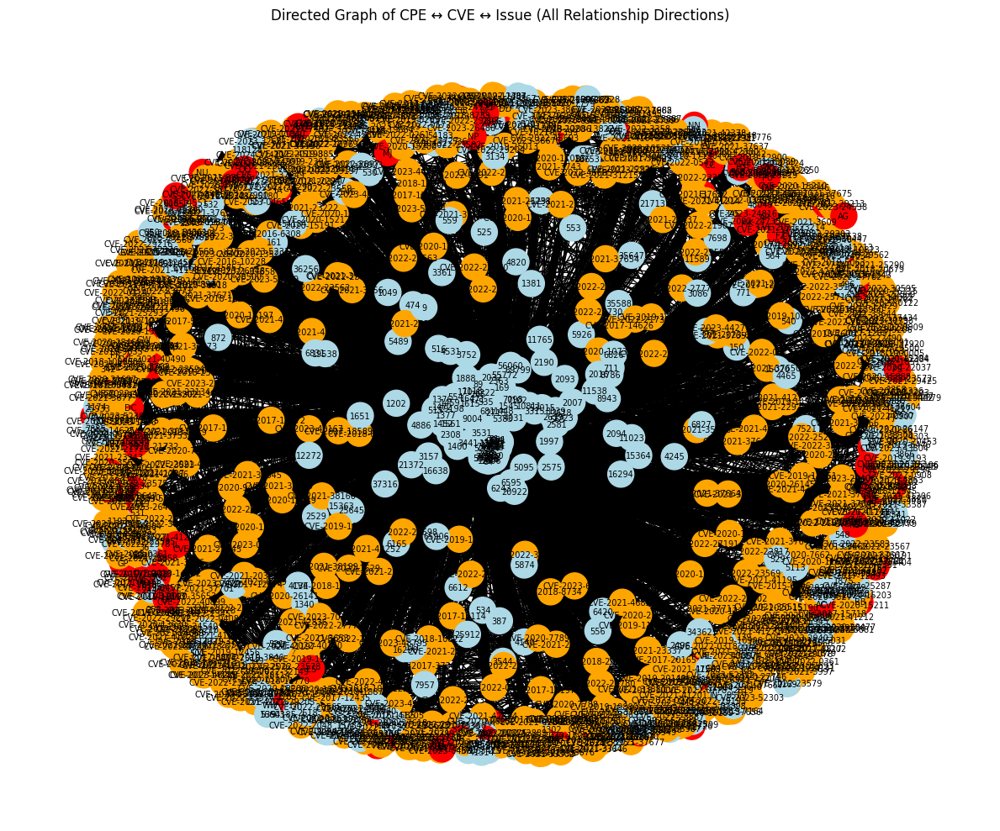

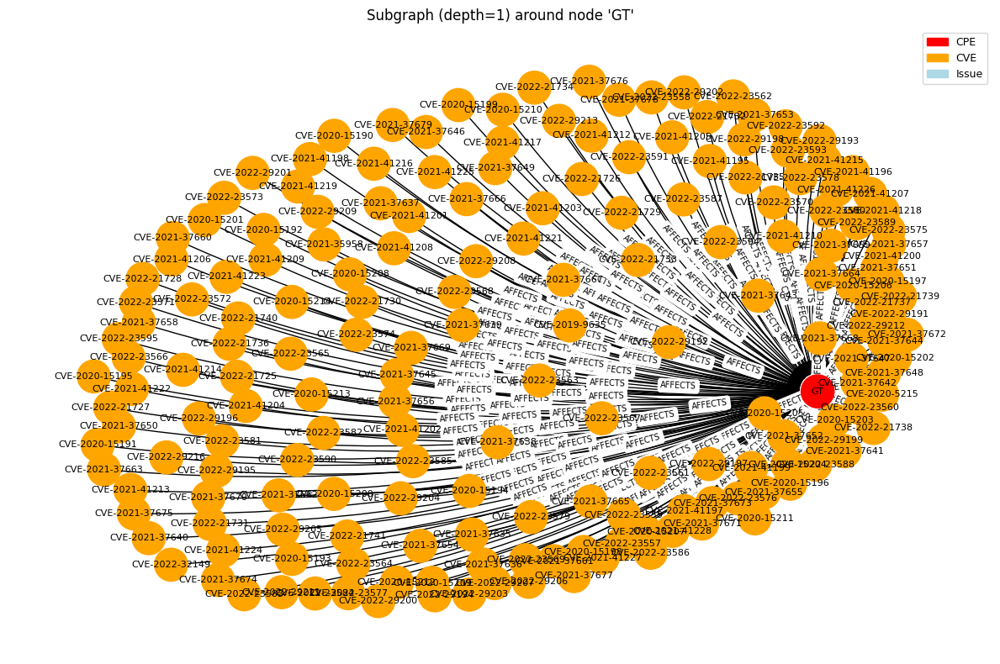

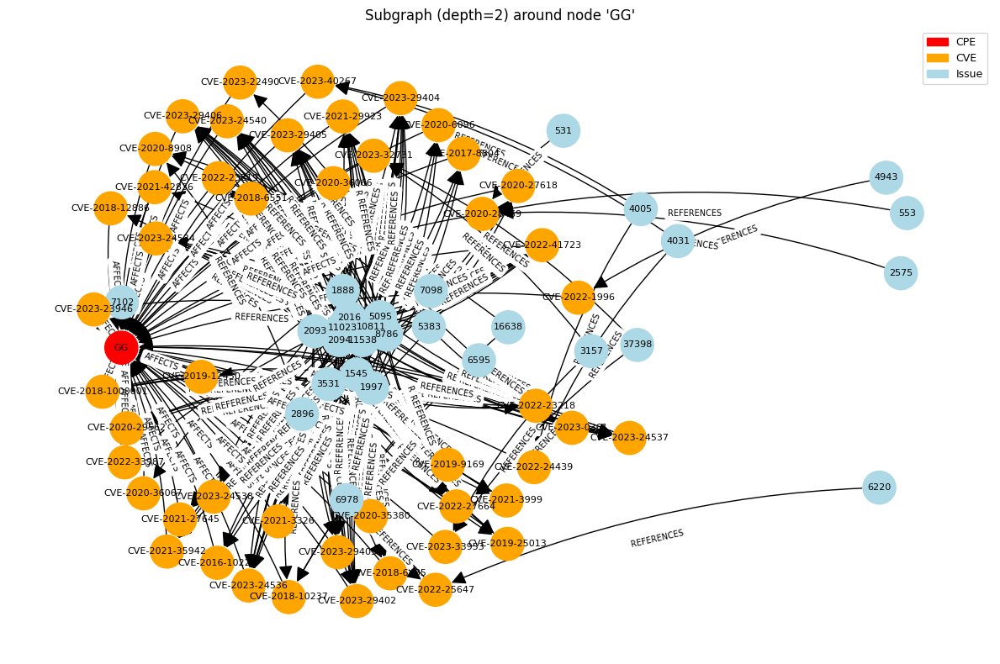

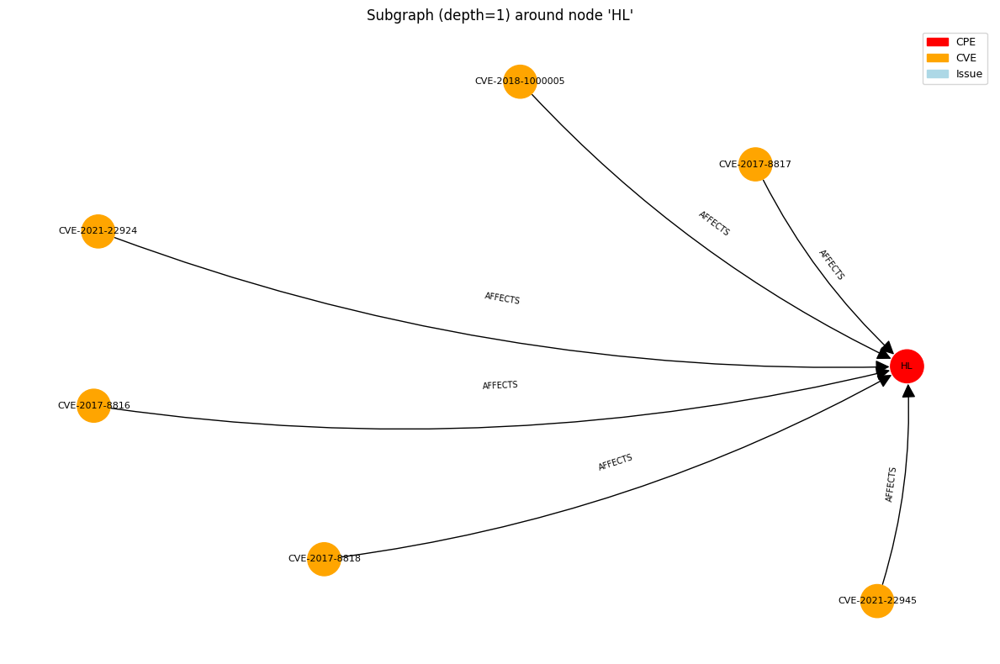

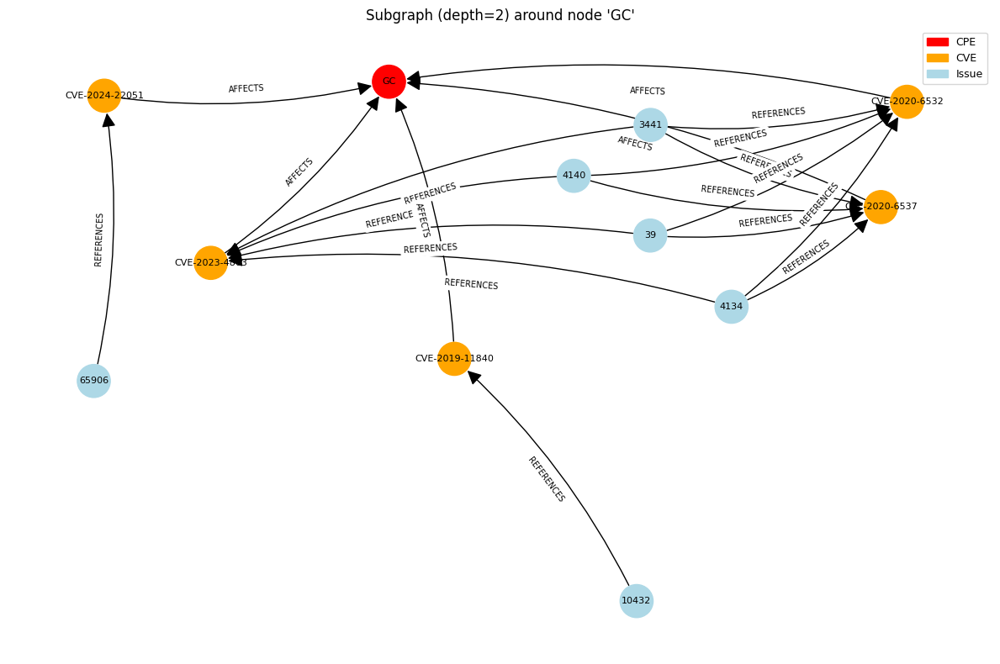

=== Community 0 Summary ===
Total Nodes: 466, Total Edges: 1633
CPE Nodes: 35, CVE Nodes: 352, Issue Nodes: 79
Severity Distribution (CVEs):
  Critical: 216
  High: 305
  Medium: 251
  Low: 102
Highest degree node: 1448 (type=Issue, degree=121)
CPEs in this community: ['DF', 'GL', 'GW', 'DD', 'VV', 'DA', 'BB', 'CA', 'OO', 'KU', 'AG', 'XL', 'KC', 'CC', 'QQ', 'FF', 'MK', 'SM', 'II', 'LL', 'KS', 'RR', 'NT', 'EK', 'AR', 'NU', 'OL', 'DC', 'ZZ', 'WL', 'GA', 'TT', 'FR', 'UO', 'GG']
CVEs in this community: ['CVE-2022-3786', 'CVE-2021-27500', 'CVE-2016-7054', 'CVE-2017-12435', 'CVE-2017-18271', 'CVE-2022-0318', 'CVE-2023-48795', 'CVE-2022-0714', 'CVE-2020-21688', 'CVE-2022-37603', 'CVE-2022-0572', 'CVE-2022-0351', 'CVE-2021-27645', 'CVE-2018-12930', 'CVE-2018-6551', 'CVE-2023-33953', 'CVE-2023-48713', 'CVE-2019-19844', 'CVE-2021-40490', 'CVE-2021-32626', 'CVE-2019-8980', 'CVE-2021-27498', 'CVE-2020-20445', 'CVE-2021-42379', 'CVE-2021-32839', 'CVE-2021-0920', 'CVE-2017-3738', 'CVE-2021-32804', '

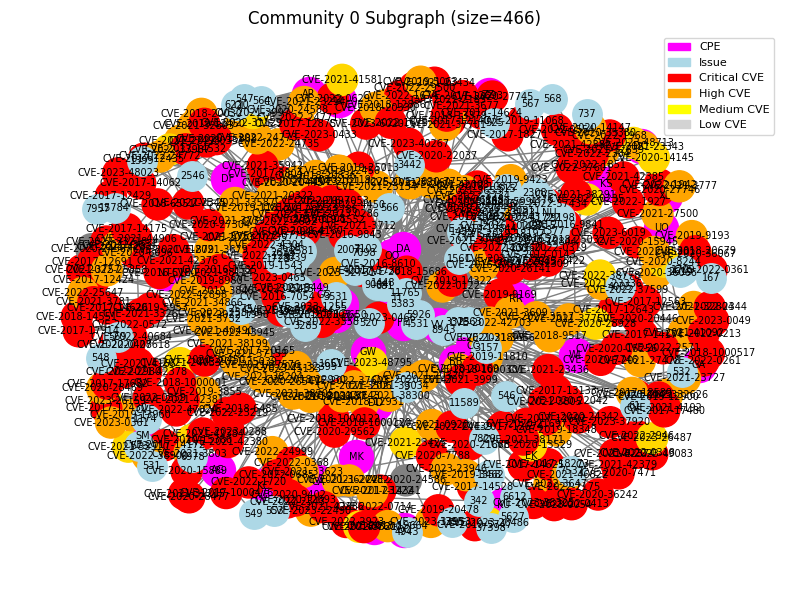

=== Community 1 Summary ===
Total Nodes: 265, Total Edges: 7450
CPE Nodes: 4, CVE Nodes: 216, Issue Nodes: 45
Severity Distribution (CVEs):
  Critical: 213
  High: 212
  Medium: 211
  Low: 0
Highest degree node: 29 (type=Issue, degree=203)
CPEs in this community: ['GT', 'SS', 'X', 'AS']
CVEs in this community: ['CVE-2021-37646', 'CVE-2021-37659', 'CVE-2021-37670', 'CVE-2022-23587', 'CVE-2021-41206', 'CVE-2022-29201', 'CVE-2021-37655', 'CVE-2022-29195', 'CVE-2021-37669', 'CVE-2021-37638', 'CVE-2022-23582', 'CVE-2021-37661', 'CVE-2021-37649', 'CVE-2022-29194', 'CVE-2022-23565', 'CVE-2022-23569', 'CVE-2020-15358', 'CVE-2021-41198', 'CVE-2021-41207', 'CVE-2022-29205', 'CVE-2021-41214', 'CVE-2020-15201', 'CVE-2021-41208', 'CVE-2021-37639', 'CVE-2021-41218', 'CVE-2019-16168', 'CVE-2021-37636', 'CVE-2022-23592', 'CVE-2022-29216', 'CVE-2022-21727', 'CVE-2020-15210', 'CVE-2022-29204', 'CVE-2022-29209', 'CVE-2022-23574', 'CVE-2020-15203', 'CVE-2020-15190', 'CVE-2019-19956', 'CVE-2020-13631', 'CV

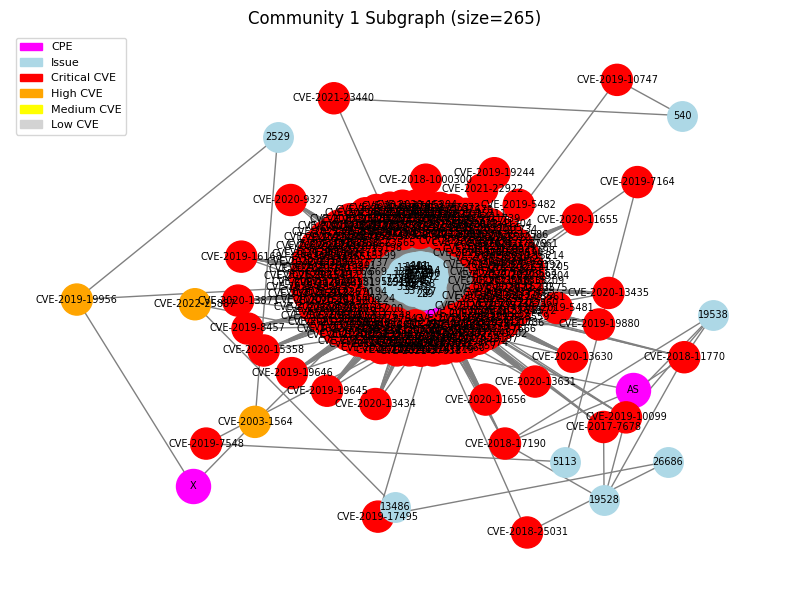

=== Community 2 Summary ===
Total Nodes: 125, Total Edges: 473
CPE Nodes: 7, CVE Nodes: 79, Issue Nodes: 39
Severity Distribution (CVEs):
  Critical: 50
  High: 70
  Medium: 41
  Low: 0
Highest degree node: PP (type=CPE, degree=57)
CPEs in this community: ['PP', 'HT', 'GC', 'RA', 'AA', 'TF', 'JN']
CVEs in this community: ['CVE-2022-45198', 'CVE-2020-6537', 'CVE-2022-0722', 'CVE-2021-28675', 'CVE-2022-24303', 'CVE-2024-22421', 'CVE-2023-52304', 'CVE-2023-44271', 'CVE-2021-32677', 'CVE-2023-52308', 'CVE-2024-22051', 'CVE-2019-18874', 'CVE-2023-52306', 'CVE-2020-14343', 'CVE-2023-52302', 'CVE-2023-7018', 'CVE-2022-0624', 'CVE-2023-6730', 'CVE-2023-4863', 'CVE-2023-52311', 'CVE-2021-25289', 'CVE-2021-25291', 'CVE-2022-30595', 'CVE-2019-10856', 'CVE-2021-25287', 'CVE-2022-2217', 'CVE-2022-2216', 'CVE-2023-50447', 'CVE-2021-3749', 'CVE-2021-25292', 'CVE-2022-42969', 'CVE-2022-40899', 'CVE-2021-29510', 'CVE-2021-23424', 'CVE-2022-22815', 'CVE-2021-3807', 'CVE-2023-52314', 'CVE-2023-38678', 'C

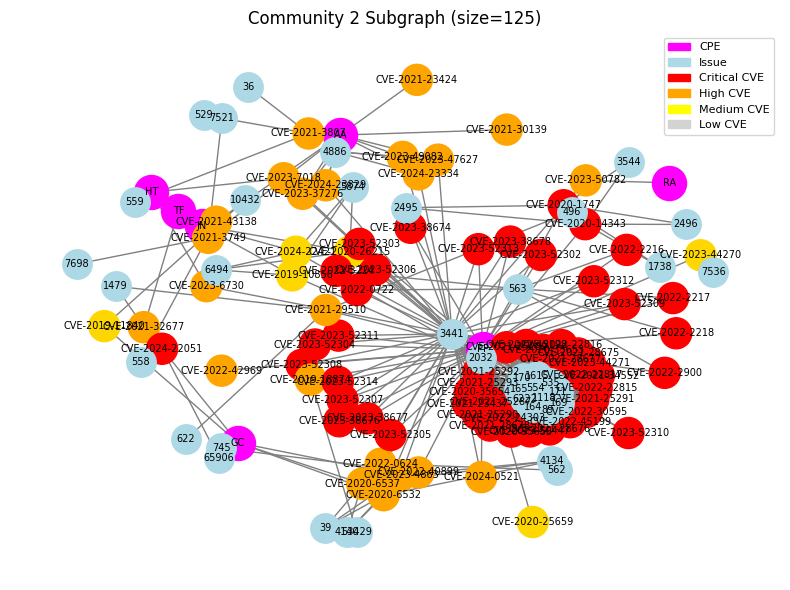

=== Community 3 Summary ===
Total Nodes: 67, Total Edges: 158
CPE Nodes: 9, CVE Nodes: 37, Issue Nodes: 21
Severity Distribution (CVEs):
  Critical: 17
  High: 29
  Medium: 28
  Low: 2
Highest degree node: 6595 (type=Issue, degree=22)
CPEs in this community: ['AC', 'AH', 'GP', 'GO', 'AL', 'IH', 'FJ', 'SO', 'EJ']
CVEs in this community: ['CVE-2019-10172', 'CVE-2018-12545', 'CVE-2023-44487', 'CVE-2019-17571', 'CVE-2020-36518', 'CVE-2021-44832', 'CVE-2017-15713', 'CVE-2019-14540', 'CVE-2023-26048', 'CVE-2021-35515', 'CVE-2021-22573', 'CVE-2020-8908', 'CVE-2022-42889', 'CVE-2023-40167', 'CVE-2021-37404', 'CVE-2023-41900', 'CVE-2021-22569', 'CVE-2022-21230', 'CVE-2022-2048', 'CVE-2022-3509', 'CVE-2018-10237', 'CVE-2022-23305', 'CVE-2021-44228', 'CVE-2021-4104', 'CVE-2022-25857', 'CVE-2017-12197', 'CVE-2017-15718', 'CVE-2021-29425', 'CVE-2018-8009', 'CVE-2022-1941', 'CVE-2019-12814', 'CVE-2022-42004', 'CVE-2016-3086', 'CVE-2016-2402', 'CVE-2019-16335', 'CVE-2022-23302', 'CVE-2017-18640']
Iss

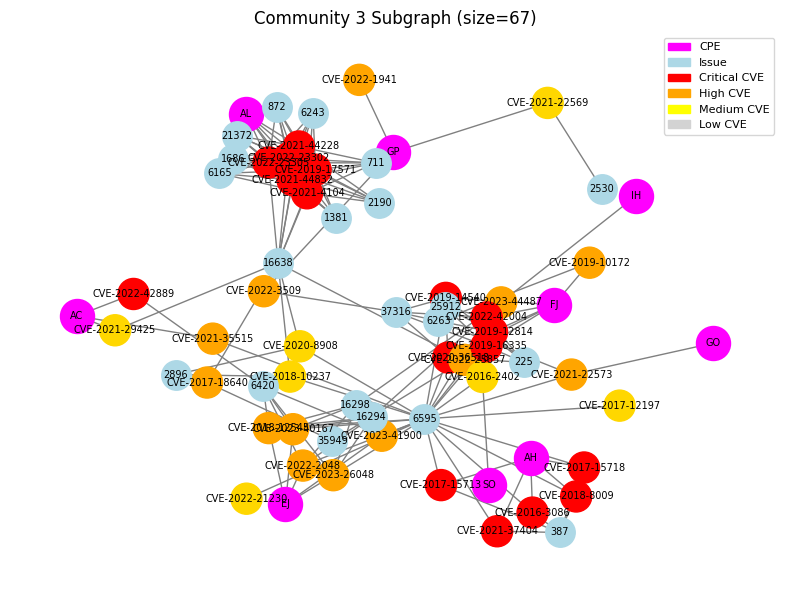

=== Community 4 Summary ===
Total Nodes: 56, Total Edges: 151
CPE Nodes: 3, CVE Nodes: 33, Issue Nodes: 20
Severity Distribution (CVEs):
  Critical: 22
  High: 24
  Medium: 22
  Low: 0
Highest degree node: 2016 (type=Issue, degree=18)
CPEs in this community: ['RO', 'GH', 'NN']
CVEs in this community: ['CVE-2023-24534', 'CVE-2023-29405', 'CVE-2021-3580', 'CVE-2020-26139', 'CVE-2023-24536', 'CVE-2021-33430', 'CVE-2023-24540', 'CVE-2018-8733', 'CVE-2021-23566', 'CVE-2022-27664', 'CVE-2021-33502', 'CVE-2020-7789', 'CVE-2023-29402', 'CVE-2023-24538', 'CVE-2018-8736', 'CVE-2022-41721', 'CVE-2023-29406', 'CVE-2018-8735', 'CVE-2023-29403', 'CVE-2021-41495', 'CVE-2018-8734', 'CVE-2021-29923', 'CVE-2023-24537', 'CVE-2022-41723', 'CVE-2023-29404', 'CVE-2018-20834', 'CVE-2022-29244', 'CVE-2021-34141', 'CVE-2023-2253', 'CVE-2019-6446', 'CVE-2019-14751', 'CVE-2021-41496', 'CVE-2022-32149']
Issues in this community: ['3086', '537', '252', '2016', '2093', '771', '11554', '550', '8786', '11538', '7830'

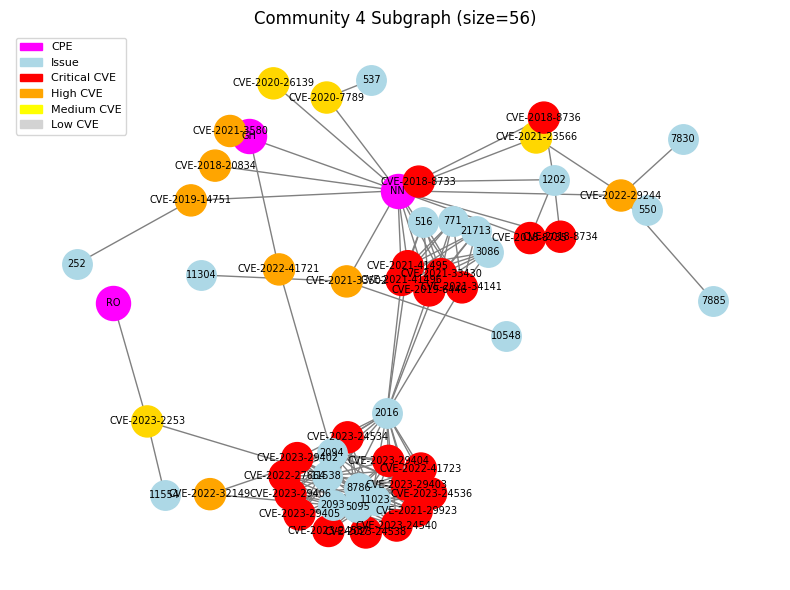

=== Community 5 Summary ===
Total Nodes: 30, Total Edges: 102
CPE Nodes: 2, CVE Nodes: 24, Issue Nodes: 4
Severity Distribution (CVEs):
  Critical: 24
  High: 18
  Medium: 18
  Low: 6
Highest degree node: 53015 (type=Issue, degree=24)
CPEs in this community: ['HC', 'HL']
CVEs in this community: ['CVE-2022-22576', 'CVE-2022-27778', 'CVE-2017-8817', 'CVE-2021-22924', 'CVE-2018-1000005', 'CVE-2022-27780', 'CVE-2023-46218', 'CVE-2022-27782', 'CVE-2022-27781', 'CVE-2021-22925', 'CVE-2021-22926', 'CVE-2022-30115', 'CVE-2021-22945', 'CVE-2022-27776', 'CVE-2021-22923', 'CVE-2023-46219', 'CVE-2017-8818', 'CVE-2021-22947', 'CVE-2022-27774', 'CVE-2022-27779', 'CVE-2021-22946', 'CVE-2022-27775', 'CVE-2017-8816', 'CVE-2023-23916']
Issues in this community: ['69799', '56060', '55772', '53015']
=== End of Summary ===



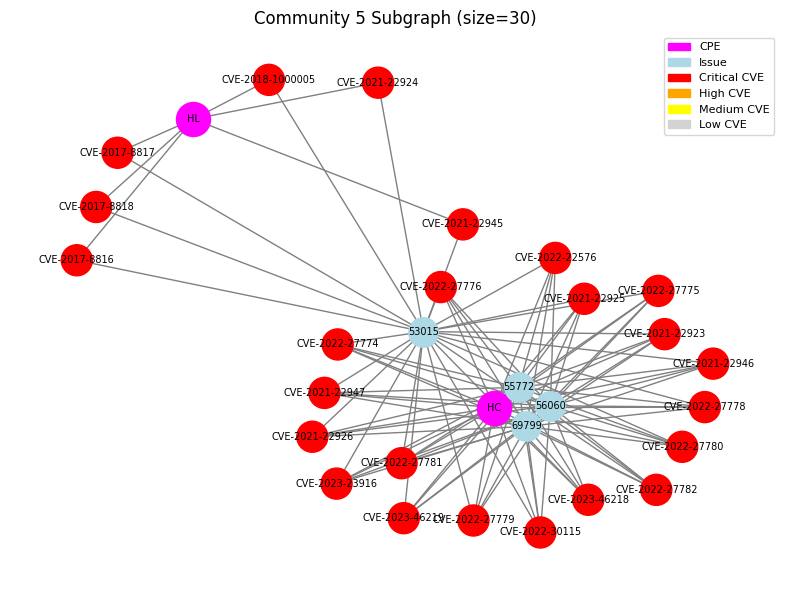

=== Community 6 Summary ===
Total Nodes: 26, Total Edges: 44
CPE Nodes: 1, CVE Nodes: 12, Issue Nodes: 13
Severity Distribution (CVEs):
  Critical: 2
  High: 5
  Medium: 5
  Low: 0
Highest degree node: JJ (type=CPE, degree=12)
CPEs in this community: ['JJ']
CVEs in this community: ['CVE-2022-45685', 'CVE-2019-11358', 'CVE-2022-46175', 'CVE-2022-45693', 'CVE-2018-9206', 'CVE-2021-3918', 'CVE-2023-1436', 'CVE-2020-11022', 'CVE-2022-40150', 'CVE-2020-11023', 'CVE-2021-20066', 'CVE-2020-26232']
Issues in this community: ['345', '1383', '15364', '6827', '560', '20922', '5489', '543', '571', '6826', '25645', '6831', '15020']
=== End of Summary ===



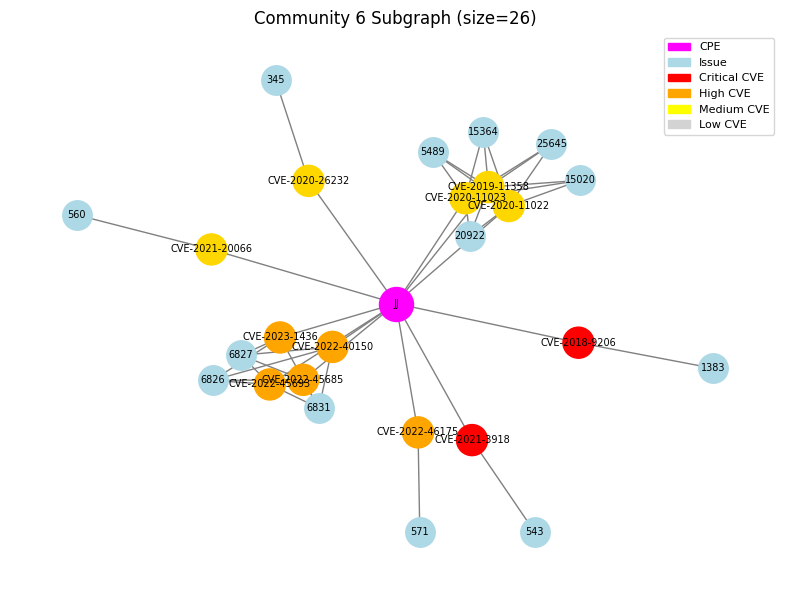

=== Community 7 Summary ===
Total Nodes: 17, Total Edges: 18
CPE Nodes: 1, CVE Nodes: 10, Issue Nodes: 6
Severity Distribution (CVEs):
  Critical: 8
  High: 4
  Medium: 0
  Low: 0
Highest degree node: MM (type=CPE, degree=10)
CPEs in this community: ['MM']
CVEs in this community: ['CVE-2021-29063', 'CVE-2023-3696', 'CVE-2021-26707', 'CVE-2017-17458', 'CVE-2022-2564', 'CVE-2018-16490', 'CVE-2019-10746', 'CVE-2017-16114', 'CVE-2021-23438', 'CVE-2018-13347']
Issues in this community: ['161', '521', '572', '534', '118128', '536']
=== End of Summary ===



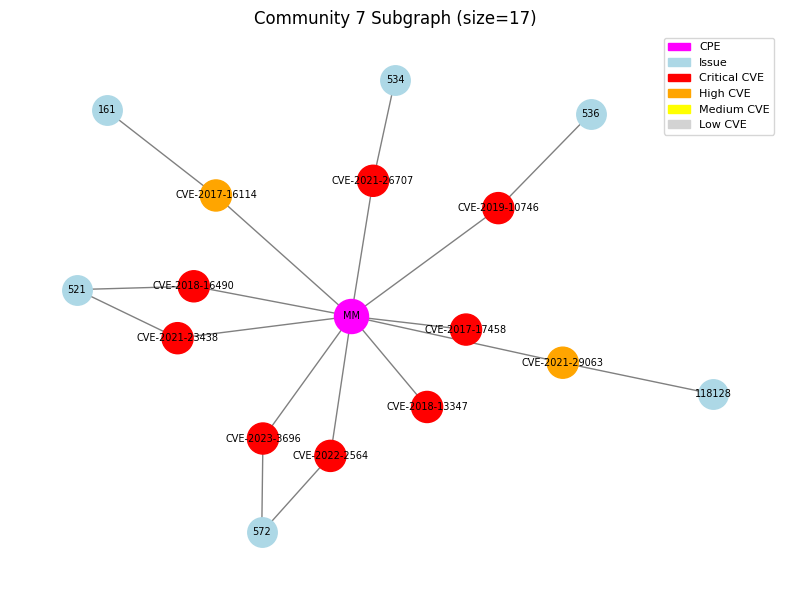

=== Community 8 Summary ===
Total Nodes: 16, Total Edges: 26
CPE Nodes: 1, CVE Nodes: 13, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 4
  High: 13
  Medium: 9
  Low: 0
Highest degree node: 4245 (type=Issue, degree=13)
CPEs in this community: ['FL']
CVEs in this community: ['CVE-2022-2519', 'CVE-2021-33643', 'CVE-2022-0891', 'CVE-2021-33646', 'CVE-2022-2953', 'CVE-2022-2521', 'CVE-2022-0908', 'CVE-2022-2520', 'CVE-2022-0909', 'CVE-2022-0907', 'CVE-2021-33645', 'CVE-2021-33644', 'CVE-2022-0924']
Issues in this community: ['4245', '3752']
=== End of Summary ===



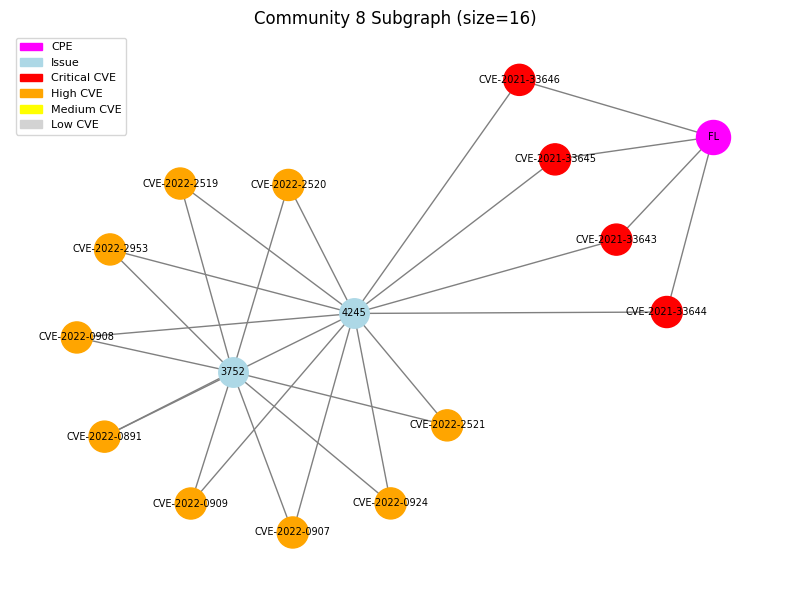

=== Community 9 Summary ===
Total Nodes: 11, Total Edges: 10
CPE Nodes: 1, CVE Nodes: 5, Issue Nodes: 5
Severity Distribution (CVEs):
  Critical: 1
  High: 1
  Medium: 3
  Low: 0
Highest degree node: UU (type=CPE, degree=5)
CPEs in this community: ['UU']
CVEs in this community: ['CVE-2021-23358', 'CVE-2021-45958', 'CVE-2021-27515', 'CVE-2018-6758', 'CVE-2022-0530']
Issues in this community: ['2240', '2590', '3134', '3127', '10753']
=== End of Summary ===



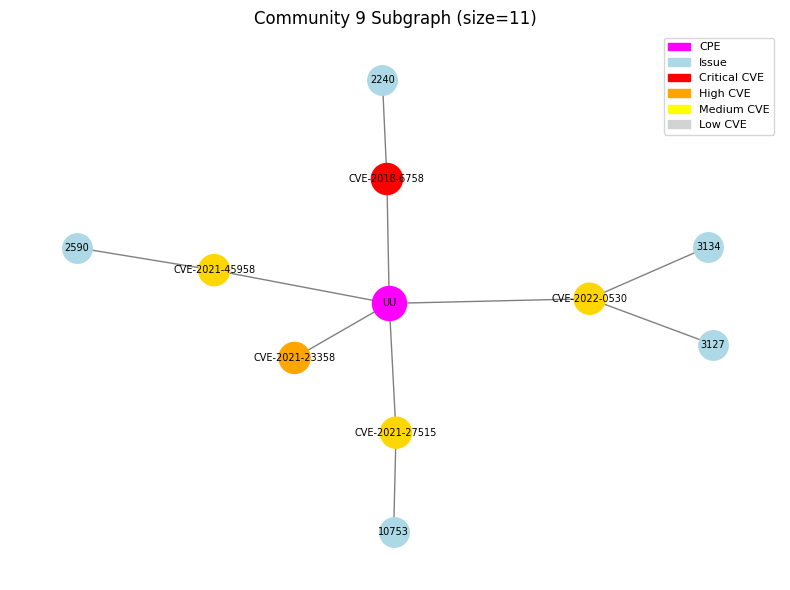

=== Community 10 Summary ===
Total Nodes: 10, Total Edges: 25
CPE Nodes: 0, CVE Nodes: 5, Issue Nodes: 5
Severity Distribution (CVEs):
  Critical: 5
  High: 5
  Medium: 5
  Low: 0
Highest degree node: CVE-2021-23337 (type=CVE, degree=5)
CPEs in this community: []
CVEs in this community: ['CVE-2021-23337', 'CVE-2020-28500', 'CVE-2020-8203', 'CVE-2018-16487', 'CVE-2019-10744']
Issues in this community: ['150', '12272', '4820', '15363', '474']
=== End of Summary ===



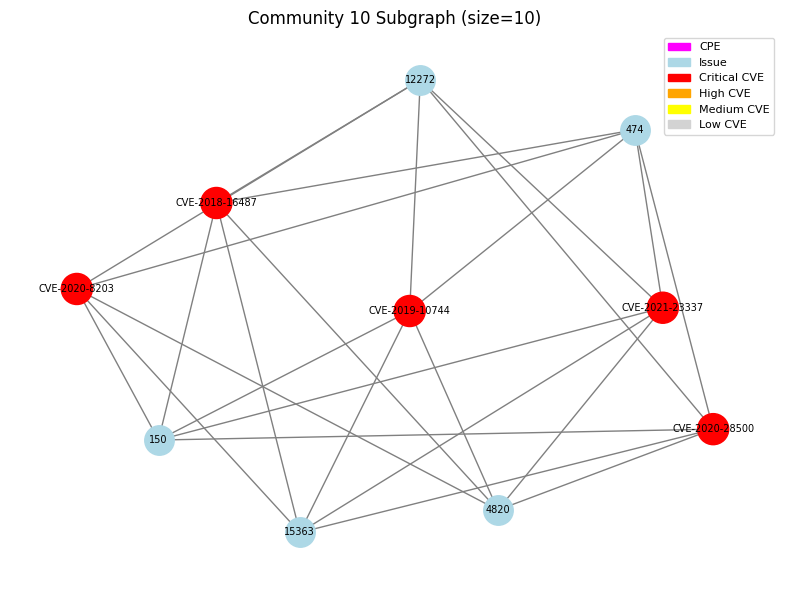

=== Community 11 Summary ===
Total Nodes: 10, Total Edges: 11
CPE Nodes: 1, CVE Nodes: 6, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 3
  High: 6
  Medium: 0
  Low: 0
Highest degree node: HH (type=CPE, degree=6)
CPEs in this community: ['HH']
CVEs in this community: ['CVE-2023-6038', 'CVE-2022-45142', 'CVE-2023-6016', 'CVE-2020-36604', 'CVE-2022-25881', 'CVE-2023-6569']
Issues in this community: ['16341', '570', '565']
=== End of Summary ===



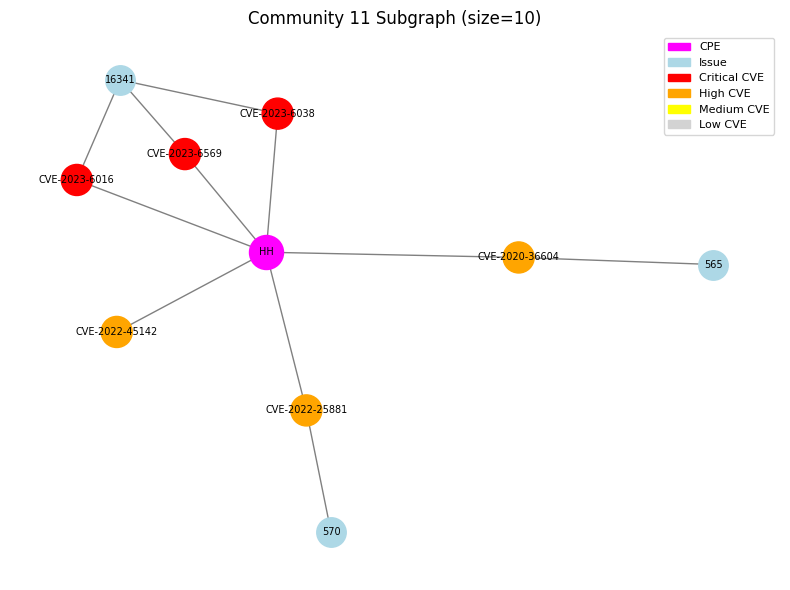

=== Community 12 Summary ===
Total Nodes: 9, Total Edges: 14
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 6
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 0
  Low: 0
Highest degree node: CVE-2019-0205 (type=CVE, degree=7)
CPEs in this community: ['AT']
CVEs in this community: ['CVE-2019-0205', 'CVE-2020-13949']
Issues in this community: ['34361', '34362', '35646', '35588', '35647', '35587']
=== End of Summary ===



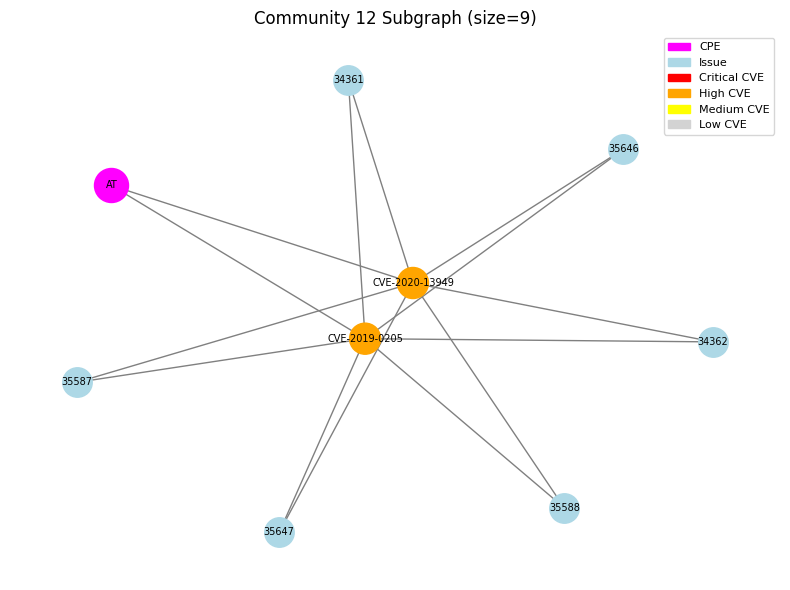

=== Community 13 Summary ===
Total Nodes: 9, Total Edges: 8
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 7
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2023-47248 (type=CVE, degree=8)
CPEs in this community: ['AP']
CVEs in this community: ['CVE-2023-47248']
Issues in this community: ['3832', '4465', '3866', '41314', '6404', '3367', '1062']
=== End of Summary ===



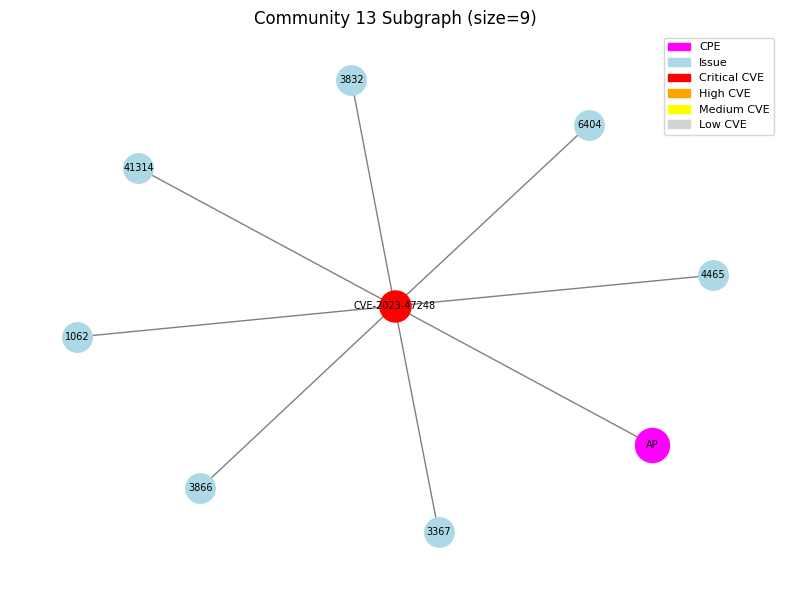

=== Community 14 Summary ===
Total Nodes: 8, Total Edges: 9
CPE Nodes: 1, CVE Nodes: 4, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 1
  High: 3
  Medium: 2
  Low: 0
Highest degree node: EE (type=CPE, degree=4)
CPEs in this community: ['EE']
CVEs in this community: ['CVE-2020-13822', 'CVE-2021-22204', 'CVE-2020-28498', 'CVE-2022-29078']
Issues in this community: ['552', '1302', '530']
=== End of Summary ===



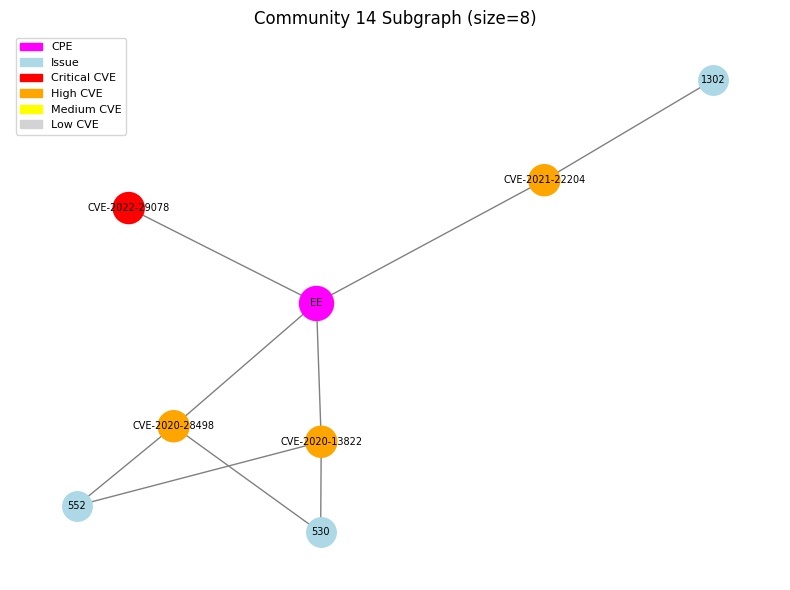

=== Community 15 Summary ===
Total Nodes: 7, Total Edges: 6
CPE Nodes: 1, CVE Nodes: 3, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 2
  Low: 0
Highest degree node: WW (type=CPE, degree=3)
CPEs in this community: ['WW']
CVEs in this community: ['CVE-2021-32640', 'CVE-2020-7662', 'CVE-2021-33880']
Issues in this community: ['9519', '5', '506']
=== End of Summary ===



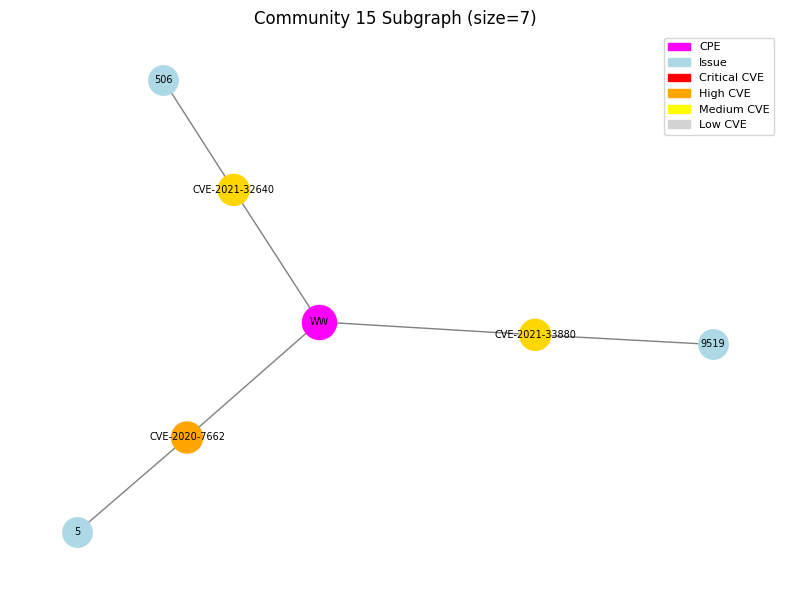

=== Community 16 Summary ===
Total Nodes: 6, Total Edges: 8
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 2
  Low: 0
Highest degree node: CVE-2018-18074 (type=CVE, degree=4)
CPEs in this community: ['PR']
CVEs in this community: ['CVE-2018-18074', 'CVE-2023-32681']
Issues in this community: ['1340', '4517', '111']
=== End of Summary ===



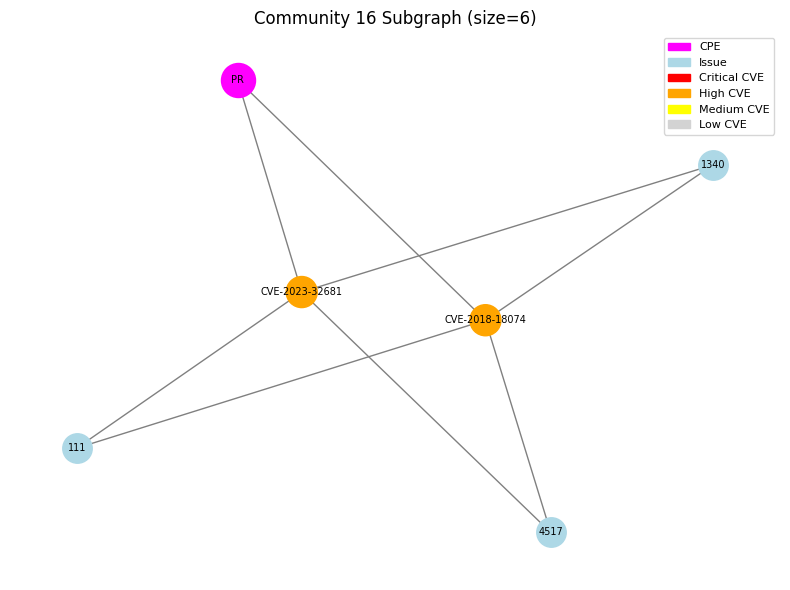

=== Community 17 Summary ===
Total Nodes: 6, Total Edges: 5
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 5
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-10531 (type=CVE, degree=5)
CPEs in this community: []
CVEs in this community: ['CVE-2020-10531']
Issues in this community: ['54185', '54184', '54182', '54183', '54186']
=== End of Summary ===



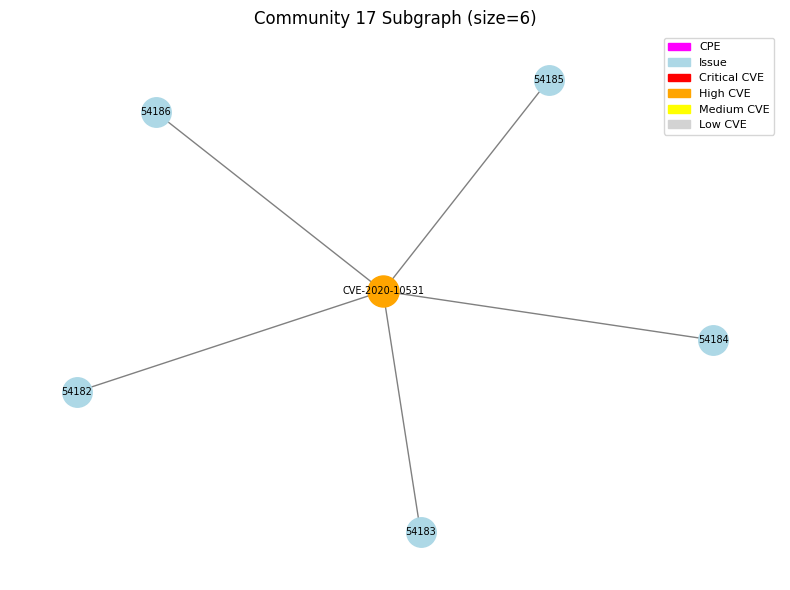

=== Community 18 Summary ===
Total Nodes: 6, Total Edges: 5
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 1
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-7660 (type=CVE, degree=3)
CPEs in this community: ['VS']
CVEs in this community: ['CVE-2020-7660', 'CVE-2022-22978']
Issues in this community: ['129', '538', '555']
=== End of Summary ===



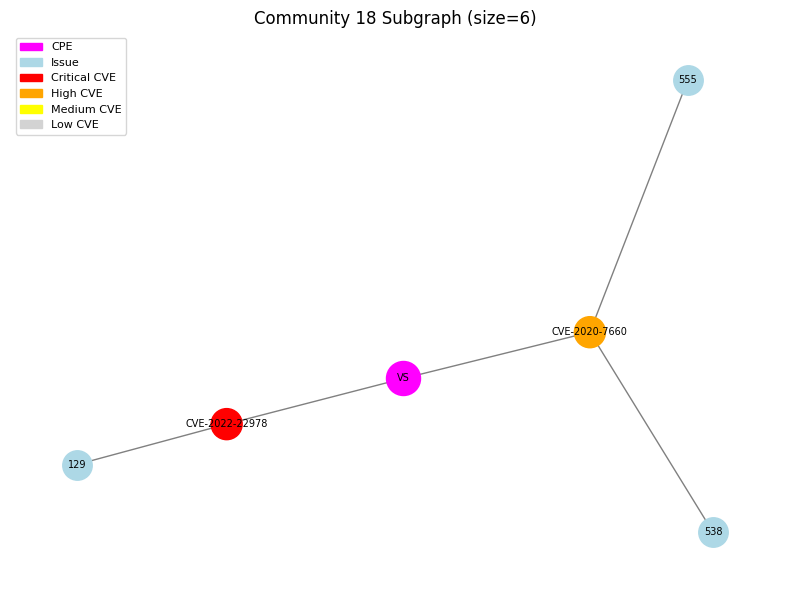

=== Community 19 Summary ===
Total Nodes: 5, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2017-5754 (type=CVE, degree=2)
CPEs in this community: ['IC']
CVEs in this community: ['CVE-2017-5754', 'CVE-2019-11510']
Issues in this community: ['1708', '16603']
=== End of Summary ===



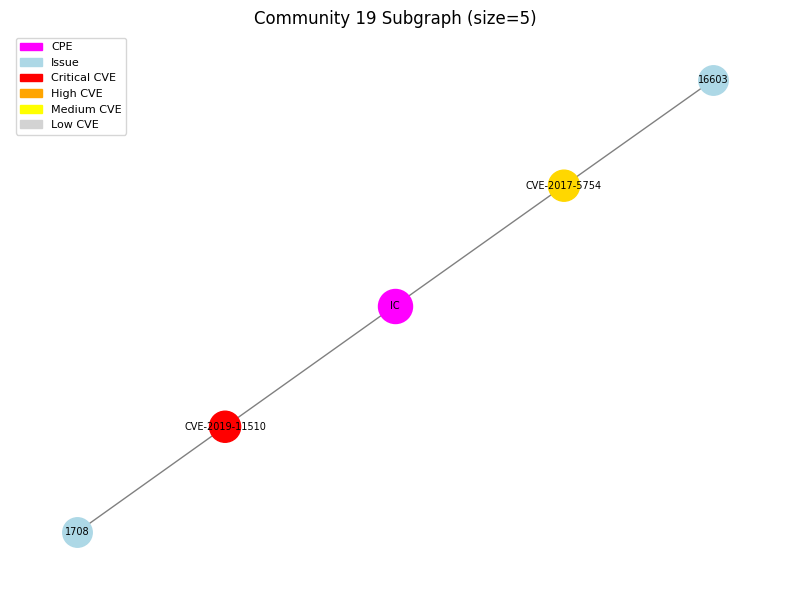

=== Community 20 Summary ===
Total Nodes: 5, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-13091 (type=CVE, degree=4)
CPEs in this community: ['NP']
CVEs in this community: ['CVE-2020-13091']
Issues in this community: ['60657', '48049', '36256']
=== End of Summary ===



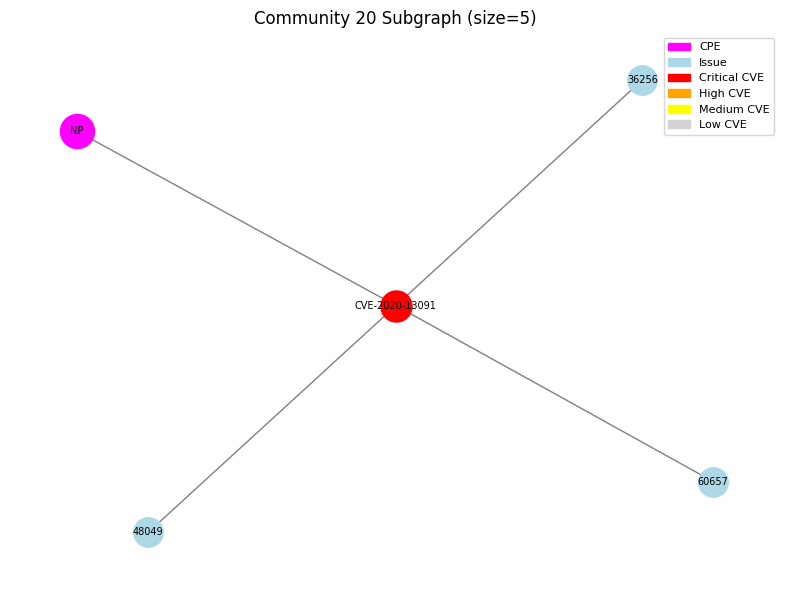

=== Community 21 Summary ===
Total Nodes: 4, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-14153 (type=CVE, degree=2)
CPEs in this community: ['IL']
CVEs in this community: ['CVE-2020-14153', 'CVE-2020-14152']
Issues in this community: ['2618']
=== End of Summary ===



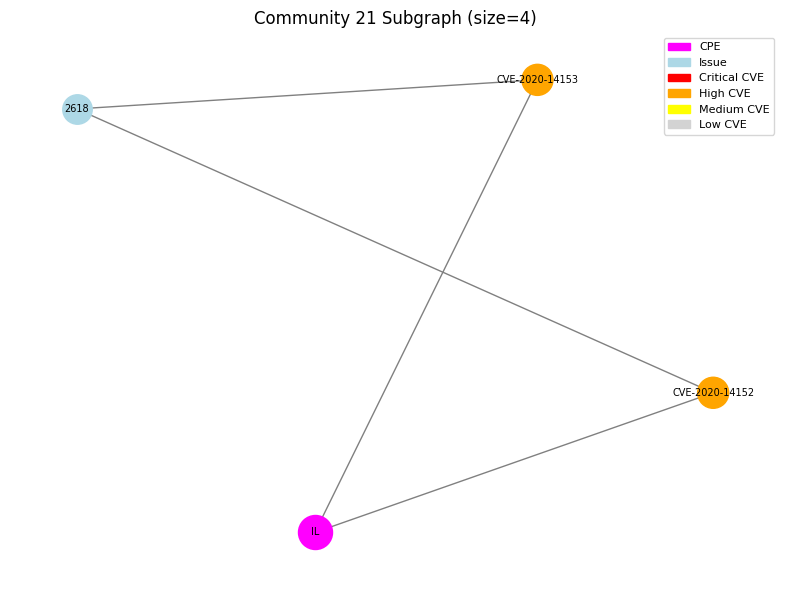

=== Community 22 Summary ===
Total Nodes: 4, Total Edges: 3
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-7774 (type=CVE, degree=3)
CPEs in this community: ['YY']
CVEs in this community: ['CVE-2020-7774']
Issues in this community: ['557', '542']
=== End of Summary ===



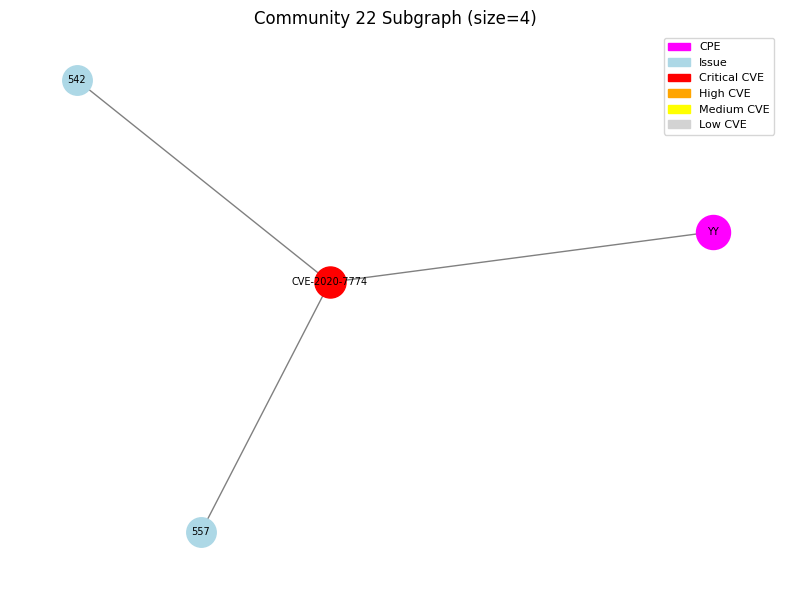

=== Community 23 Summary ===
Total Nodes: 4, Total Edges: 3
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 3
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2021-27290 (type=CVE, degree=3)
CPEs in this community: []
CVEs in this community: ['CVE-2021-27290']
Issues in this community: ['541', '556', '10818']
=== End of Summary ===



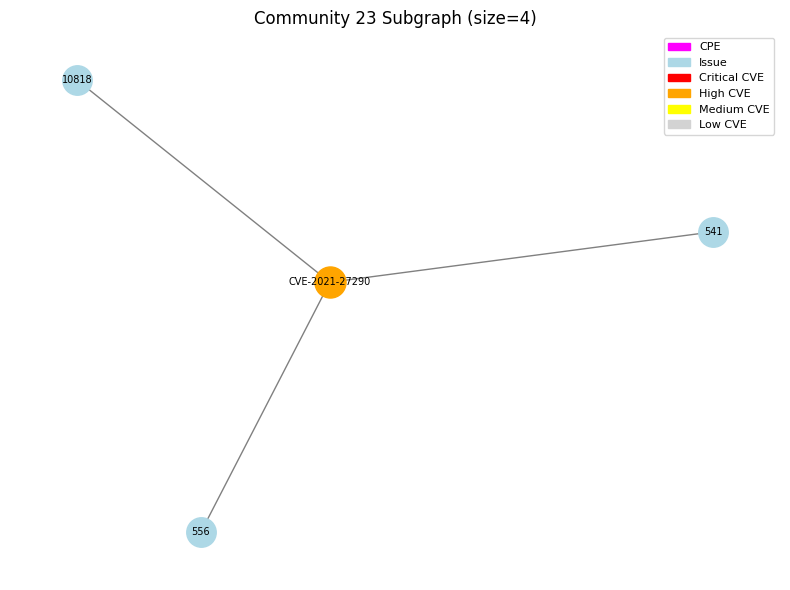

=== Community 24 Summary ===
Total Nodes: 4, Total Edges: 3
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 0
  Low: 0
Highest degree node: CVE-2022-21698 (type=CVE, degree=2)
CPEs in this community: ['PC']
CVEs in this community: ['CVE-2022-21698', 'CVE-2023-45142']
Issues in this community: ['3361']
=== End of Summary ===



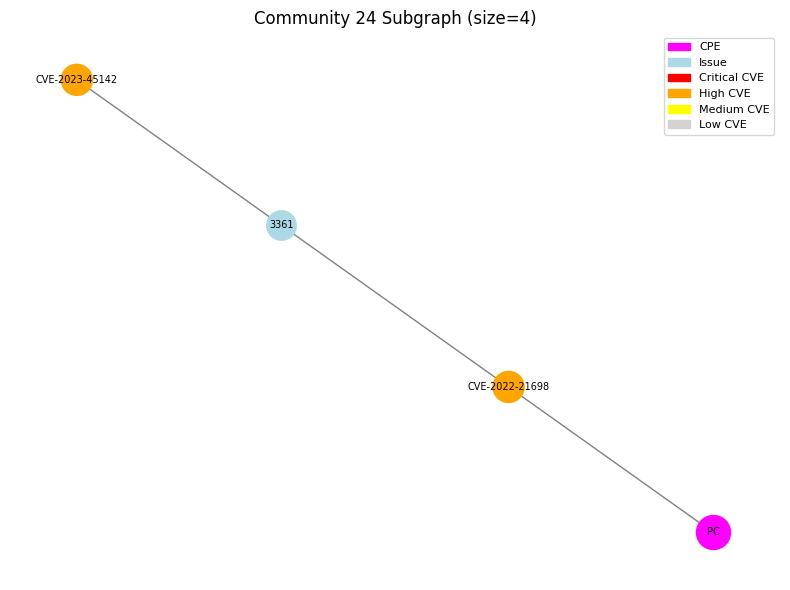

=== Community 25 Summary ===
Total Nodes: 4, Total Edges: 4
CPE Nodes: 1, CVE Nodes: 2, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 2
  Medium: 2
  Low: 0
Highest degree node: CVE-2023-45803 (type=CVE, degree=2)
CPEs in this community: ['PU']
CVEs in this community: ['CVE-2023-45803', 'CVE-2023-43804']
Issues in this community: ['1049']
=== End of Summary ===



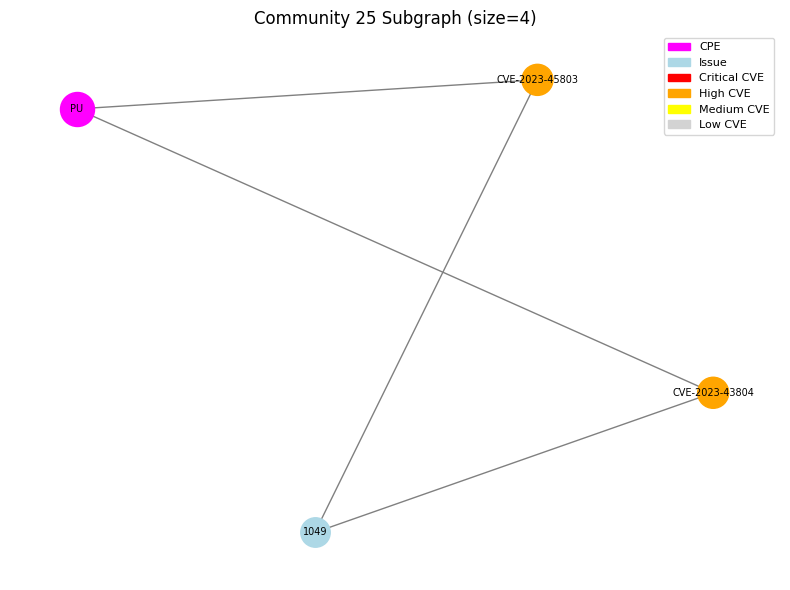

=== Community 26 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2017-5689 (type=CVE, degree=2)
CPEs in this community: ['IA']
CVEs in this community: ['CVE-2017-5689']
Issues in this community: ['1066']
=== End of Summary ===



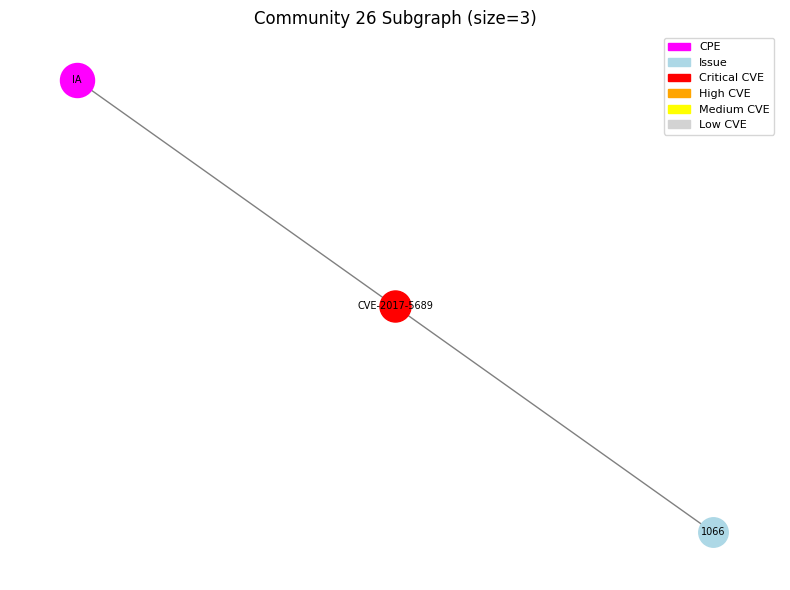

=== Community 27 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 2
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2017-9805 (type=CVE, degree=2)
CPEs in this community: []
CVEs in this community: ['CVE-2017-9805']
Issues in this community: ['1463', '1712']
=== End of Summary ===



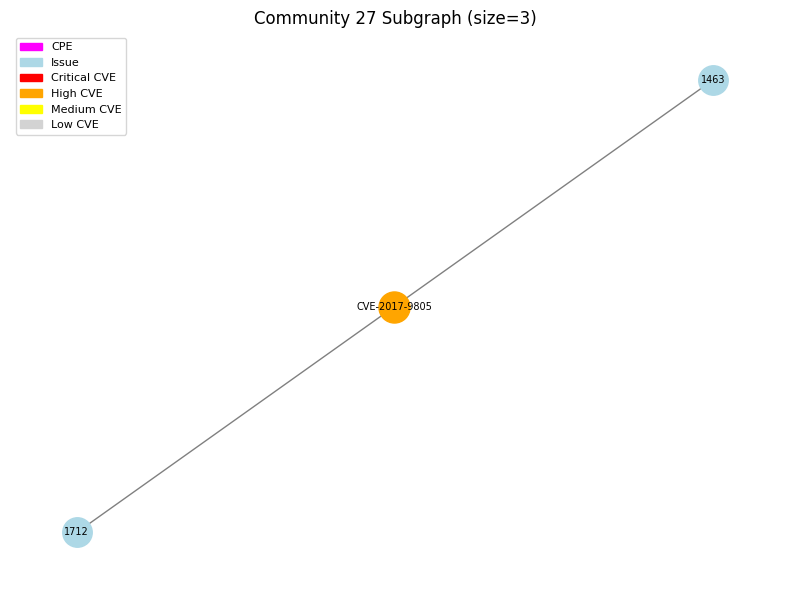

=== Community 28 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2019-0201 (type=CVE, degree=2)
CPEs in this community: ['AZ']
CVEs in this community: ['CVE-2019-0201']
Issues in this community: ['25933']
=== End of Summary ===



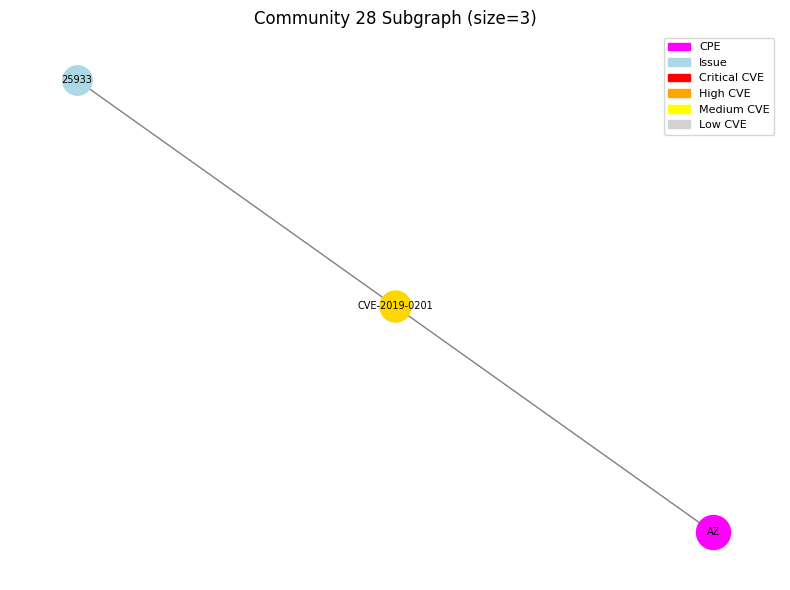

=== Community 29 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2019-10906 (type=CVE, degree=2)
CPEs in this community: ['PJ']
CVEs in this community: ['CVE-2019-10906']
Issues in this community: ['1193']
=== End of Summary ===



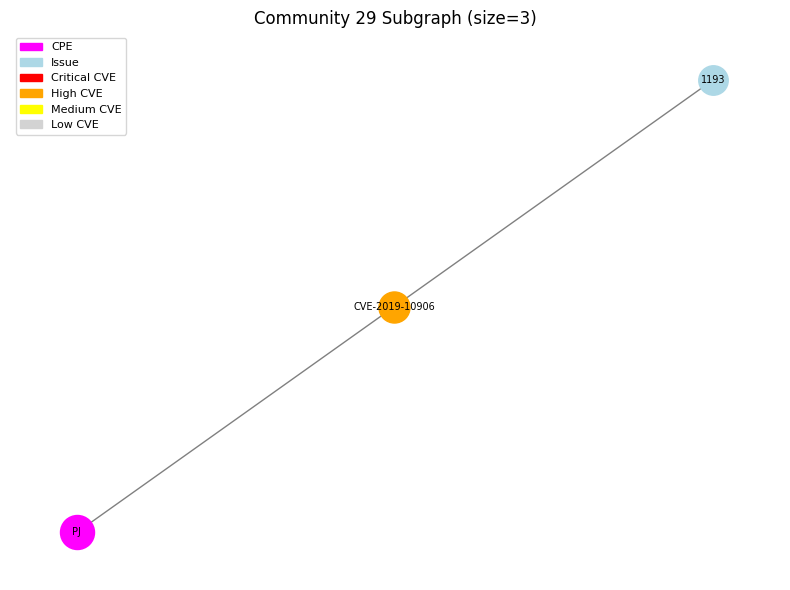

=== Community 30 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2019-16789 (type=CVE, degree=2)
CPEs in this community: ['AW']
CVEs in this community: ['CVE-2019-16789']
Issues in this community: ['139']
=== End of Summary ===



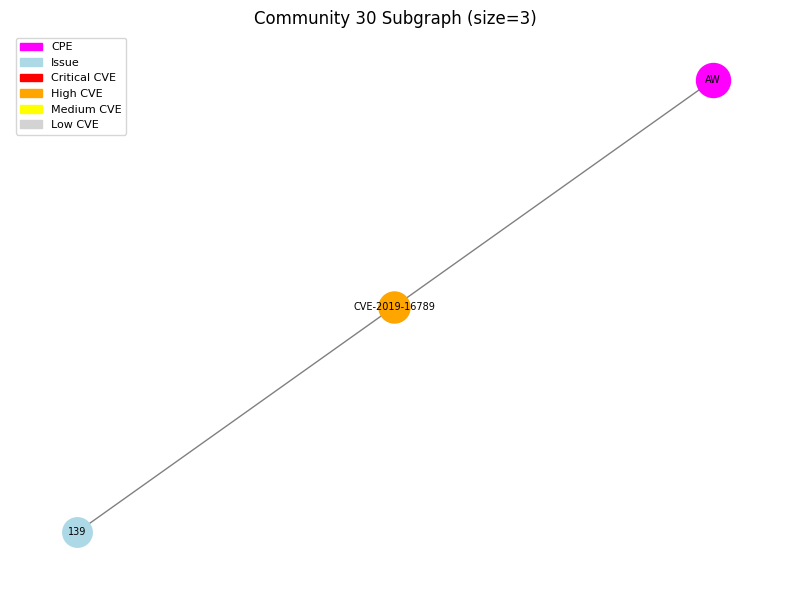

=== Community 31 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2019-20149 (type=CVE, degree=2)
CPEs in this community: ['KK']
CVEs in this community: ['CVE-2019-20149']
Issues in this community: ['533']
=== End of Summary ===



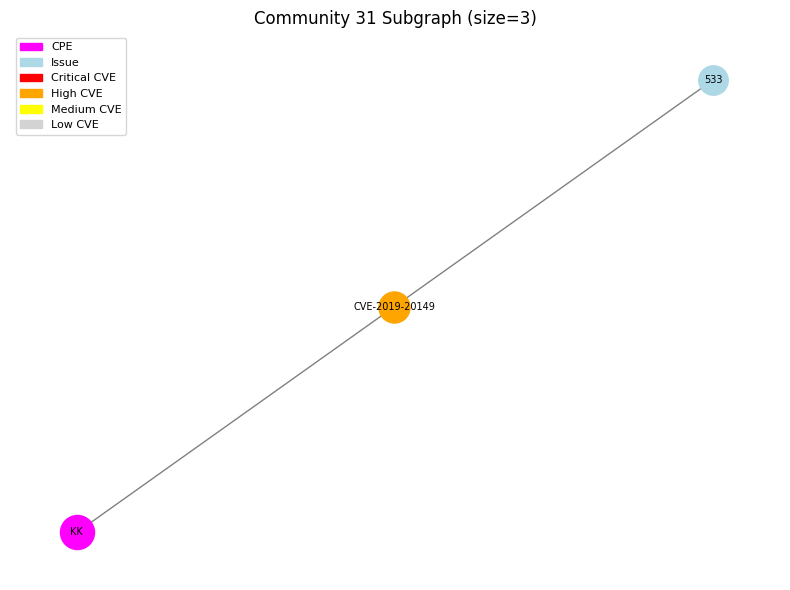

=== Community 32 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2019-2391 (type=CVE, degree=2)
CPEs in this community: ['MJ']
CVEs in this community: ['CVE-2019-2391']
Issues in this community: ['501']
=== End of Summary ===



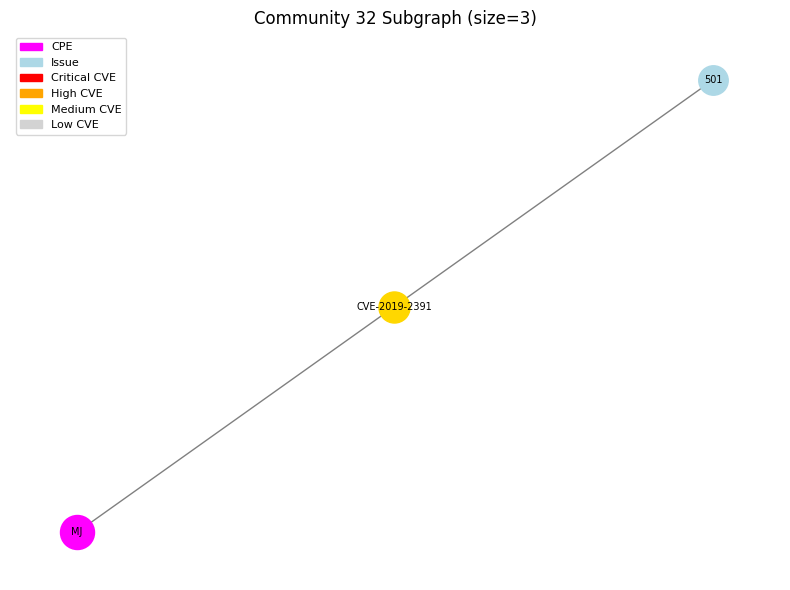

=== Community 33 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2020-14882 (type=CVE, degree=2)
CPEs in this community: ['OW']
CVEs in this community: ['CVE-2020-14882']
Issues in this community: ['2169']
=== End of Summary ===



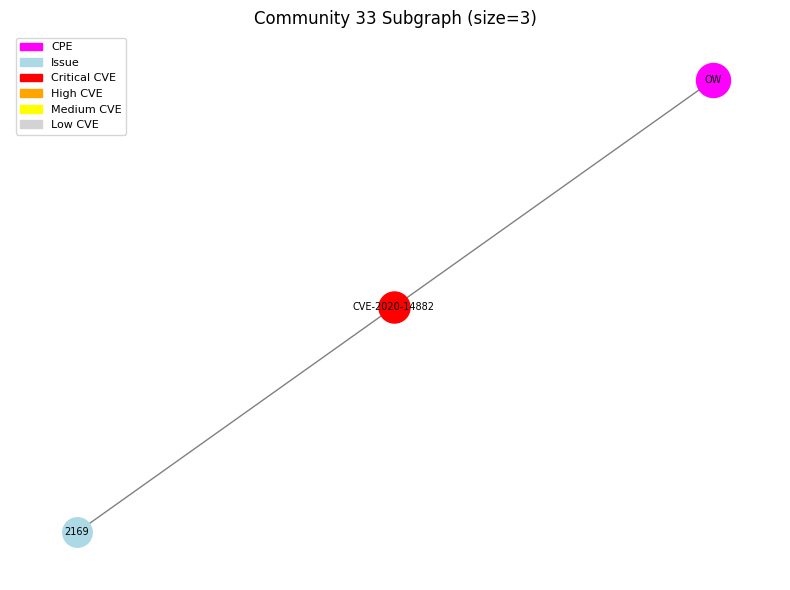

=== Community 34 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2021-23362 (type=CVE, degree=2)
CPEs in this community: ['NH']
CVEs in this community: ['CVE-2021-23362']
Issues in this community: ['502']
=== End of Summary ===



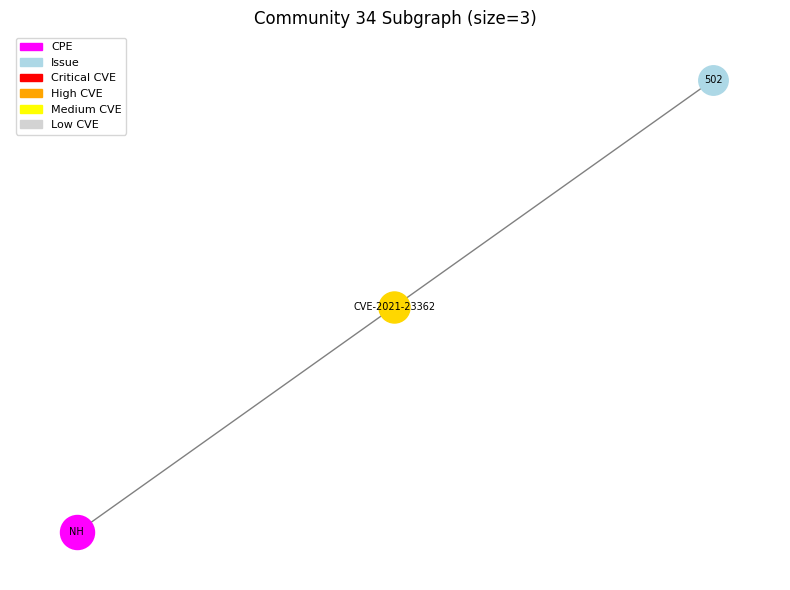

=== Community 35 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2021-24032 (type=CVE, degree=2)
CPEs in this community: ['FZ']
CVEs in this community: ['CVE-2021-24032']
Issues in this community: ['1701']
=== End of Summary ===



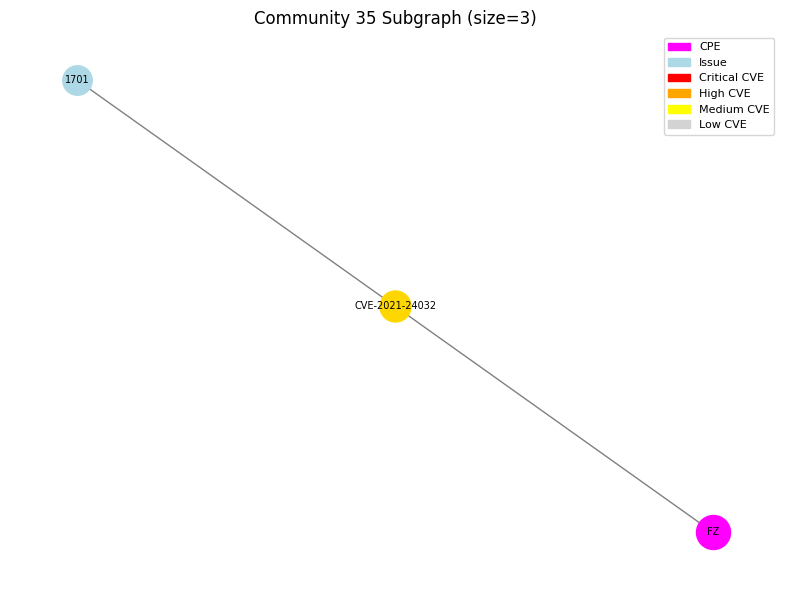

=== Community 36 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2021-44732 (type=CVE, degree=2)
CPEs in this community: ['AM']
CVEs in this community: ['CVE-2021-44732']
Issues in this community: ['43677']
=== End of Summary ===



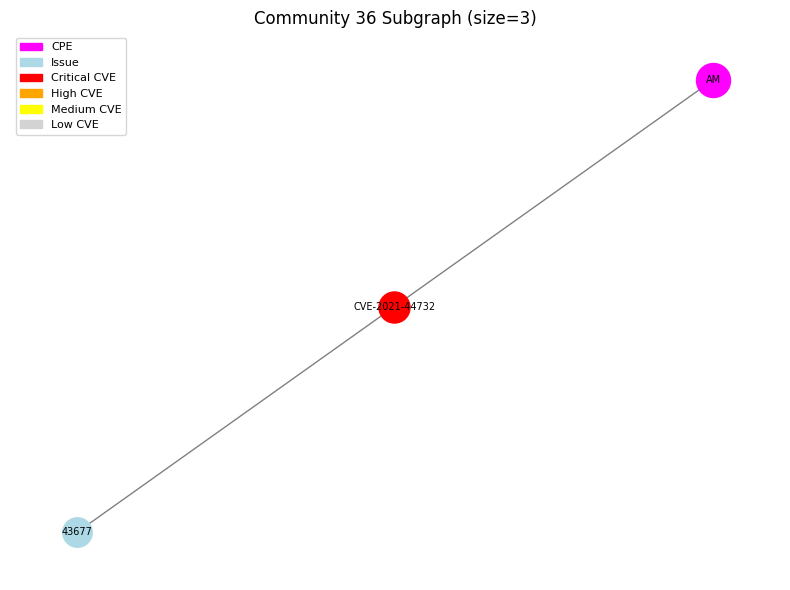

=== Community 37 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: CVE-2022-21907 (type=CVE, degree=2)
CPEs in this community: ['MW']
CVEs in this community: ['CVE-2022-21907']
Issues in this community: ['2447']
=== End of Summary ===



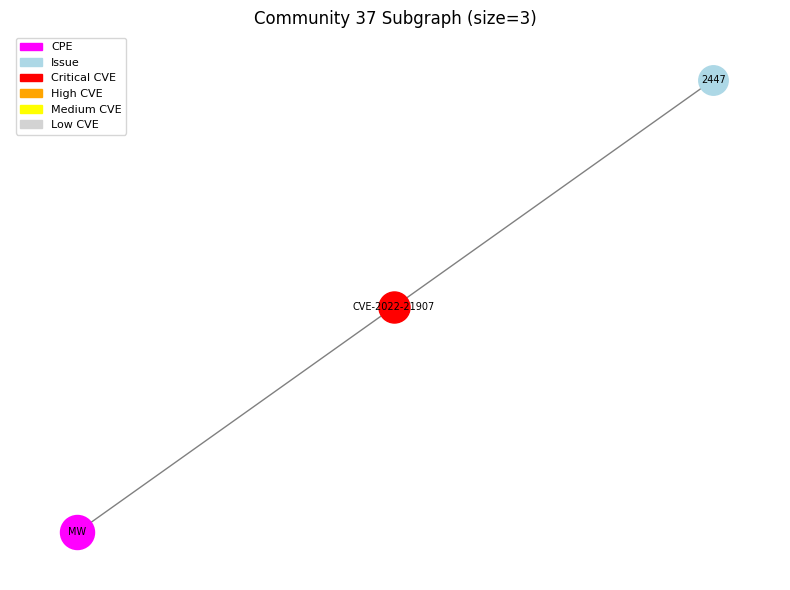

=== Community 38 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2022-27191 (type=CVE, degree=2)
CPEs in this community: ['GS']
CVEs in this community: ['CVE-2022-27191']
Issues in this community: ['1875']
=== End of Summary ===



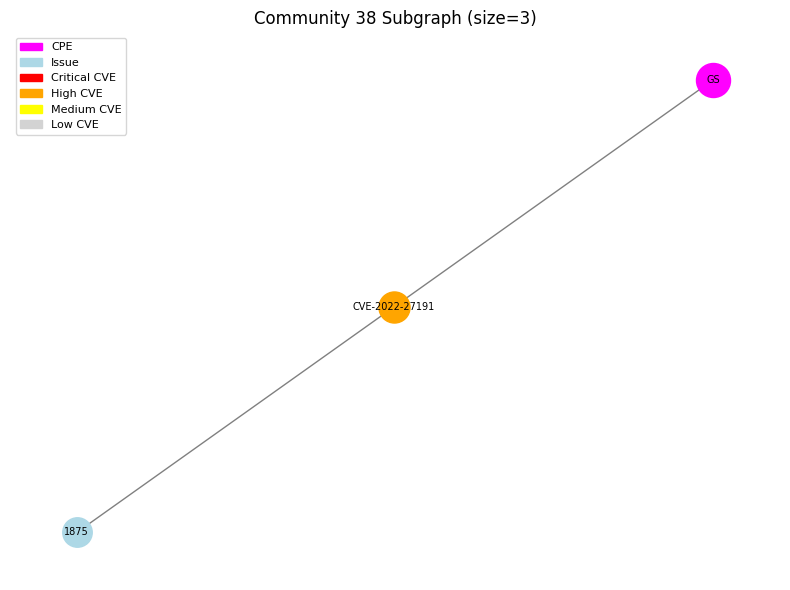

=== Community 39 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 0
  Medium: 1
  Low: 0
Highest degree node: CVE-2022-40897 (type=CVE, degree=2)
CPEs in this community: ['PS']
CVEs in this community: ['CVE-2022-40897']
Issues in this community: ['29428']
=== End of Summary ===



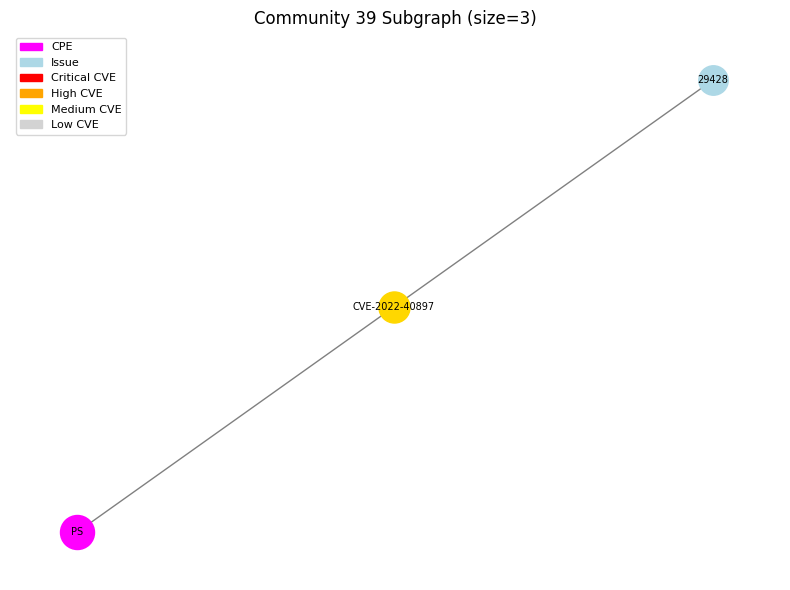

=== Community 40 Summary ===
Total Nodes: 3, Total Edges: 2
CPE Nodes: 1, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 0
  High: 1
  Medium: 0
  Low: 0
Highest degree node: CVE-2023-30798 (type=CVE, degree=2)
CPEs in this community: ['ES']
CVEs in this community: ['CVE-2023-30798']
Issues in this community: ['17563']
=== End of Summary ===



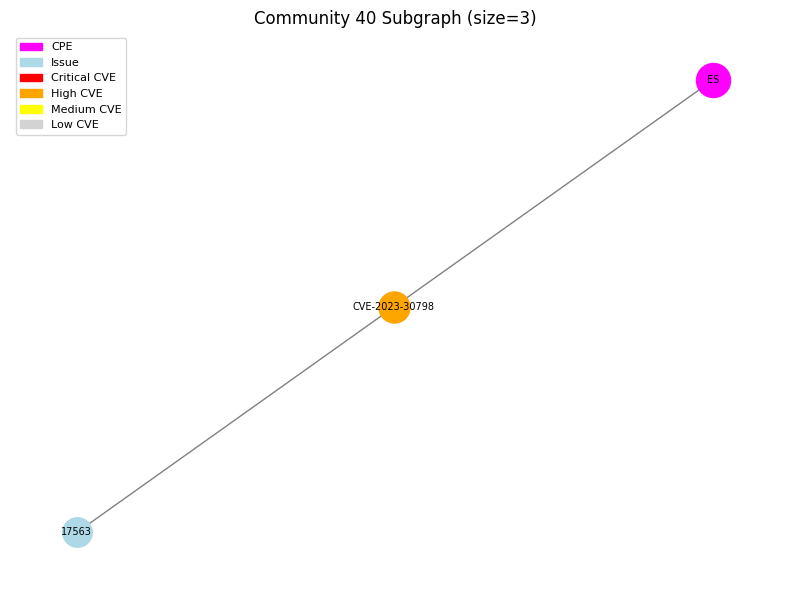

=== Community 41 Summary ===
Total Nodes: 2, Total Edges: 1
CPE Nodes: 0, CVE Nodes: 1, Issue Nodes: 1
Severity Distribution (CVEs):
  Critical: 1
  High: 0
  Medium: 0
  Low: 0
Highest degree node: 539 (type=Issue, degree=1)
CPEs in this community: []
CVEs in this community: ['CVE-2021-25949']
Issues in this community: ['539']
=== End of Summary ===



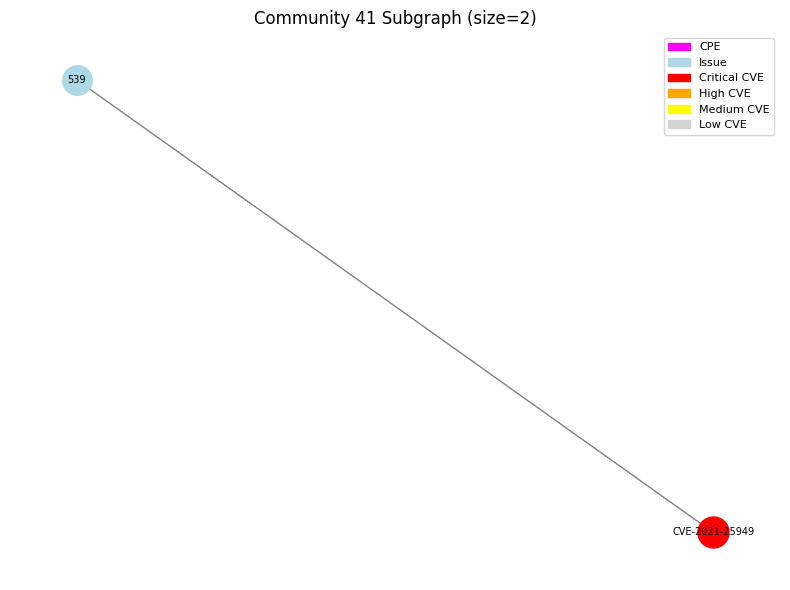

In [43]:

"""
Build a directed NetworkX graph from a CSV of vulnerabilities
demonstrating all relationship directions between CPE, CVE, and Issue.
"""

import csv
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from collections import deque

def build_directed_graph_from_csv(csv_path):
    """
    Reads the CSV file and constructs a DiGraph where:
    - Each CPE is a node (node_type="CPE")
    - Each CVE is a node (node_type="CVE")
    - Each Issue is a node (node_type="Issue")

    Edges (two-way) for "all" relationships:
    - CPE -> CVE, labeled 'IS_VULNERABLE_TO'
    - CVE -> CPE, labeled 'AFFECTS'
    - CVE -> Issue, labeled 'TRACKED_BY'
    - Issue -> CVE, labeled 'REFERENCES'
    """
    G = nx.DiGraph()  # Directed graph

    with open(csv_path, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        for row in reader:
            # Extract fields from CSV row
            cpe_name = row["CPE dependency name"].strip()
            cve_ids_str = row["CVE ID"].strip()
            issues_str = row["Issues"].strip()

            # Split possible multiple values on comma
            cve_ids = [c.strip() for c in cve_ids_str.split(",")]
            issues_list = [i.strip() for i in issues_str.split(",")]

            # Optional: parse severities or number of occurrences
            severity_str = row["CVE severity"].strip()
            severity_list = [s.strip() for s in severity_str.split(",")]
            occurrences = row["Number of CVE ID occurrences"].strip()
            num_issues = row["Number of Issues"].strip()

            # -- Add CPE node --
            if not G.has_node(cpe_name):
                G.add_node(cpe_name, node_type="CPE")

            # For each CVE in this row
            for cve in cve_ids:
                if not G.has_node(cve):
                    G.add_node(
                        cve,
                        node_type="CVE",
                        severity=severity_list,
                        occurrences=occurrences
                    )
                # Add directed edges in both directions:
                # # CPE -> CVE
                # if not G.has_edge(cpe_name, cve):
                #     G.add_edge(cpe_name, cve, relation="IS_VULNERABLE_TO")
                # CVE -> CPE
                if not G.has_edge(cve, cpe_name):
                    G.add_edge(cve, cpe_name, relation="AFFECTS")

                # Link each CVE to Issues
                for issue in issues_list:
                    if not G.has_node(issue):
                        G.add_node(issue, node_type="Issue")

                    # # CVE -> Issue
                    # if not G.has_edge(cve, issue):
                    #     G.add_edge(cve, issue, relation="TRACKED_BY")
                    # Issue -> CVE
                    if not G.has_edge(issue, cve):
                        G.add_edge(issue, cve, relation="REFERENCES")

    return G



def summarize_community(subg, community_id):
    """
    Prints summary statistics about one subgraph (one community):
      - # of CPE, CVE, Issue nodes
      - severity distribution among CVEs
      - top (highest degree) node
      - actual node lists
    """
    # Partition nodes by type
    cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
    cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
    issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

    num_cpe   = len(cpe_nodes)
    num_cve   = len(cve_nodes)
    num_issue = len(issue_nodes)
    total_nodes = subg.number_of_nodes()
    total_edges = subg.number_of_edges()

    # Severity distribution among CVEs
    severity_count = {"critical": 0, "high": 0, "medium": 0, "low": 0}
    for cve in cve_nodes:
        sev_list = subg.nodes[cve].get("severity", [])
        for s in sev_list:
            s_lower = s.lower()
            if s_lower in severity_count:
                severity_count[s_lower] += 1

    # Highest degree node
    degrees = subg.degree()
    top_node, top_degree = max(degrees, key=lambda x: x[1])
    top_type = subg.nodes[top_node].get("node_type", "Unknown")

    print(f"=== Community {community_id} Summary ===")
    print(f"Total Nodes: {total_nodes}, Total Edges: {total_edges}")
    print(f"CPE Nodes: {num_cpe}, CVE Nodes: {num_cve}, Issue Nodes: {num_issue}")

    print("Severity Distribution (CVEs):")
    for sev, count in severity_count.items():
        print(f"  {sev.title()}: {count}")

    print(f"Highest degree node: {top_node} (type={top_type}, degree={top_degree})")
    print(f"CPEs in this community: {cpe_nodes}")
    print(f"CVEs in this community: {cve_nodes}")
    print(f"Issues in this community: {issue_nodes}")
    print("=== End of Summary ===\n")

###############################################################################
# STEP 3: DRAW A COMMUNITY SUBGRAPH
###############################################################################

def draw_community_subgraph(subg, community_id):
    """
    Draws the subgraph for a single community, color-coding nodes:
      - CPE (red)
      - CVE (by worst severity)
      - Issue (lightblue)
    """
    plt.figure(figsize=(8, 6))
    pos = nx.spring_layout(subg, k=0.5, seed=42)

    # Node lists
    cpe_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CPE"]
    cve_nodes   = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "CVE"]
    issue_nodes = [n for n, d in subg.nodes(data=True) if d.get("node_type") == "Issue"]

    # CPE in red
    nx.draw_networkx_nodes(subg, pos,
                           nodelist=cpe_nodes,
                           node_color="magenta",
                           node_size=600)

    # CVE color-coded by worst severity
    cve_colors = []
    for node in cve_nodes:
        sev_list = subg.nodes[node].get("severity", [])
        cve_colors.append(color_for_severity(worst_severity(sev_list)))

    nx.draw_networkx_nodes(subg, pos,
                           nodelist=cve_nodes,
                           node_color=cve_colors,
                           node_size=500)

    # Issues in lightblue
    nx.draw_networkx_nodes(subg, pos,
                           nodelist=issue_nodes,
                           node_color="lightblue",
                           node_size=450)

    # Edges in gray
    nx.draw_networkx_edges(subg, pos, edge_color="gray")

    # Node labels
    nx.draw_networkx_labels(subg, pos, font_size=7)

    # Legend
    red_patch      = mpatches.Patch(color='magenta',        label='CPE')
    lightblue_patch= mpatches.Patch(color='lightblue',  label='Issue')
    ccrit_patch    = mpatches.Patch(color='red',        label='Critical CVE')
    chigh_patch    = mpatches.Patch(color='orange',     label='High CVE')
    cmed_patch     = mpatches.Patch(color='yellow',     label='Medium CVE')
    clow_patch     = mpatches.Patch(color='lightgray',  label='Low CVE')

    plt.legend(handles=[red_patch, lightblue_patch, ccrit_patch, chigh_patch, cmed_patch, clow_patch],
               loc='best', fontsize=8)

    plt.title(f"Community {community_id} Subgraph (size={subg.number_of_nodes()})")
    plt.axis("off")
    plt.tight_layout()
    plt.show()


def draw_entire_graph(G):
    """
    Draws the entire directed graph, color‐coding nodes by node_type.
    For large data, this can be very dense. 
    """

    ## Draw layout of main graph
    plt.figure(figsize=(12, 10))
    pos = nx.spring_layout(G, k=0.5, seed=42)  # a basic layout

    # Assign colors based on node_type
    node_colors = []
    for node, data in G.nodes(data=True):
        if data["node_type"] == "CPE":
            node_colors.append("red")
        elif data["node_type"] == "CVE":
            node_colors.append("orange")
        elif data["node_type"] == "Issue":
            node_colors.append("lightblue")
        else:
            node_colors.append("gray")

    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=500)
    nx.draw_networkx_labels(G, pos, font_size=7)
    nx.draw_networkx_edges(G,
                           pos, 
                           arrows=True, 
                           #arrowstyle="-|>", 
                           arrowsize=20,
                           min_source_margin=15, # offset at the source node
                           min_target_margin=15, # offset at the target node
                           connectionstyle='arc3,rad=0.1',  # optional slight curve
                        )

    # If you want edge labels (the relation attribute)
    # edge_labels = nx.get_edge_attributes(G, 'relation')
    # nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=6)

    plt.title("Directed Graph of CPE ↔ CVE ↔ Issue (All Relationship Directions)")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

def draw_subgraph_around_node(G, center_node, depth=2):
    """
    Extracts a small directed subgraph of BFS depth `depth` around `center_node`
    to keep visualization less cluttered.
    """
    if center_node not in G:
        print(f"Node '{center_node}' not found in graph.")
        return

    visited = set()
    sub_nodes = set()
    queue = deque([(center_node, 0)])
    
    while queue:
        node, dist = queue.popleft()
        if node in visited or dist > depth:
            continue
        visited.add(node)
        sub_nodes.add(node)

        # Add successors and predecessors for a bidirectional neighborhood
        for successor in G.successors(node):
            if successor not in visited:
                queue.append((successor, dist + 1))
        for predecessor in G.predecessors(node):
            if predecessor not in visited:
                queue.append((predecessor, dist + 1))

    # Now sub_nodes has the BFS neighborhood
    H = G.subgraph(sub_nodes).copy()


    ## Draw layout
    plt.figure(figsize=(12, 8))
    pos = nx.spring_layout(H, k=0.5, seed=42, scale=2, dim=2)

    node_colors = []
    for node, data in H.nodes(data=True):
        if data["node_type"] == "CPE":
            node_colors.append("red")
        elif data["node_type"] == "CVE":
            node_colors.append("orange")
        elif data["node_type"] == "Issue":
            node_colors.append("lightblue")
        else:
            node_colors.append("gray")

    nx.draw_networkx_nodes(H, pos, node_color=node_colors, node_size=800)
    nx.draw_networkx_labels(H, pos, font_size=8)
    nx.draw_networkx_edges(H, 
                           pos, 
                           arrows=True, 
                           #arrowstyle="-|>", 
                           arrowsize=25,
                           min_source_margin=15, # offset at the source node
                           min_target_margin=15, # offset at the target node
                           connectionstyle='arc3,rad=0.1',  # optional slight curve
                        )

    # Show relation labels on edges
    edge_labels = nx.get_edge_attributes(H, "relation")
    nx.draw_networkx_edge_labels(H, pos, edge_labels=edge_labels, font_size=7)



    # --- ADD A LEGEND ---
    # Create legend patches for each node type
    cpe_patch   = mpatches.Patch(color='red',        label='CPE')
    cve_patch   = mpatches.Patch(color='orange',     label='CVE')
    issue_patch = mpatches.Patch(color='lightblue',  label='Issue')

    # Draw the legend; 'loc' can be 'upper right', 'lower left', etc.
    plt.legend(handles=[cpe_patch, cve_patch, issue_patch],
               loc='best',
               fontsize=9)


    plt.title(f"Subgraph (depth={depth}) around node '{center_node}'")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

def main():
    # Path to your CSV file with columns like:
    # "CPE dependency name", "CVE ID", "CVE severity", "Number of CVE ID occurrences",
    # "Number of Issues", "Issues", ...
    csv_file = "./github-data/issues2cve.csv"

    # 1) Build the directed graph from CSV
    directed_graph = build_directed_graph_from_csv(csv_file)

    # 2) Draw the entire graph (can be very busy if large)
    draw_entire_graph(directed_graph)

    # 3) Draw a subgraph around some known node (e.g. a CPE or CVE)
    #    Replace 'X' with any node that appears in your CSV (CPE name, CVE, or Issue)
    draw_subgraph_around_node(directed_graph, center_node="GT", depth=1)
    
    draw_subgraph_around_node(directed_graph, center_node="GG", depth=2)


    draw_subgraph_around_node(directed_graph, center_node="HL", depth=1)


    draw_subgraph_around_node(directed_graph, center_node="GC", depth=2)

    #draw_subgraph_around_node(directed_graph, center_node="GT", depth=2)


    from networkx.algorithms import community  # for greedy_modularity_communities

    # 1) Build directed graph
    directed_graph = build_directed_graph_from_csv(csv_file)

    # 2) Convert to undirected for community detection
    undirected_graph = directed_graph.to_undirected()

    # 3) Run a community detection algorithm
    #    (greedy_modularity_communities returns a list of node sets)
    comms = community.greedy_modularity_communities(undirected_graph)

    # 4) Summarize and draw each community
    for idx, comm_set in enumerate(comms):
        # Extract subgraph for these nodes from the *undirected* graph
        subg = undirected_graph.subgraph(comm_set).copy()

        # Summarize
        summarize_community(subg, idx)

        # Draw the subgraph
        draw_community_subgraph(subg, idx)

if __name__ == "__main__":
    main()


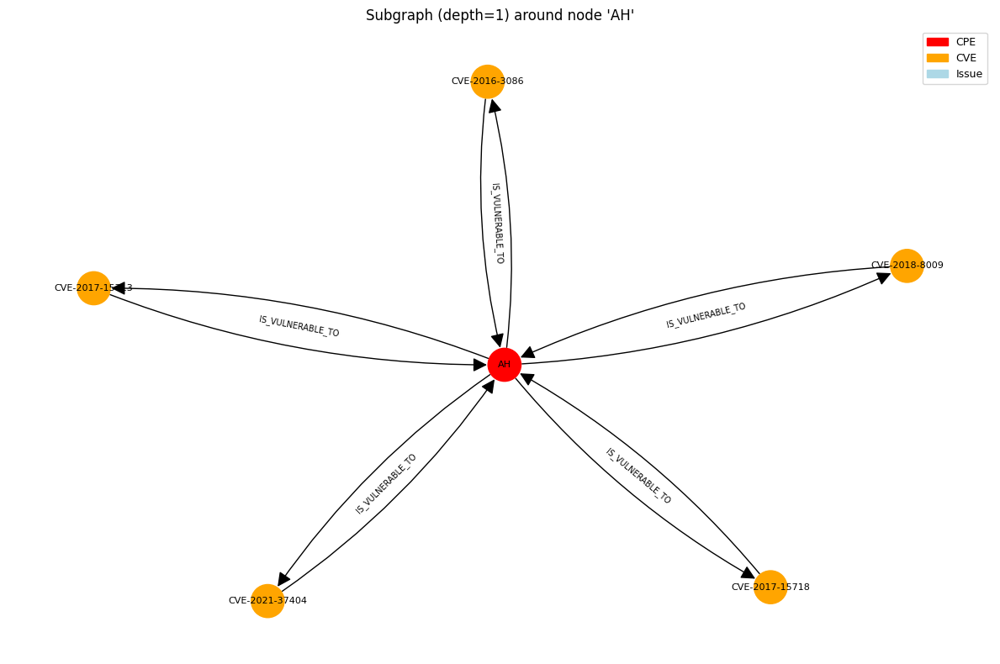

In [98]:
draw_subgraph_around_node(directed_graph, center_node="AH", depth=1)


### Key Points in This Script

1. **Directed Graph**  
   We use `nx.DiGraph()` instead of an undirected `nx.Graph()`.  

2. **Bidirectional Relationships**  
   - **CPE → CVE** with `relation="IS_VULNERABLE_TO"`.  
   - **CVE → CPE** with `relation="AFFECTS"`.  
   - **CVE → Issue** with `relation="TRACKED_BY"`.  
   - **Issue → CVE** with `relation="REFERENCES"`.  

   This way you can trace from CPE to CVE (which dependencies are vulnerable?), or from CVE back to CPE (which products are affected?), etc.  

3. **Node Attributes**  
   Each **CVE** node stores its list of severities (`severity_list`) and count of occurrences. CPE and Issue nodes have `node_type` for identification.  

4. **Visualization**  
   - `draw_entire_graph(G)`: Draws the entire directed graph.  
   - `draw_subgraph_around_node(G, center_node, depth=2)`: Performs a small BFS up to `depth` from a chosen node (including both successors and predecessors) to keep the picture reasonable.  

5. **Edge Labels**  
   If you want to see the relationship labels on edges, just uncomment the section that draws `edge_labels`.  

**That’s it!** This example provides a **directed** representation with **all directions** of relationships between CPEs, CVEs, and Issues. Adjust as needed—if you find the graph too large or some edges redundant, you can remove or simplify directions.

In [41]:
%pip install pygraphviz

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pygraphviz: filename=pygraphviz-1.14-cp311-cp311-macosx_10_9_universal2.whl size=114978 sha256=b87e578d2c2975b82c26f693b632ead1f23038eb4e9684b742b31de8954a2d9c
  Stored in directory: /Users/foundjem/Library/Caches/pip/wheels/9c/5f/df/6fffd2a4353f26dbb0e3672a1baf070c124a1d74a5f9318279
Successfully built pygraphviz
Note: you may need to restart the kernel to use updated packages.


In [67]:
import matplotlib.pyplot as plt
import networkx as nx

# If using pygraphviz:
import pygraphviz
from networkx.drawing.nx_agraph import graphviz_layout
# OR if using pydot:
# import pydot
# from networkx.drawing.nx_pydot import graphviz_layout

def draw_graph_with_dot_layout(G):
    """
    Draws a directed NetworkX graph using the Graphviz 'dot' layout,
    which arranges nodes in hierarchical layers (top -> bottom).
    This makes arrow directions more visually obvious.
    """
    # 'dot' produces a hierarchical layout with nodes in layers
    # 'twopi' produces a radial layout, 'circo' and 'neato' are other possibilities
    pos = graphviz_layout(G, prog='dot')

    plt.figure(figsize=(16, 10))

    # Color‐code nodes by their 'node_type' attribute (CPE, CVE, Issue)
    node_colors = []
    for node, data in G.nodes(data=True):
        if data["node_type"] == "CPE":
            node_colors.append("red")
        elif data["node_type"] == "CVE":
            node_colors.append("orange")
        elif data["node_type"] == "Issue":
            node_colors.append("lightblue")
        else:
            node_colors.append("gray")

    # Draw nodes and labels
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=800)
    nx.draw_networkx_labels(G, pos, font_size=8)

    # Draw edges with distinct arrow style, size, and alpha for better visibility
    nx.draw_networkx_edges(
        G, pos,
        arrows=True,
        arrowstyle='-|>',
        arrowsize=15,
        connectionstyle='arc3,rad=0.1',
        edge_color='black',
        alpha=0.8
    )

    # Optionally show the 'relation' labels on edges
    edge_labels = nx.get_edge_attributes(G, 'relation')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=7)

    plt.title("Directed Graph (Graphviz 'dot' layout)", fontsize=14)
    plt.axis("off")
    plt.tight_layout()
    plt.show()


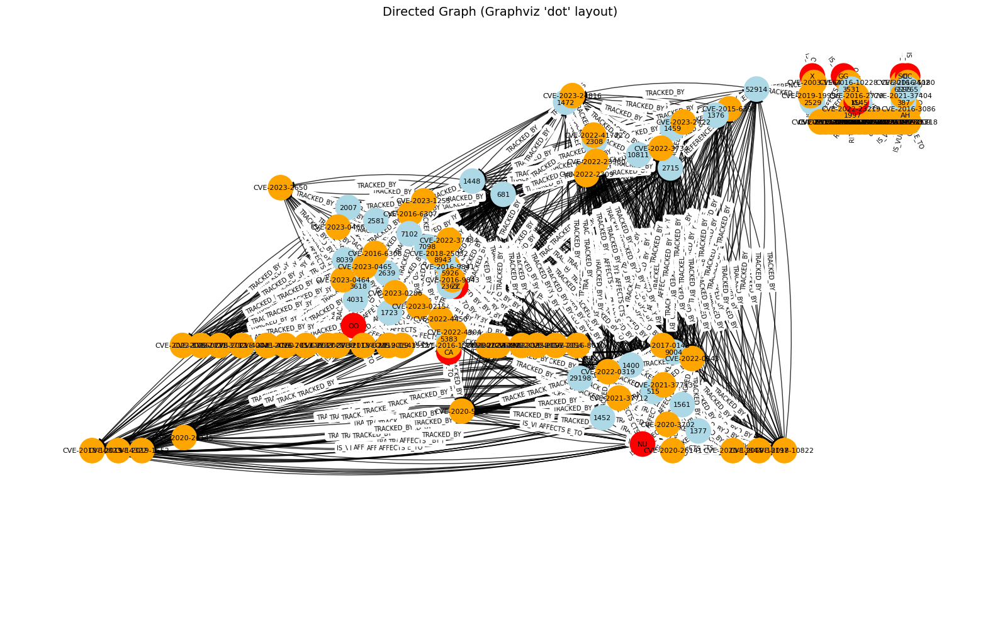

In [68]:
directed_graph = build_directed_graph_from_csv("graphs.csv")
draw_graph_with_dot_layout(directed_graph)


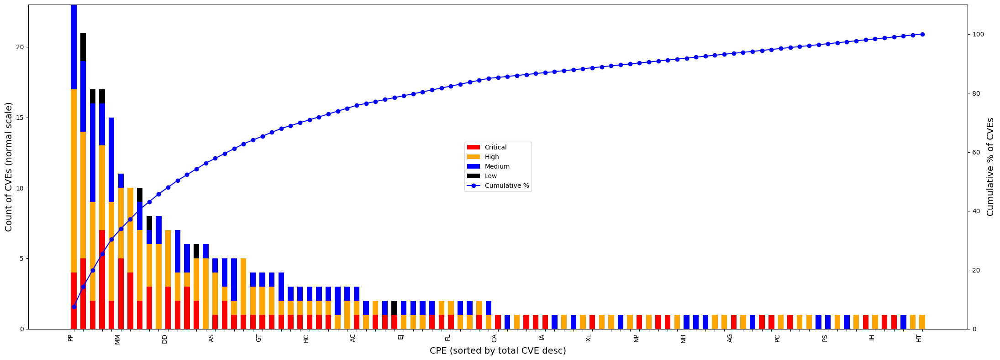

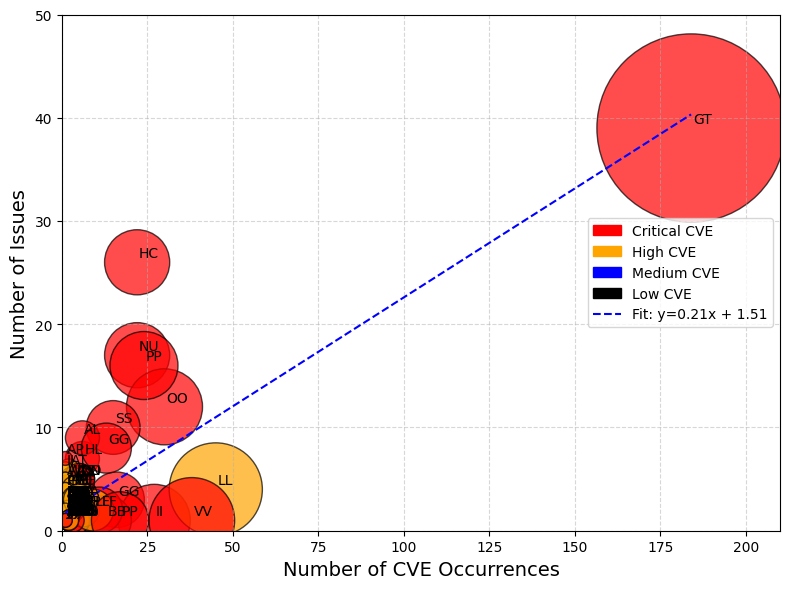

In [21]:

import csv
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
import networkx as nx

###############################################################################
# 1) Parse CSV: issues2cve.csv
###############################################################################

def parse_issues2cve(csv_file):
    """
    Reads the CSV file 'issues2cve.csv' and returns a list of dictionaries, each with:
      {
        "CPE": <string>,
        "cve_ids": [ ... list of CVE IDs ... ],
        "severities": [ ... severities (critical, high, ...) ... ],
        "num_cves": int,  (from "Number of CVE ID occurrences")
        "num_issues": int,
        "issues": [ ... list of issue IDs ... ],
      }
    """

    data_rows = []
    with open(csv_file, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)

        for row in reader:
            cpe_name = row["CPE dependency name"].strip()

            # CVE IDs might be comma‐separated, e.g. "CVE-2003-1564, CVE-2019-19956"
            cve_ids_str = row["CVE ID"].strip()
            cve_list = [c.strip() for c in cve_ids_str.split(",") if c.strip()]

            # "Number of CVE ID occurrences" is an integer
            num_cves = int(row["Number of CVE ID occurrences"])

            # Severities might be comma‐separated, e.g. "critical, high"
            severities_str = row["CVE severity"].strip().lower()
            sev_list = [s.strip() for s in severities_str.split(",") if s.strip()]

            # "Number of Issues" is an integer
            num_issues = int(row["Number of Issues"])

            # "Issues" might be comma‐separated integers or strings
            issues_str = row["Issues"].strip()
            issues_list = [i.strip() for i in issues_str.split(",") if i.strip()]

            # Convert issues to integers if you want
            # but they might be large, so do a safe cast if possible
            try:
                issues_list = [int(i) for i in issues_list]
            except ValueError:
                # if not all are integers, keep them as strings
                pass

            data_rows.append({
                "CPE": cpe_name,
                "cve_ids": cve_list,
                "severities": sev_list,
                "num_cves": num_cves,
                "num_issues": num_issues,
                "issues": issues_list
            })

    return data_rows


###############################################################################
# 2) Visualization: Stacked Bar Chart
###############################################################################

def count_severity_by_cpe(data_rows):
    """
    Returns a dict: { cpe_name: {"critical": x, "high": y, "medium": z, "low": w} }
    Summing how many CVEs appear in each severity category.
    Also returns the list of severity_levels in a desired order.
    """
    severity_levels = ["critical", "high", "medium", "low"]
    cpe_severity_counts = {}

    for row in data_rows:
        cpe = row["CPE"]
        # Ensure we have a dict with all severities=0 for this CPE
        if cpe not in cpe_severity_counts:
            cpe_severity_counts[cpe] = dict.fromkeys(severity_levels, 0)

        for sev in row["severities"]:
            # increment for known severity
            if sev in cpe_severity_counts[cpe]:
                cpe_severity_counts[cpe][sev] += 1

    return cpe_severity_counts, severity_levels


def stacked_bar_pareto(data_rows):
    """
    1) Count severity by CPE.
    2) Sort CPEs descending by total CVE count.
    3) Draw a stacked bar chart in normal scale (not log).
    4) Add a Pareto line showing cumulative % of total CVEs.
    """

    # 1) Compute severity counts: { cpe_name: {"critical": x, "high": y, "medium": z, "low": w} }
    #    Also get a list of severity_levels in the desired order
    cpe_severity_counts, severity_levels = count_severity_by_cpe(data_rows)

    # 2) For each CPE, sum total CVEs
    total_cves_per_cpe = {}
    for cpe, sev_counts in cpe_severity_counts.items():
        total_count = sum(sev_counts[sev] for sev in severity_levels)
        total_cves_per_cpe[cpe] = total_count

    # 3) Sort CPEs by total CVE count (descending)
    #    We'll build a sorted list of (cpe_name, total_count)
    sorted_cpes = sorted(total_cves_per_cpe.items(), key=lambda x: x[1], reverse=True)
    cpe_names_sorted = [item[0] for item in sorted_cpes]

    # 4) Gather arrays for stacked bars in this sorted order
    #    We'll build e.g. arrays critical_vals, high_vals, etc.
    #    in that sorted order
    stacked_data = {sev: [] for sev in severity_levels}
    all_total_counts = []  # to store the total for each cpe in sorted order
    for cpe in cpe_names_sorted:
        sev_counts = cpe_severity_counts[cpe]
        # fill arrays
        for sev in severity_levels:
            stacked_data[sev].append(sev_counts[sev])
        all_total_counts.append(total_cves_per_cpe[cpe])

    # Convert to numpy
    critical_vals = np.array(stacked_data["critical"])
    high_vals     = np.array(stacked_data["high"])
    medium_vals   = np.array(stacked_data["medium"])
    low_vals      = np.array(stacked_data["low"])

    x = np.arange(len(cpe_names_sorted))
    bar_width = 0.6

    # 5) Prepare figure with a secondary y‐axis
    fig, ax1 = plt.subplots(figsize=(22, 8))
    ax2 = ax1.twinx()  # second y‐axis

    # 6) Stacked bar (on ax1)
    b0 = ax1.bar(x, critical_vals, bar_width, label="Critical", color="red")
    b1 = ax1.bar(x, high_vals, bar_width, bottom=critical_vals, label="High", color="orange")
    b2 = ax1.bar(x, medium_vals, bar_width,
                 bottom=critical_vals+high_vals,
                 label="Medium", color="blue")
    b3 = ax1.bar(x, low_vals, bar_width,
                 bottom=critical_vals+high_vals+medium_vals,
                 label="Low", color="black")

    ax1.set_xlabel("CPE (sorted by total CVE desc)", fontsize=14)
    ax1.set_ylabel("Count of CVEs (normal scale)", fontsize=14)
    #ax1.set_title("Stacked Bar + Pareto of CVEs by CPE")

    # Build a custom list of labels, e.g. every 5th CPE
    custom_labels = []
    for i, cpe in enumerate(cpe_names_sorted):
        if i % 5 == 0:   # only label every 5th
            custom_labels.append(cpe)
        else:
            custom_labels.append("")

    ax1.set_xticks(x)
    ax1.set_xticklabels(custom_labels, rotation=90, ha="right")

    # 7) Pareto line: cumulative sum of 'all_total_counts'
    cve_array = np.array(all_total_counts)
    cumulative = np.cumsum(cve_array)
    grand_total = cumulative[-1] if len(cumulative) > 0 else 1.0
    # We'll convert to percent
    cum_percent = cumulative / grand_total * 100

    # Now plot on ax2
    ax2.plot(x, cum_percent, color="blue", marker="o", label="Cumulative %")
    ax2.set_ylabel("Cumulative % of CVEs", fontsize=14)
    ax2.set_ylim([0, 110])  # typically 0-100, maybe some margin

    # 8) Combine legends from ax1 and ax2
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines1 + lines2, labels1 + labels2, loc="center")

    plt.tight_layout()
    plt.show()

###############################################################################
# 3) Visualization: Bubble Chart (num_cves vs. num_issues), color-coded by worst severity
###############################################################################

def worst_severity(severities):
    """
    Return the single "worst" severity from the list.
    Rank: critical > high > medium > low. If none found, return 'none'
    """
    rank = {"critical": 4, "high": 3, "medium": 2, "low": 1}
    best = 'none'
    best_val = 0
    for s in severities:
        val = rank.get(s, 0)
        if val > best_val:
            best_val = val
            best = s
    return best

def color_for_severity(sev):
    if sev == "critical":
        return "red"
    elif sev == "high":
        return "orange"
    elif sev == "medium":
        return "gold"
    elif sev == "low":
        return "gray"
    else:
        return "lavender"

# def bubble_chart(data_rows):
#     """
#     x-axis = num_cves,
#     y-axis = num_issues,
#     bubble color = worst severity,
#     label = CPE name
#     """
#     x_vals = []
#     y_vals = []
#     colors = []
#     cpe_labels = []
#     sizes = []

#     for row in data_rows:
#         cpe = row["CPE"]
#         wc = worst_severity(row["severities"])

#         x_vals.append(row["num_cves"])
#         y_vals.append(row["num_issues"])
#         colors.append(color_for_severity(wc))
#         cpe_labels.append(cpe)

#         # Example: bubble size ~ number of CVEs
#         # multiply by factor for visibility
#         sizes.append(row["num_cves"] * 100)

#     plt.figure(figsize=(16, 12))
#     scatter = plt.scatter(x_vals, y_vals, s=sizes, c=colors, alpha=0.7, edgecolors="black")

#     for i, cpe_name in enumerate(cpe_labels):
#         plt.text(x_vals[i]+0.1, y_vals[i]+0.1, cpe_name, fontsize=8)


#     # Set x-axis and y-axis limits
#     plt.xlim(0, 200)
#     plt.ylim(0, 45)  
#     plt.xlabel("Number of CVE Occurrences")
#     plt.ylabel("Number of Issues")
#     #plt.title("Bubble Chart: #Issues vs. #CVEs (color=worst severity)")
#     plt.grid(alpha=0.3, linestyle="--")
#     plt.tight_layout()
#     plt.show()

# def bubble_chart_with_regression(data_rows):
#     x_vals = []
#     y_vals = []
#     colors = []
#     cpe_labels = []
#     sizes = []

#     for row in data_rows:
#         cpe = row["CPE"]
#         x_vals.append(row["num_cves"])    # X-axis: number of CVEs
#         y_vals.append(row["num_issues"])  # Y-axis: number of Issues
#         wc = worst_severity(row["severities"])
#         colors.append(color_for_severity(wc))
#         cpe_labels.append(cpe)
#         sizes.append(row["num_cves"] * 200)

#     # Convert to NumPy arrays for convenience in polyfit
#     x_array = np.array(x_vals, dtype=float)
#     y_array = np.array(y_vals, dtype=float)

#     plt.figure(figsize=(9, 6))

#     # Plot the scatter (bubble) chart
#     scatter = plt.scatter(x_array, y_array, s=sizes, c=colors, alpha=0.7, edgecolors="black")

#     # Fit a linear regression line y = m*x + b
#     # polyfit returns [m, b] for a first-degree polynomial
#     if len(x_array) >= 2:
#         m, b = np.polyfit(x_array, y_array, 1)

#         # We'll plot the line from min to max x
#         x_line = np.linspace(x_array.min(), x_array.max(), 100)
#         y_line = m * x_line + b

#         plt.plot(x_line, y_line, color="black", linestyle="--", label=f"Fit: y={m:.2f}x+{b:.2f}")

#     # Optional: Set axis limits if desired
#     # plt.xlim(0, 200)
#     # plt.ylim(0, 60)

#     # Label each bubble with the CPE
#     for i, cpe_name in enumerate(cpe_labels):
#         plt.text(x_array[i] + 0.5, y_array[i] + 0.5, cpe_name, fontsize=8)

#     plt.xlabel("Number of CVE Occurrences")
#     plt.ylabel("Number of Issues")
#     #plt.title("Bubble Chart with Linear Regression Line")

#     plt.grid(True, linestyle="--", alpha=0.5)
#     plt.legend(loc="best")
#     plt.tight_layout()
#     plt.show()
def bubble_chart_with_regression(data_rows):
    """
    data: a list of dicts, each like:
      {
        "CPE": "...",
        "num_cves": int,
        "num_issues": int,
        "severities": ["critical","high"]  # etc
      }
    """

    x_vals = []
    y_vals = []
    colors = []
    cpe_labels = []
    sizes = []

    # Build scatter data
    for row in data_rows:
        cpe = row["CPE"]
        x_vals.append(row["num_cves"])
        y_vals.append(row["num_issues"])
        wc = worst_severity(row["severities"])
        col = color_for_severity(wc)
        colors.append(col)
        cpe_labels.append(cpe)
        sizes.append(row["num_cves"] * 100)  # scale bubble size

    x_array = np.array(x_vals, dtype=float)
    y_array = np.array(y_vals, dtype=float)

    plt.figure(figsize=(8, 6))

    # Scatter plot (bubbles). We give it a label for the legend
    sc = plt.scatter(x_array, y_array,
                     s=sizes,
                     c=colors,
                     alpha=0.7,
                     edgecolors="black",
                     #label="Data Points")
                     label="_nolegend_" )  # <--- The scatter won't appear in the legend

    # Fit a linear regression line if we have enough data points
    if len(x_array) >= 2:
        m, b = np.polyfit(x_array, y_array, 1)
        x_line = np.linspace(x_array.min(), x_array.max(), 100)
        y_line = m * x_line + b
        # Plot line with a label (for the legend)
        line, = plt.plot(x_line, y_line, color="blue", linestyle="--",
                         label=f"Fit: y={m:.2f}x + {b:.2f}")

    # Axis labels
    plt.xlabel("Number of CVE Occurrences", fontsize=14)
    plt.ylabel("Number of Issues", fontsize=14)
    #plt.title("Bubble Chart with Regression Line + Legend")

    # Optionally set axis limits
    plt.xlim(0, 210)
    plt.ylim(0, 50)

    # Label each bubble with the CPE name
    for i, cpe_name in enumerate(cpe_labels):
        plt.text(x_array[i] + 0.5, y_array[i] + 0.5, cpe_name, fontsize=10)

    plt.grid(True, linestyle="--", alpha=0.5)

    # Create legend patches for severity colors
    crit_patch = mpatches.Patch(color='red',       label="Critical CVE")
    high_patch = mpatches.Patch(color='orange',    label="High CVE")
    med_patch  = mpatches.Patch(color='blue',    label="Medium CVE")
    low_patch  = mpatches.Patch(color='black', label="Low CVE")

    # Build a combined legend
    # We'll grab handles/labels from the scatter/line,
    # then add the severity patches for final legend.
    handles, labels = plt.gca().get_legend_handles_labels()

    # Insert severity patches at the front or after
    severity_handles = [crit_patch, high_patch, med_patch, low_patch]
    final_handles = severity_handles + handles
    plt.legend(handles=final_handles, loc="center right", fontsize=10)


    plt.tight_layout()
    plt.show()
###############################################################################
# 4) Visualization: Network Graph (CPE → CVE → Issue), color-coded by severity
###############################################################################

def build_cpe_cve_issue_graph(data_rows):
    """
    Builds a directed graph:
      - Node for each CPE
      - Node for each CVE
      - Node for each Issue
    Edges:
      CPE -> CVE
      CVE -> Issue

    We'll assign node_type in attributes: "CPE", "CVE", "Issue"
    CVE nodes also get "severity" attribute for color.
    """
    G = nx.DiGraph()

    for row in data_rows:
        cpe_name = row["CPE"]
        cpe_node = f"CPE:{cpe_name}"

        # Add the CPE node
        G.add_node(cpe_node, node_type="CPE", label=cpe_name)

        cve_list = row["cve_ids"]
        severity_list = row["severities"]
        issues_list = row["issues"]

        # If there are fewer severities than CVE IDs, we'll just repeat the last known severity
        # or you can adapt as you like
        for i, cve_id in enumerate(cve_list):
            # pick a severity if possible
            sev_index = min(i, len(severity_list) - 1)
            sev = severity_list[sev_index] if severity_list else "none"

            cve_node = f"CVE:{cve_id}"
            G.add_node(cve_node, node_type="CVE", severity=sev, label=cve_id)

            # Link CPE -> CVE
            G.add_edge(cpe_node, cve_node)

            # Link CVE -> Issue
            for issue in issues_list:
                issue_node = f"Issue:{issue}"
                G.add_node(issue_node, node_type="Issue", label=str(issue))
                G.add_edge(cve_node, issue_node)

    return G

def draw_cpe_cve_issue_graph(G):
    plt.figure(figsize=(12, 8))

    pos = nx.spring_layout(G, k=0.5, seed=42)

    # Separate nodes by type
    cpe_nodes   = [n for n, d in G.nodes(data=True) if d["node_type"] == "CPE"]
    cve_nodes   = [n for n, d in G.nodes(data=True) if d["node_type"] == "CVE"]
    issue_nodes = [n for n, d in G.nodes(data=True) if d["node_type"] == "Issue"]

    # CPE nodes: red squares
    nx.draw_networkx_nodes(
        G, pos,
        nodelist=cpe_nodes,
        node_color="red",
        node_shape="s",
        label="CPE",
        node_size=600
    )

    # CVE nodes: color depends on severity
    cve_colors = []
    for node in cve_nodes:
        sev = G.nodes[node].get("severity", "none")
        cve_colors.append(color_for_severity(sev))

    nx.draw_networkx_nodes(
        G, pos,
        nodelist=cve_nodes,
        node_color=cve_colors,
        node_shape="o",
        label="CVE",
        node_size=500
    )

    # Issue nodes: lightblue triangles
    nx.draw_networkx_nodes(
        G, pos,
        nodelist=issue_nodes,
        node_color="lightblue",
        node_shape="^",
        label="Issue",
        node_size=450
    )

    # Edges (directed)
    nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle="-|>", arrowsize=10)

    # Labels: node 'label' attribute
    label_dict = {n: d["label"] for n, d in G.nodes(data=True)}
    nx.draw_networkx_labels(G, pos, labels=label_dict, font_size=7)

    plt.title("Network Graph: CPE → CVE → Issue (Color = CVE Severity)")
    plt.axis("off")
    plt.tight_layout()
    plt.show()


###############################################################################
# Main: run the above code
###############################################################################

def main():
    # Path to your CSV
    csv_file = "./github-data/issues2cve.csv"

    # Read & parse
    data_rows = parse_issues2cve(csv_file)

    # 1) Stacked Bar Chart
    stacked_bar_pareto(data_rows)

    # 2) Bubble Chart
    bubble_chart_with_regression(data_rows)

    # # 3) Network Diagram
    # G = build_cpe_cve_issue_graph(data_rows)
    # draw_cpe_cve_issue_graph(G)


if __name__ == "__main__":
    main()


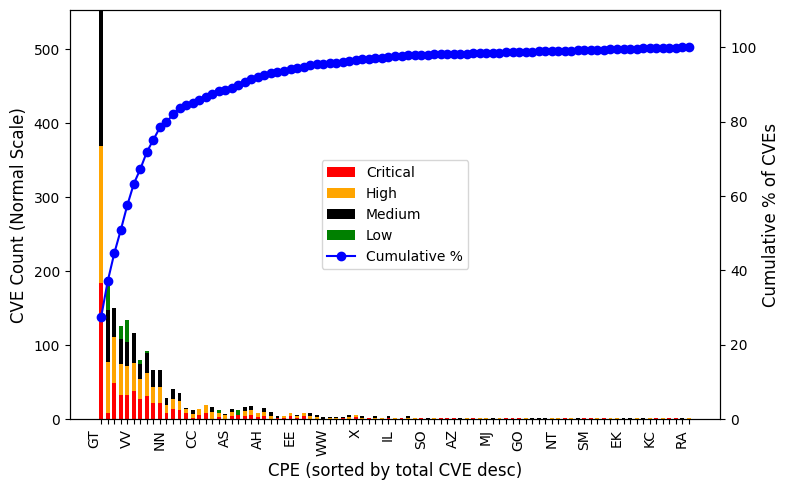

In [36]:
#!/usr/bin/env python3

import csv
import matplotlib.pyplot as plt
import numpy as np

def parse_severities(sev_str):
    """
    Given a severity string like 'critical, high, medium',
    return a list of stripped severities: ['critical','high','medium'].
    """
    return [s.strip().lower() for s in sev_str.split(",") if s.strip()]

def aggregate_cpe_data(csv_file):
    """
    Reads the CSV and returns:
       cpe_data = {
         cpe_name: {
           'critical': <count>,
           'high': <count>,
           'medium': <count>,
           'low': <count>,
           'total': <sum of cve occurrences> 
         },
         ...
       }
    Where we sum up all rows for each CPE, so it includes partial rows with multiple severities.
    """
    # Initialize structure for each CPE
    cpe_data = {}

    # We define recognized severities in a certain order
    recognized_sev = ["critical","high","medium","low"]

    with open(csv_file, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        for row in reader:
            cpe = row["CPE dependency name"].strip()
            num_cve_str = row["Number of CVE ID occurrences"].strip()
            # Convert occurrences to int
            num_cves = int(num_cve_str)

            # Parse severities in this row
            sev_str = row["CVE severity"].strip().lower()
            severity_list = parse_severities(sev_str)

            # Initialize cpe_data if not present
            if cpe not in cpe_data:
                cpe_data[cpe] = {
                    "critical": 0,
                    "high": 0,
                    "medium": 0,
                    "low": 0,
                    "total": 0
                }

            # Add to 'total' for this row
            cpe_data[cpe]["total"] += num_cves

            # For each severity in this row, add num_cves 
            # (since multiple severities can appear in one row if they affect all CVEs)
            for sev in severity_list:
                if sev in cpe_data[cpe]:
                    cpe_data[cpe][sev] += num_cves

    return cpe_data

def pareto_stacked_bar(cpe_data):
    """
    Builds a stacked bar + Pareto line from the aggregated cpe_data.
    cpe_data is a dict: { cpe: {"critical":x, "high":y, "medium":z, "low":w, "total": T}, ... }
    """
    # Convert to a list of (cpe_name, data_dict) for sorting by 'total'
    items = list(cpe_data.items())
    # Sort descending by 'total'
    items.sort(key=lambda x: x[1]["total"], reverse=True)

    # Extract sorted cpe names
    cpe_names = [it[0] for it in items]
    # Build arrays for each severity
    critical_vals = np.array([it[1]["critical"] for it in items])
    high_vals     = np.array([it[1]["high"]     for it in items])
    medium_vals   = np.array([it[1]["medium"]   for it in items])
    low_vals      = np.array([it[1]["low"]      for it in items])

    # We'll do a stacked bar for these four severities
    x = np.arange(len(cpe_names))
    bar_width = 0.6

    # Figure
    fig, ax1 = plt.subplots(figsize=(8, 5))
    ax2 = ax1.twinx()  # for cumulative line

    # Stacked bars
    b0 = ax1.bar(x, critical_vals, bar_width, color="red", label="Critical")
    b1 = ax1.bar(x, high_vals, bar_width, bottom=critical_vals, color="orange", label="High")
    b2 = ax1.bar(x, medium_vals, bar_width, bottom=critical_vals + high_vals,
                 color="black", label="Medium")
    b3 = ax1.bar(x, low_vals, bar_width, bottom=critical_vals + high_vals + medium_vals,
                 color="green", label="Low")

    ##ax1.set_ylim([0, 810])
    ax1.set_xlabel("CPE (sorted by total CVE desc)", fontsize=12)
    ax1.set_ylabel("CVE Count (Normal Scale)", fontsize=12)
    #ax1.set_title("Pareto Stacked Bar: CPE vs. CVE Severity", fontsize=14)


   # Build a custom list of labels, e.g. every 5th CPE
    custom_labels = []
    for i, cpe in enumerate(cpe_names):
        if i % 5 == 0:   # only label every 5th
            custom_labels.append(cpe)
        else:
            custom_labels.append("")

    ax1.set_xticks(x)
    ax1.set_xticklabels(custom_labels, rotation=90, ha="right", fontsize=10)


    # # X ticks
    # ax1.set_xticks(x)
    # # Possibly rotate or sparse the labels if too many:
    # ax1.set_xticklabels(cpe_names, rotation=90, ha="right", fontsize=10)

    # Build Pareto line data
    total_counts = critical_vals + high_vals + medium_vals + low_vals
    cumsum = np.cumsum(total_counts)
    grand_total = cumsum[-1] if len(cumsum) > 0 else 1
    cum_percent = cumsum / grand_total * 100

    # Plot line on ax2
    ax2.plot(x, cum_percent, color="blue", marker="o", label="Cumulative %")
    ax2.set_ylabel("Cumulative % of CVEs", fontsize=12)
    ax2.set_ylim([0, 110])

    # 1) **Enable log scale on the y-axis**
    #ax1.set_yscale("log")
    
    # Combine legends
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines1 + lines2, labels1 + labels2, loc="center", fontsize=10)

    plt.tight_layout()
    plt.show()

def main():
    csv_path = "./github-data/issues2cve.csv"  # your CSV file name
    # 1) Aggregate data for each CPE
    cpe_data = aggregate_cpe_data(csv_path)

    # 2) Build and show Pareto stacked bar
    pareto_stacked_bar(cpe_data)

if __name__ == "__main__":
    main()


In [17]:
import csv
import numpy as np
def aggregate_cves_by_cpe(csv_file):
    """
    Reads the CSV file with columns:
       - "CPE dependency name"
       - "Number of CVE ID occurrences"
    Returns a dictionary mapping each CPE name to the total sum of CVE occurrences.
    """
    cpe_totals = {}

    with open(csv_file, mode="r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        for row in reader:
            cpe = row["CPE dependency name"].strip()
            num_cve_str = row["Number of CVE ID occurrences"].strip()

            # Convert to integer (assuming valid data)
            num_cves = int(num_cve_str)

            # Accumulate the total for this CPE
            if cpe in cpe_totals:
                cpe_totals[cpe] += num_cves
            else:
                cpe_totals[cpe] = num_cves

    return cpe_totals

# Example usage:
if __name__ == "__main__":
    csv_path = "./github-data/issues2cve.csv"
    cpe_aggregate = aggregate_cves_by_cpe(csv_path)
    # cpe_aggregate is now something like: {"OO": 30, "GT": 184, "NU": 22, ...}
    cpe_sorted = dict(sorted(cpe_aggregate.items(), key=lambda item: item[1], reverse=True))
    for cpe, total in cpe_sorted.items():
        print(cpe, total)
        
print(f'there is a total of {len(cpe_sorted)} CPEs ==> 20% would be {len(cpe_sorted)*0.2} CPEs. The sum of the first {len(cpe_sorted)*0.2} CPEs is {sum(list(cpe_sorted.values())[:int(len(cpe_sorted)*0.2)])} which is {sum(list(cpe_sorted.values())[:int(len(cpe_sorted)*0.2)])/sum(list(cpe_sorted.values()))*100}% of the total CVEs {sum(list(cpe_sorted.values()))}')    


GT 185
LL 71
PP 66
GG 48
OO 41
VV 40
SS 36
II 35
NU 22
HC 22
NN 20
BB 15
FF 14
MM 13
JJ 12
CC 11
DD 11
AA 11
RR 7
TT 7
AS 6
HL 6
FJ 6
AL 6
HH 6
AH 5
EJ 5
UU 5
GC 5
ZZ 4
EE 4
FL 4
DF 4
GA 3
JN 3
WW 3
GP 3
AC 3
MK 3
WL 3
X 2
IC 2
PR 2
AT 2
GW 2
IL 2
VS 2
PU 2
HT 2
CA 1
SO 1
KU 1
GL 1
UO 1
IA 1
AZ 1
PJ 1
XL 1
AW 1
KK 1
MJ 1
DA 1
NP 1
OW 1
YY 1
GO 1
NH 1
FZ 1
FR 1
TF 1
NT 1
AG 1
DC 1
OL 1
AM 1
SM 1
PC 1
MW 1
QQ 1
GS 1
EK 1
PS 1
GH 1
RO 1
ES 1
KC 1
IH 1
AP 1
AR 1
KS 1
RA 1
there is a total of 91 CPEs ==> 20% would be 18.2 CPEs. The sum of the first 18.2 CPEs is 673 which is 80.69544364508393% of the total CVEs 834


In [18]:
#!/usr/bin/env python3

import csv
import numpy as np

def aggregate_cve_and_issues(csv_file):
    """
    Reads 'csv_file' and returns two dictionaries:
      1) cve_totals[cpe]: total sum of CVE occurrences for each CPE
      2) issue_totals[cpe]: total sum of Issues for each CPE
    Assumes columns:
      - 'CPE dependency name'
      - 'Number of CVE ID occurrences'
      - 'Number of Issues'
    """
    cve_totals = {}
    issue_totals = {}

    with open(csv_file, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)
        for row in reader:
            cpe = row["CPE dependency name"].strip()

            # Parse integers
            num_cves = int(row["Number of CVE ID occurrences"].strip())
            num_issues = int(row["Number of Issues"].strip())

            # Accumulate
            if cpe not in cve_totals:
                cve_totals[cpe] = 0
            cve_totals[cpe] += num_cves

            if cpe not in issue_totals:
                issue_totals[cpe] = 0
            issue_totals[cpe] += num_issues

    return cve_totals, issue_totals

def calculate_slope(csv_file):
    """
    1) Aggregate total CVEs (x) and total Issues (y) by CPE.
    2) Build x_array, y_array from these aggregates.
    3) Fit a linear regression => slope, intercept.
    Returns (slope, intercept).
    """
    cve_totals, issue_totals = aggregate_cve_and_issues(csv_file)

    # We'll build arrays from the union of CPE keys.
    cpes = sorted(cve_totals.keys())  # or .items() if you want
    x_vals = []
    y_vals = []

    for cpe in cpes:
        x_vals.append(cve_totals[cpe])
        # if for some reason an entry doesn't exist in issue_totals, we default to 0
        y_vals.append(issue_totals.get(cpe, 0))

    x_array = np.array(x_vals, dtype=float)
    y_array = np.array(y_vals, dtype=float)

    # If there's fewer than 2 points, we can't do a line fit
    if len(x_array) < 2:
        print("Not enough distinct CPEs to calculate slope.")
        return None, None

    # Fit a 1st-degree polynomial => slope & intercept
    slope, intercept = np.polyfit(x_array, y_array, 1)
    return slope, intercept

if __name__ == "__main__":
    csv_path = "./github-data/issues2cve.csv"  # Adjust if needed
    m, b = calculate_slope(csv_path)
    if m is not None:
        print(f"Slope (m) = {m:.3f}, Intercept (b) = {b:.3f}")
        print("Interpretation: On average, each additional CVE is associated "
              f"with {m:.2f} additional Issues.")


Slope (m) = 0.295, Intercept (b) = 3.008
Interpretation: On average, each additional CVE is associated with 0.30 additional Issues.


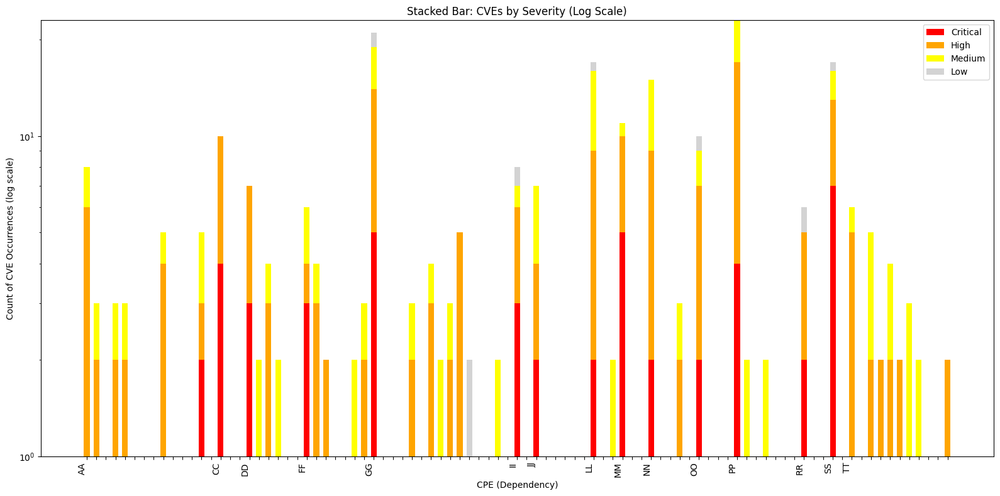

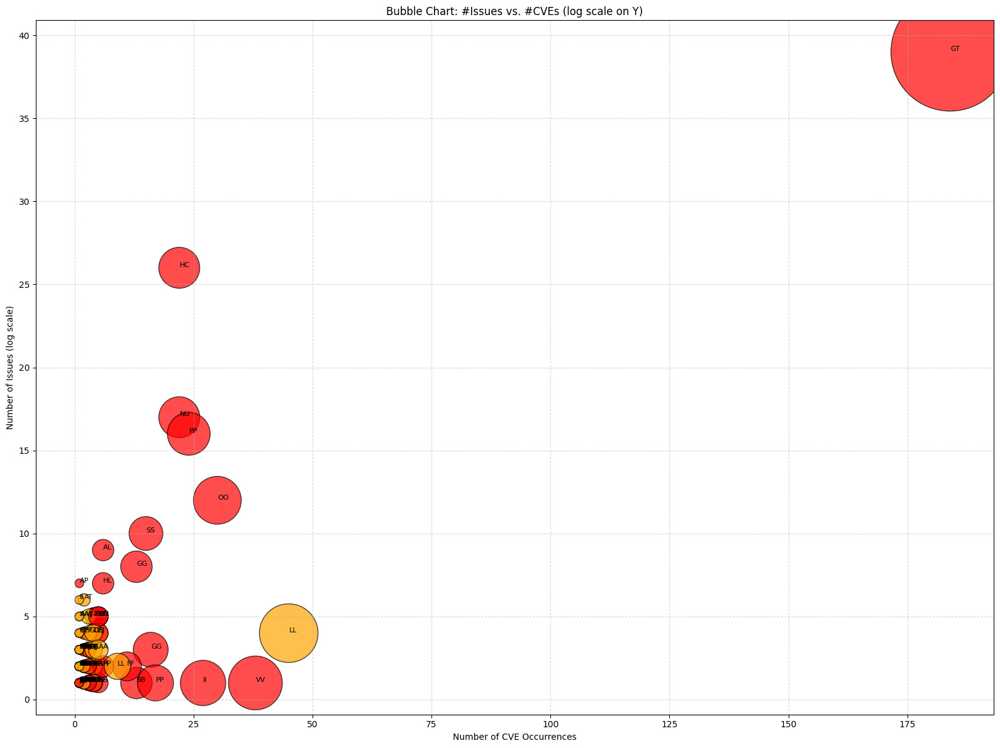

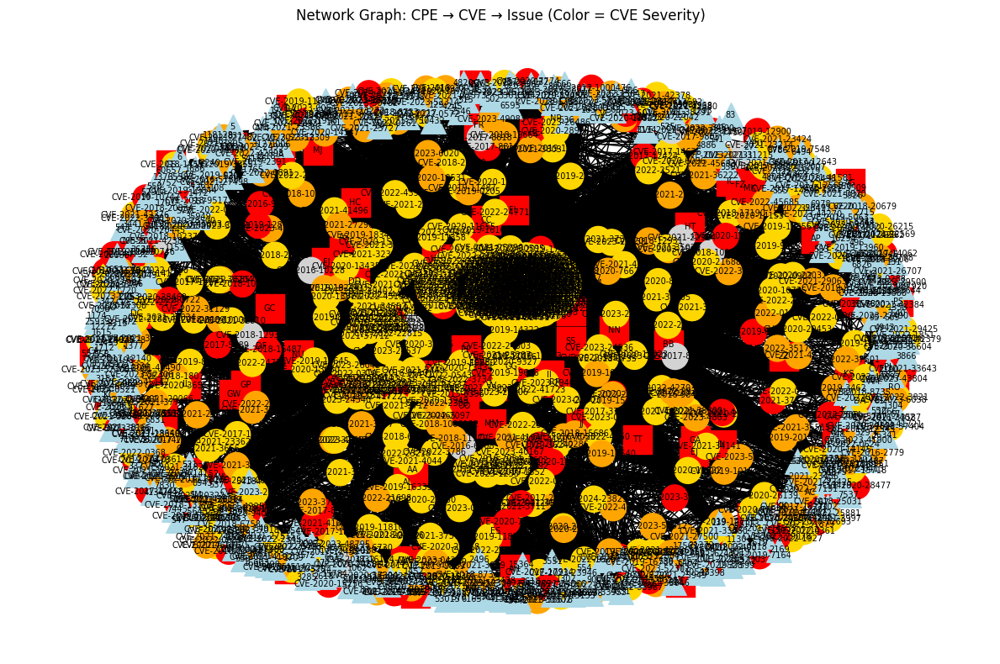

In [26]:

import csv
import matplotlib.pyplot as plt
import numpy as np
import networkx as nx

###############################################################################
# 1) Parse CSV: issues2cve.csv
###############################################################################

def parse_issues2cve(csv_file):
    """
    Reads the CSV file 'issues2cve.csv' and returns a list of dictionaries, each with:
      {
        "CPE": <string>,
        "cve_ids": [ ... list of CVE IDs ... ],
        "severities": [ ... severities (critical, high, ...) ... ],
        "num_cves": int,  (from "Number of CVE ID occurrences")
        "num_issues": int,
        "issues": [ ... list of issue IDs ... ],
      }
    """

    data_rows = []
    with open(csv_file, "r", encoding="utf-8") as f:
        reader = csv.DictReader(f)

        for row in reader:
            cpe_name = row["CPE dependency name"].strip()

            # CVE IDs might be comma‐separated, e.g. "CVE-2003-1564, CVE-2019-19956"
            cve_ids_str = row["CVE ID"].strip()
            cve_list = [c.strip() for c in cve_ids_str.split(",") if c.strip()]

            # "Number of CVE ID occurrences" is an integer
            num_cves = int(row["Number of CVE ID occurrences"])

            # Severities might be comma‐separated, e.g. "critical, high"
            severities_str = row["CVE severity"].strip().lower()
            sev_list = [s.strip() for s in severities_str.split(",") if s.strip()]

            # "Number of Issues" is an integer
            num_issues = int(row["Number of Issues"])

            # "Issues" might be comma‐separated integers or strings
            issues_str = row["Issues"].strip()
            issues_list = [i.strip() for i in issues_str.split(",") if i.strip()]

            # Convert issues to integers if you want
            # but they might be large, so do a safe cast if possible
            try:
                issues_list = [int(i) for i in issues_list]
            except ValueError:
                # if not all are integers, keep them as strings
                pass

            data_rows.append({
                "CPE": cpe_name,
                "cve_ids": cve_list,
                "severities": sev_list,
                "num_cves": num_cves,
                "num_issues": num_issues,
                "issues": issues_list
            })

    return data_rows


###############################################################################
# 2) Visualization: Stacked Bar Chart
###############################################################################

def count_severity_by_cpe(data_rows):
    """
    Returns a dict: { cpe_name: {"critical": x, "high": y, "medium": z, "low": w} }
    Summing how many CVEs appear in each severity category.
    Also returns the list of severity_levels in a desired order.
    """
    severity_levels = ["critical", "high", "medium", "low"]
    cpe_severity_counts = {}

    for row in data_rows:
        cpe = row["CPE"]
        # Ensure we have a dict with all severities=0 for this CPE
        if cpe not in cpe_severity_counts:
            cpe_severity_counts[cpe] = dict.fromkeys(severity_levels, 0)

        for sev in row["severities"]:
            # increment for known severity
            if sev in cpe_severity_counts[cpe]:
                cpe_severity_counts[cpe][sev] += 1

    return cpe_severity_counts, severity_levels


def stacked_bar_chart(data_rows):
    cpe_severity_counts, severity_levels = count_severity_by_cpe(data_rows)

    # Sort CPE names if desired
    cpe_names = sorted(cpe_severity_counts.keys())

    # Gather severity counts in arrays
    stacked_data = {sev: [] for sev in severity_levels}
    total_cve_counts = []  # We'll track total CVEs across all severities for each CPE

    for cpe in cpe_names:
        total_for_cpe = 0
        for sev in severity_levels:
            count = cpe_severity_counts[cpe][sev]
            stacked_data[sev].append(count)
            total_for_cpe += count
        total_cve_counts.append(total_for_cpe)

    critical_vals = np.array(stacked_data["critical"])
    high_vals     = np.array(stacked_data["high"])
    medium_vals   = np.array(stacked_data["medium"])
    low_vals      = np.array(stacked_data["low"])

    x = np.arange(len(cpe_names))
    bar_width = 0.6

    fig, ax = plt.subplots(figsize=(16, 8))

    # Plot bottom stack
    b0 = ax.bar(x, critical_vals, bar_width, label="Critical", color="red")
    b1 = ax.bar(x, high_vals, bar_width, bottom=critical_vals, label="High", color="orange")
    b2 = ax.bar(x, medium_vals, bar_width, bottom=critical_vals + high_vals, 
                label="Medium", color="yellow")
    b3 = ax.bar(x, low_vals, bar_width, bottom=critical_vals + high_vals + medium_vals,
                label="Low", color="lightgray")

    ax.set_xlabel("CPE (Dependency)")
    ax.set_ylabel("Count of CVE Occurrences (log scale)")
    ax.set_title("Stacked Bar: CVEs by Severity (Log Scale)")

    # 1) **Enable log scale on the y-axis**
    ax.set_yscale("log")

    # 2) **Show x‐axis labels only for CPE with total CVE > 5**  
    custom_labels = []
    for i, cpe in enumerate(cpe_names):
        if total_cve_counts[i] > 5:
            custom_labels.append(cpe)  # show the actual name
        else:
            custom_labels.append("")   # blank for total <= 5

    ax.set_xticks(x)
    ax.set_xticklabels(custom_labels, rotation=90, ha="right")

    ax.legend(loc="upper right")
    plt.tight_layout()
    plt.show()



###############################################################################
# 3) Visualization: Bubble Chart (num_cves vs. num_issues), color-coded by worst severity
###############################################################################

def worst_severity(severities):
    """
    Return the single "worst" severity from the list.
    Rank: critical > high > medium > low. If none found, return 'none'
    """
    rank = {"critical": 4, "high": 3, "medium": 2, "low": 1}
    best = 'none'
    best_val = 0
    for s in severities:
        val = rank.get(s, 0)
        if val > best_val:
            best_val = val
            best = s
    return best

def color_for_severity(sev):
    if sev == "critical":
        return "red"
    elif sev == "high":
        return "orange"
    elif sev == "medium":
        return "gold"
    elif sev == "low":
        return "lightgray"
    else:
        return "lavender"

def bubble_chart(data_rows):
    x_vals = []
    y_vals = []
    colors = []
    cpe_labels = []
    sizes = []

    for row in data_rows:
        cpe = row["CPE"]
        x_vals.append(row["num_cves"])
        y_vals.append(row["num_issues"])

        wc = worst_severity(row["severities"])
        colors.append(color_for_severity(wc))

        cpe_labels.append(cpe)
        sizes.append(row["num_cves"] * 100)  # bubble size

    plt.figure(figsize=(16, 12))

    scatter = plt.scatter(
        x_vals, y_vals,
        s=sizes,
        c=colors,
        alpha=0.7,
        edgecolors="black"
    )

    # If you want a **log scale** on the y-axis:
    #plt.yscale("log")

    plt.xlabel("Number of CVE Occurrences")
    plt.ylabel("Number of Issues (log scale)")
    plt.title("Bubble Chart: #Issues vs. #CVEs (log scale on Y)")

    # label each bubble
    for i, cpe_name in enumerate(cpe_labels):
        plt.text(x_vals[i] + 0.05, y_vals[i] + 0.05, cpe_name, fontsize=8)

    plt.grid(True, linestyle="--", alpha=0.5)
    plt.tight_layout()
    plt.show()



###############################################################################
# 4) Visualization: Network Graph (CPE → CVE → Issue), color-coded by severity
###############################################################################

def build_cpe_cve_issue_graph(data_rows):
    """
    Builds a directed graph:
      - Node for each CPE
      - Node for each CVE
      - Node for each Issue
    Edges:
      CPE -> CVE
      CVE -> Issue

    We'll assign node_type in attributes: "CPE", "CVE", "Issue"
    CVE nodes also get "severity" attribute for color.
    """
    G = nx.DiGraph()

    for row in data_rows:
        cpe_name = row["CPE"]
        cpe_node = f"CPE:{cpe_name}"

        # Add the CPE node
        G.add_node(cpe_node, node_type="CPE", label=cpe_name)

        cve_list = row["cve_ids"]
        severity_list = row["severities"]
        issues_list = row["issues"]

        # If there are fewer severities than CVE IDs, we'll just repeat the last known severity
        # or you can adapt as you like
        for i, cve_id in enumerate(cve_list):
            # pick a severity if possible
            sev_index = min(i, len(severity_list) - 1)
            sev = severity_list[sev_index] if severity_list else "none"

            cve_node = f"CVE:{cve_id}"
            G.add_node(cve_node, node_type="CVE", severity=sev, label=cve_id)

            # Link CPE -> CVE
            G.add_edge(cpe_node, cve_node)

            # Link CVE -> Issue
            for issue in issues_list:
                issue_node = f"Issue:{issue}"
                G.add_node(issue_node, node_type="Issue", label=str(issue))
                G.add_edge(cve_node, issue_node)

    return G

def draw_cpe_cve_issue_graph(G):
    plt.figure(figsize=(12, 8))

    pos = nx.spring_layout(G, k=0.5, seed=42)

    # Separate nodes by type
    cpe_nodes   = [n for n, d in G.nodes(data=True) if d["node_type"] == "CPE"]
    cve_nodes   = [n for n, d in G.nodes(data=True) if d["node_type"] == "CVE"]
    issue_nodes = [n for n, d in G.nodes(data=True) if d["node_type"] == "Issue"]

    # CPE nodes: red squares
    nx.draw_networkx_nodes(
        G, pos,
        nodelist=cpe_nodes,
        node_color="red",
        node_shape="s",
        label="CPE",
        node_size=600
    )

    # CVE nodes: color depends on severity
    cve_colors = []
    for node in cve_nodes:
        sev = G.nodes[node].get("severity", "none")
        cve_colors.append(color_for_severity(sev))

    nx.draw_networkx_nodes(
        G, pos,
        nodelist=cve_nodes,
        node_color=cve_colors,
        node_shape="o",
        label="CVE",
        node_size=500
    )

    # Issue nodes: lightblue triangles
    nx.draw_networkx_nodes(
        G, pos,
        nodelist=issue_nodes,
        node_color="lightblue",
        node_shape="^",
        label="Issue",
        node_size=450
    )

    # Edges (directed)
    nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle="-|>", arrowsize=10)

    # Labels: node 'label' attribute
    label_dict = {n: d["label"] for n, d in G.nodes(data=True)}
    nx.draw_networkx_labels(G, pos, labels=label_dict, font_size=7)

    plt.title("Network Graph: CPE → CVE → Issue (Color = CVE Severity)")
    plt.axis("off")
    plt.tight_layout()
    plt.show()


###############################################################################
# Main: run the above code
###############################################################################

def main():
    # Path to your CSV
    csv_file = "./github-data/issues2cve.csv"

    # Read & parse
    data_rows = parse_issues2cve(csv_file)

    # 1) Stacked Bar Chart
    stacked_bar_chart(data_rows)

    # 2) Bubble Chart
    bubble_chart(data_rows)

    # 3) Network Diagram
    G = build_cpe_cve_issue_graph(data_rows)
    draw_cpe_cve_issue_graph(G)


if __name__ == "__main__":
    main()
